# **Phase 1 - Exploratory Data Analysis**


We have been provided with NPRI (National Pollutant Release Inventory) dataset which is a time series data from year 2000 to 2022. The purpose of this project is to:
- perform EDA to better understand the dataset
- identify data issues (missing values, outliers and imbalance in dataset)
- create visualization and statistics
- discovery patterns
- fix data problems (mistakes and bad housekeeping, missing values, outliers, scale mismatches)

**Problem Statement**

**Depending on provincial population trends, predict the amount of ammonia, nitrate ions and phosphorous released to water from wastewater treatment plants in 2023 (data).**



## **Describing dataset including information research**

**Title: Understanding Pollution Trends in Canada: An Analysis of the National Pollutant Release Inventory (NPRI)**


**Executive Summary**

This report examines pollution across Canada using data from the National Pollutant Release Inventory (NPRI). It tracks what industries release into the environment and offers a clear picture of where the most pollution comes from. Over the last 22 years, there have been changes in the levels of pollutants like greenhouse gases (GHGs) and harmful metals. While some improvements have been recorded there are still concerns about the pollutants that are still being emitted into the environment.

**Introduction**

The National Pollutant Release Inventory (NPRI) is Canada’s main system for tracking pollution. It collects information from industries on the types and amounts of pollutants they release. This helps in raising public awareness and allowing the government to hold industries accountable.

**Methodology**

The NPRI data from the past 22 years was used to study pollution across Canada. The process involved:

1. Data Collection:

o Data was pulled on the release of key pollutants, for example, GHGs, volatile organic compounds (VOCs), and metals such as mercury and lead.

2. Data Organization:

o Pollutants were grouped by type and their units were measured, and sorted by their region to spot trends and which are problem areas.

3. Analysis: Key Findings

**Pollutants, Industries, and Geography**

· Pollutant Types: GHGs, VOCs, heavy metals, and particulate matter are some of the main pollutants tracked by the NPRI.

· Industries: The oil and gas industry, manufacturing, mining, and power plants are the biggest contributors to pollution in Canada.

· Geographic Focus: Pollutant releases were captured by province to figure out where pollution is most concentrated.

Exploratory Data Analysis (EDA)

1. Dataset Summary

- The dataset covers pollution from over 100 types of substances.
- It contains data from industrial facilities across all Canadian provinces for the past 22 years.

2. Bad Housekeeping in Dataset
- missing values
- inconsistency (different units of measurement)
- outliers


**Key Findings**

· Alberta has the highest level of observations with the least observed as Yukon.

· Alberta has the highest level of 'release to air(stack point) levels, followed by Newfoundland and Labrador with Yukon Territory recording the least amount.

· Nova Scotia has the highest level of 'release to land(other). Saskatchewan, Northwest Territory, PEI and YT do not have any type of releases to land. Overall, for the provinces that have releases to land(spills) this type od releases are way smaller compared to the releases to land(other). Also all the provinces do not have a remarkable release to land(leaks) value.

· Nova Scotia has the highest level of releases to water bodies through direct discharge. Some provinces do not show any considerable amount of releases to water bodies. Manitoba remarkably has a high level of release to water bodies through spills.

1. We observe some strong correlations in the dataset between the following features: Positive correlations :Release to air spills and release to land spills

2. Release to air spills and release to water bodies spills

3. Release to air spills and sum of release to all media

4. Release to land leaks and sum of release to all media

5. Release to land - other and releases to water bodies - spills

6. Release to land - spills and releases to water bodies - spills

7. Releases to water bodies - spills and releases to water bodies - leaks



Conclusion

The NPRI dataset does a good job of highlighting which industries and regions contribute the most to pollution. This dataset shows where Canada should focus its efforts to improve environmental quality and public health. Continued tracking and stronger regulations will be crucial in managing industrial pollutants and creating a safer, healthier environment for all Canadians.

In [ ]:
import numpy as np
import pandas as pd
import math as mt
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.offline import plot
import sklearn.tree as skTree
import sklearn.metrics as skMetrics
from sklearn.model_selection import train_test_split
import plotly.graph_objects as go
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
ohe = OneHotEncoder()
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from xgboost import XGBRegressor
from sklearn.svm import SVR
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.multioutput import MultiOutputRegressor
from sklearn.metrics import root_mean_squared_error, mean_squared_error, mean_absolute_error, r2_score, make_scorer
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.impute import SimpleImputer
from sklearn.model_selection import KFold, cross_validate
from sklearn.preprocessing import FunctionTransformer


import statsmodels.api as sm




%matplotlib inline

In [ ]:
!pip install category_encoders==2.6.2

In [ ]:
import category_encoders as ce

In [ ]:
pip install xlrd

In [ ]:
# importing dataset
df_NPRI = pd.read_csv('NPRI_2000_2022.csv', encoding ='latin1')

#Setting up notebook so that all columns are displayed
pd.set_option('display.max_columns', None)

# displaying the first 5 columns
df_NPRI.head()

<ipython-input-13-89a82e0b6b30>:2: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



,Reporting_Year / Année,NPRI_ID / No_INRP,Number of employees,Company_Name / Dénomination_sociale_de_l'entreprise,Facility_Name / Installation,NAICS / Code_SCIAN,NAICS Title / Titre Code_SCIAN,PROVINCE,City,Latitude,Longitude,CAS_Number / No_CAS,Substance Name (English) / Nom de substance (Anglais),Units / Unités,Estimation_Method / Méthode_destimation,Release to Air - Fugitive,Release to Air - Other Non-Point,Release to Air - Road dust,Release to Air - Spills,Release to Air - Stack / Point,Release to Air - Storage / Handling,Releases to Land - Leaks,Releases to Land - Other,Releases to Land - Spills,Releases to Water Bodies - Direct Discharges,Releases to Water Bodies - Leaks,Releases to Water Bodies - Spills,Sum of release to all media (<1tonne)
0,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,10049-04-4,Chlorine dioxide,tonnes,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,5.200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,67-56-1,Methanol,tonnes,E - Emission Factor,NaN,NaN,NaN,NaN,113.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,67-66-3,Chloroform,tonnes,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
3,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,75-07-0,Acetaldehyde,tonnes,E - Emission Factor,NaN,NaN,NaN,NaN,7.670,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,7647-01-0,Hydrochloric acid,tonnes,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,0.665,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df_NPRI_comments = pd.read_csv('NPRI_2000_2022_Comments.csv', encoding = 'latin1')

pd.set_option('display.max_columns', None)

df_NPRI_comments.head()

,Reporting_Year / Année,NPRI_ID / No_INRP,Company_Name / Dénomination_sociale_de_l'entreprise,Facility_Name / Installation,NAICS / Code_SCIAN,NAICS Title EN / Titre Code SCIAN EN,NAICS Title FR / Titre Code SCIAN FR,PROVINCE,CAS_Number / No_CAS,Substance Name (English) / Nom de substance (Anglais),Substance Name (French) / Nom de substance (Français),Comment_Type_Name (English) Type_de_commentaire (Anglais),Comment_Type_Name (French) Type_de_commentaire (Français),Comment / Commentaires
0,2022,1,Alberta-Pacific Forest Industries Inc.,Alberta-Pacific Forest Industries Inc.,322112,Chemical pulp mills,Usines de pâte chimique,AB,100-42-5,Styrene,Styrène,On-site releases comment,Commentaire sur les rejets sur le site,In 2022 less wood waste (hog fuel) was combust...
1,2022,1,Alberta-Pacific Forest Industries Inc.,Alberta-Pacific Forest Industries Inc.,322112,Chemical pulp mills,Usines de pâte chimique,AB,108-10-1,Methyl isobutyl ketone,Méthylisobutylcétone,On-site releases comment,Commentaire sur les rejets sur le site,In 2022 less wood waste (hog fuel) was combust...
2,2022,1,Alberta-Pacific Forest Industries Inc.,Alberta-Pacific Forest Industries Inc.,322112,Chemical pulp mills,Usines de pâte chimique,AB,108-95-2,Phenol (and its salts),Phénol (et ses sels),On-site releases comment,Commentaire sur les rejets sur le site,Reduction in (bleached pulp) production rates ...
3,2022,1,Alberta-Pacific Forest Industries Inc.,Alberta-Pacific Forest Industries Inc.,322112,Chemical pulp mills,Usines de pâte chimique,AB,118-74-1,Hexachlorobenzene,Hexachlorobenzène,On-site releases comment,Commentaire sur les rejets sur le site,In 2022 more natural gas was combusted in the ...
4,2022,1,Alberta-Pacific Forest Industries Inc.,Alberta-Pacific Forest Industries Inc.,322112,Chemical pulp mills,Usines de pâte chimique,AB,120-12-7,Anthracene,Anthracène,On-site releases comment,Commentaire sur les rejets sur le site,In 2022 less black liquor was put through the ...


## Exploring the data

In [ ]:
# checking the number of rows and columns
df_NPRI.shape

(737516, 28)

In [ ]:
# retrieving general information about the dataframe
df_NPRI.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 737516 entries, 0 to 737515
Data columns (total 28 columns):
 #   Column                                                 Non-Null Count   Dtype  
---  ------                                                 --------------   -----  
 0   Reporting_Year / Année                                 737516 non-null  int64  
 1   NPRI_ID / No_INRP                                      737516 non-null  int64  
 2   Number of employees                                    736900 non-null  object 
 3   Company_Name / Dénomination_sociale_de_l'entreprise    737516 non-null  object 
 4   Facility_Name / Installation                           736340 non-null  object 
 5   NAICS / Code_SCIAN                                     737516 non-null  int64  
 6   NAICS Title / Titre Code_SCIAN                         737516 non-null  object 
 7   PROVINCE                                               737516 non-null  object 
 8   City                              

In [ ]:
# generating summary statistics of the numerical columns
df_NPRI.describe()

,Reporting_Year / Année,NPRI_ID / No_INRP,NAICS / Code_SCIAN,Latitude,Longitude,Release to Air - Fugitive,Release to Air - Other Non-Point,Release to Air - Road dust,Release to Air - Spills,Release to Air - Stack / Point,Release to Air - Storage / Handling,Releases to Land - Leaks,Releases to Land - Other,Releases to Land - Spills,Releases to Water Bodies - Direct Discharges,Releases to Water Bodies - Leaks,Releases to Water Bodies - Spills,Sum of release to all media (<1tonne)
count,737516.000000,737516.000000,737516.000000,733434.000000,733434.000000,125032.000000,30880.000000,29861.000000,9181.000000,513282.000000,80004.000000,910.000000,5668.000000,4470.000000,53188.000000,742.000000,3080.000000,50185.000000
mean,2012.267601,11248.268386,289175.551820,49.644636,-97.375436,61.156824,91.455034,117.236013,1.742604,144.203321,23.462437,0.356315,515.614162,5.090716,79.052084,0.710053,174.901856,0.141082
std,6.400156,9352.868266,94788.542197,5.155658,20.184399,797.572502,1628.905004,856.012131,22.223163,2014.861249,218.305058,2.586239,3181.280880,93.378082,577.693253,5.332891,5342.398935,2.606306
min,2000.000000,1.000000,111120.000000,0.000000,-140.883600,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2007.000000,3775.000000,211113.000000,45.431000,-114.767700,0.051000,0.013000,0.505400,0.000000,0.429000,0.015000,0.000000,0.001000,0.000000,0.060000,0.000000,0.000000,0.001700
50%,2012.000000,7114.000000,312140.000000,49.795100,-104.630100,0.796000,0.490000,3.561900,0.000300,4.037595,0.358000,0.000000,5.000000,0.002000,2.068000,0.000000,0.087900,0.023700
75%,2018.000000,18093.000000,327120.000000,53.508500,-79.540060,7.582000,7.458500,22.000000,0.040000,37.389000,3.953000,0.000000,47.000000,0.030000,20.578400,0.000000,1.398350,0.150000
max,2022.000000,306556.000000,913910.000000,82.498758,0.000000,58433.900000,91138.200000,39992.961050,1554.400000,235907.000000,17883.110000,39.058000,152270.000000,4500.100000,39991.000000,82.400000,259050.000000,582.000000


In [ ]:
# making a list of the column names. Sometimes there are trailing spaces before or after the column name which may not be visible, but create issues with exploring the data
df_NPRI.columns

Index(['Reporting_Year / Année', 'NPRI_ID / No_INRP', 'Number of employees',
       'Company_Name / Dénomination_sociale_de_l'entreprise',
       'Facility_Name / Installation', 'NAICS / Code_SCIAN',
       'NAICS Title / Titre Code_SCIAN', 'PROVINCE', 'City', 'Latitude',
       'Longitude', 'CAS_Number / No_CAS',
       'Substance Name (English) / Nom de substance (Anglais)',
       'Units / Unités', 'Estimation_Method / Méthode_destimation',
       'Release to Air - Fugitive', 'Release to Air - Other Non-Point ',
       'Release to Air - Road dust  ', 'Release to Air - Spills ',
       'Release to Air - Stack / Point  ',
       'Release to Air - Storage / Handling ', 'Releases to Land - Leaks',
       'Releases to Land - Other ', 'Releases to Land - Spills ',
       'Releases to Water Bodies - Direct Discharges ',
       'Releases to Water Bodies - Leaks',
       'Releases to Water Bodies - Spills ',
       'Sum of release to all media (<1tonne)'],
      dtype='object')

**Note: From the column list above, we observe some of the column names have trailing spaces and apostrophe (') causing issues with calling them in codes. So we will go ahead to address this issue at this point so our codes will run properly. This we achieve by removing trailing spaces and filling spaces in between words with underscore (_).**

In [ ]:
# create new column names by removing trailing spaces and replacing spaces in between words with underscore (_)
new_column_names = ['Reporting_Year/Année', 'NPRI_ID/No_INRP', 'Number_of_Employees',
       "Company_Name/Dénomination_sociale_de_l'entreprise",
       'Facility_Name/Installation', 'NAICS/Code_SCIAN',
       'NAICS Title/Titre_Code_SCIAN', 'PROVINCE', 'City', 'Latitude',
       'Longitude', 'CAS_Number/No_CAS',
       'Substance_Name_(English)/Nom_de_substance_(Anglais)',
       'Units/Unités', 'Estimation_Method/Méthode_d’estimation',
       'Release_to_Air(Fugitive)', 'Release_to_Air(Other_Non-Point)',
       'Release_to_Air(Road dust)', 'Release_to_Air(Spills)',
       'Release_to_Air(Stack/Point)',
       'Release_to_Air(Storage/Handling)', 'Releases_to_Land(Leaks)',
       'Releases_to_Land(Other)', 'Releases_to_Land(Spills)',
       'Releases_ to_Water_Bodies(Direct Discharges)',
       'Releases_ to_Water_Bodies(Leaks)',
       'Releases_ to_Water_Bodies(Spills)', 'Sum_of_release_to_all_media_(<1tonne)']

In [ ]:
# replace the old column names with the new column names
df_NPRI.columns = new_column_names

In [ ]:
# check to see dataframe has the new headers
df_NPRI.columns

Index(['Reporting_Year/Année', 'NPRI_ID/No_INRP', 'Number_of_Employees',
       'Company_Name/Dénomination_sociale_de_l'entreprise',
       'Facility_Name/Installation', 'NAICS/Code_SCIAN',
       'NAICS Title/Titre_Code_SCIAN', 'PROVINCE', 'City', 'Latitude',
       'Longitude', 'CAS_Number/No_CAS',
       'Substance_Name_(English)/Nom_de_substance_(Anglais)', 'Units/Unités',
       'Estimation_Method/Méthode_d’estimation', 'Release_to_Air(Fugitive)',
       'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
       'Release_to_Air(Spills)', 'Release_to_Air(Stack/Point)',
       'Release_to_Air(Storage/Handling)', 'Releases_to_Land(Leaks)',
       'Releases_to_Land(Other)', 'Releases_to_Land(Spills)',
       'Releases_ to_Water_Bodies(Direct Discharges)',
       'Releases_ to_Water_Bodies(Leaks)', 'Releases_ to_Water_Bodies(Spills)',
       'Sum_of_release_to_all_media_(<1tonne)'],
      dtype='object')

In [ ]:
# code to confirm the number of unique entires in each column
df_NPRI.nunique()

,0
Reporting_Year/Année,23
NPRI_ID/No_INRP,21868
Number_of_Employees,2610
Company_Name/Dénomination_sociale_de_l'entreprise,9859
Facility_Name/Installation,32102
NAICS/Code_SCIAN,403
NAICS Title/Titre_Code_SCIAN,424
PROVINCE,13
City,4020
Latitude,19318


## **Visualization**
It aids detecting patterns in the dataset and investigating the distribution of the features.

In [ ]:
# subset of dataframe showing the number of observations across provinces
df_NPRI['PROVINCE'].value_counts()

,count
PROVINCE,
AB,248830
ON,196937
QC,91065
BC,81635
SK,60245
MB,16215
NS,12661
NB,12272
NL,9495


#### 1. Bar Charts

<Axes: xlabel='PROVINCE'>

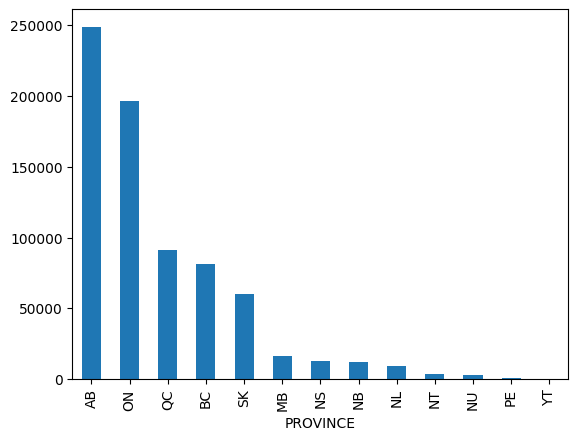

In [ ]:
# bar plot of observations across provinces
df_NPRI['PROVINCE'].value_counts().plot(kind='bar')

**Plotting the release of substances to air across various provinces.**

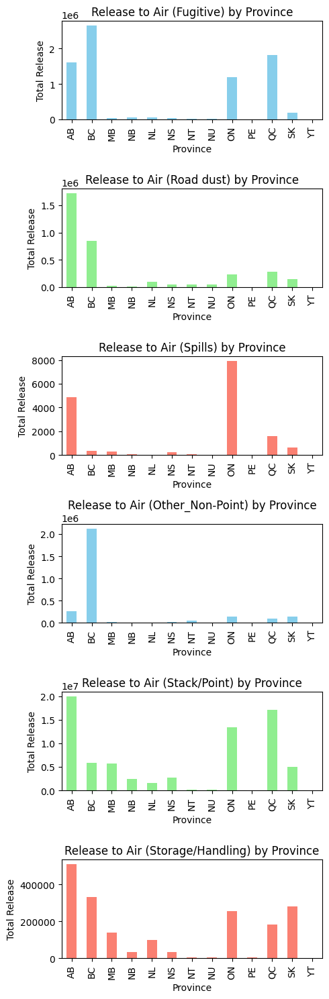

In [ ]:
# Create subplots for the 6 types of releases to air
fig, axs = plt.subplots(6, 1, figsize=(5, 15)) # Changed to 6 rows and 1 column

# Plot 'Release_to_Air(Fugitive)' by province
df_NPRI.groupby('PROVINCE')['Release_to_Air(Fugitive)'].sum().plot(kind='bar', ax=axs[0], color='skyblue')
axs[0].set_title('Release to Air (Fugitive) by Province')
axs[0].set_xlabel('Province')
axs[0].set_ylabel('Total Release')

# Plot 'Release_to_Air(Road dust)' by province
df_NPRI.groupby('PROVINCE')['Release_to_Air(Road dust)'].sum().plot(kind='bar', ax=axs[1], color='lightgreen')
axs[1].set_title('Release to Air (Road dust) by Province')
axs[1].set_xlabel('Province')
axs[1].set_ylabel('Total Release')

# Plot 'Release_to_Air(Spills)' by province
df_NPRI.groupby('PROVINCE')['Release_to_Air(Spills)'].sum().plot(kind='bar', ax=axs[2], color='salmon')
axs[2].set_title('Release to Air (Spills) by Province')
axs[2].set_xlabel('Province')
axs[2].set_ylabel('Total Release')

# Plot 'Release_to_Air(Other_Non-Point)' by province
df_NPRI.groupby('PROVINCE')['Release_to_Air(Other_Non-Point)'].sum().plot(kind='bar', ax=axs[3], color='skyblue') # Changed axs index to 3
axs[3].set_title('Release to Air (Other_Non-Point) by Province') # Changed title and axs index
axs[3].set_xlabel('Province')
axs[3].set_ylabel('Total Release')

# Plot 'Release_to_Air(Stack/Point)' by province
df_NPRI.groupby('PROVINCE')['Release_to_Air(Stack/Point)'].sum().plot(kind='bar', ax=axs[4], color='lightgreen') # Changed axs index to 4
axs[4].set_title('Release to Air (Stack/Point) by Province') # Changed title and axs index
axs[4].set_xlabel('Province')
axs[4].set_ylabel('Total Release')

# Plot 'Release_to_Air(Storage/Handling)' by province
df_NPRI.groupby('PROVINCE')['Release_to_Air(Storage/Handling)'].sum().plot(kind='bar', ax=axs[5], color='salmon') # Changed axs index to 5
axs[5].set_title('Release to Air (Storage/Handling) by Province') # Changed title and axs index
axs[5].set_xlabel('Province')
axs[5].set_ylabel('Total Release')

# Adjust layout for better spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()

**Observation**
- British Columbia has the highest release to air (fugitive), release to air (Other_non-point).
- Alberta has the highest release to air (dust), release to air (storage handling), release to air (stack/point).
- Ontario has the highest release to air (spills).
- Generally, Yukon has the lowest releases to air.

**Plotting the release of substances to land across various provinces.**

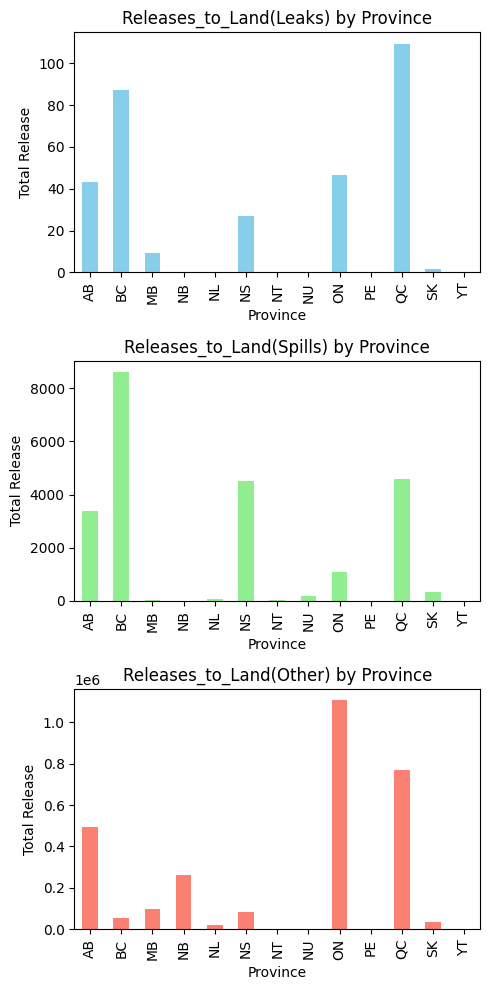

In [ ]:
# Create subplots for the 3 types of releases to land
fig, axs = plt.subplots(3, 1, figsize=(5, 10))

# Plot 'Releases_to_Land(Leaks)' by province
df_NPRI.groupby('PROVINCE')['Releases_to_Land(Leaks)'].sum().plot(kind='bar', ax=axs[0], color='skyblue')
axs[0].set_title('Releases_to_Land(Leaks) by Province')
axs[0].set_xlabel('Province')
axs[0].set_ylabel('Total Release')

# Plot 'Releases_to_Land(Spills)' by province
df_NPRI.groupby('PROVINCE')['Releases_to_Land(Spills)'].sum().plot(kind='bar', ax=axs[1], color='lightgreen')
axs[1].set_title('Releases_to_Land(Spills) by Province')
axs[1].set_xlabel('Province')
axs[1].set_ylabel('Total Release')

# Plot 'Releases_to_Land(Other)' by province
df_NPRI.groupby('PROVINCE')['Releases_to_Land(Other)'].sum().plot(kind='bar', ax=axs[2], color='salmon')
axs[2].set_title('Releases_to_Land(Other) by Province')
axs[2].set_xlabel('Province')
axs[2].set_ylabel('Total Release')

# Adjust layout for better spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()

**Observations**
- Highest release to Land (Leaks) is from Quebec and least is NB, NL, NT, NU. PE and YT.
- Highest release to Land (Spills) is from BC and least is NB, PE, and YT.
- Highest release to Land (Other) is from ON and least is NT, NU, PE and YT

**Plotting the release of substances to water bodies across various provinces.**

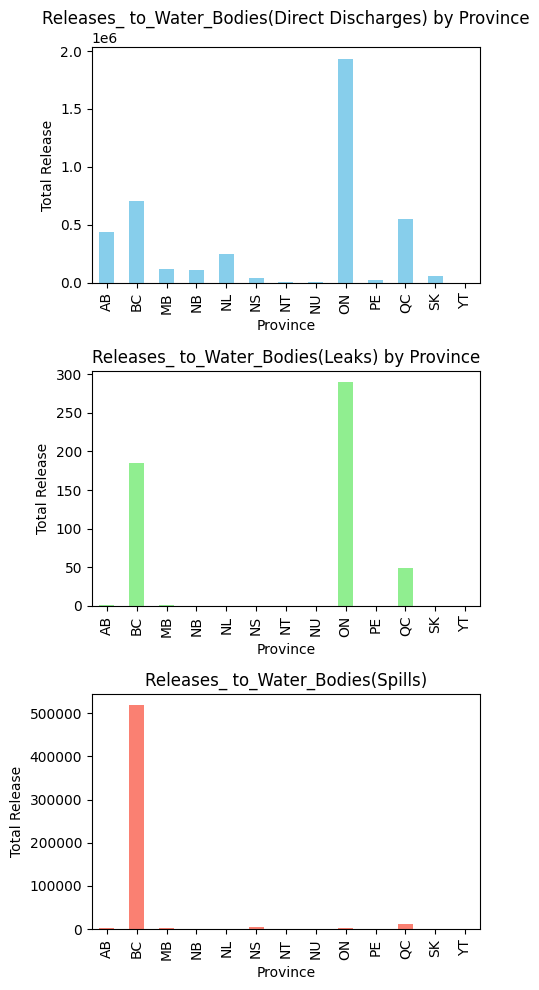

In [ ]:
# Create subplots for the 3 types of releases to water bodies
fig, axs = plt.subplots(3, 1, figsize=(5, 10))

# Plot 'Releases_ to_Water_Bodies(Direct Discharges)' by province
df_NPRI.groupby('PROVINCE')['Releases_ to_Water_Bodies(Direct Discharges)'].sum().plot(kind='bar', ax=axs[0], color='skyblue')
axs[0].set_title('Releases_ to_Water_Bodies(Direct Discharges) by Province')
axs[0].set_xlabel('Province')
axs[0].set_ylabel('Total Release')

# Plot 'Releases_ to_Water_Bodies(Leaks)' by province
df_NPRI.groupby('PROVINCE')['Releases_ to_Water_Bodies(Leaks)'].sum().plot(kind='bar', ax=axs[1], color='lightgreen')
axs[1].set_title('Releases_ to_Water_Bodies(Leaks) by Province')
axs[1].set_xlabel('Province')
axs[1].set_ylabel('Total Release')

# Plot 'Releases_ to_Water_Bodies(Spills)' by province
df_NPRI.groupby('PROVINCE')['Releases_ to_Water_Bodies(Spills)'].sum().plot(kind='bar', ax=axs[2], color='salmon')
axs[2].set_title('Releases_ to_Water_Bodies(Spills)')
axs[2].set_xlabel('Province')
axs[2].set_ylabel('Total Release')

# Adjust layout for better spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()

**Observation**
- Highest release to Water bodies (Direct discharge) is from ON and least is YT.
- Significant release to Water bodies (Leaks) is from BC, ON and QC.
- Significant release to Water bodies (Spills) is from BC.

**Plotting the Sum_of_release_to_all_media_(<1tonne)**

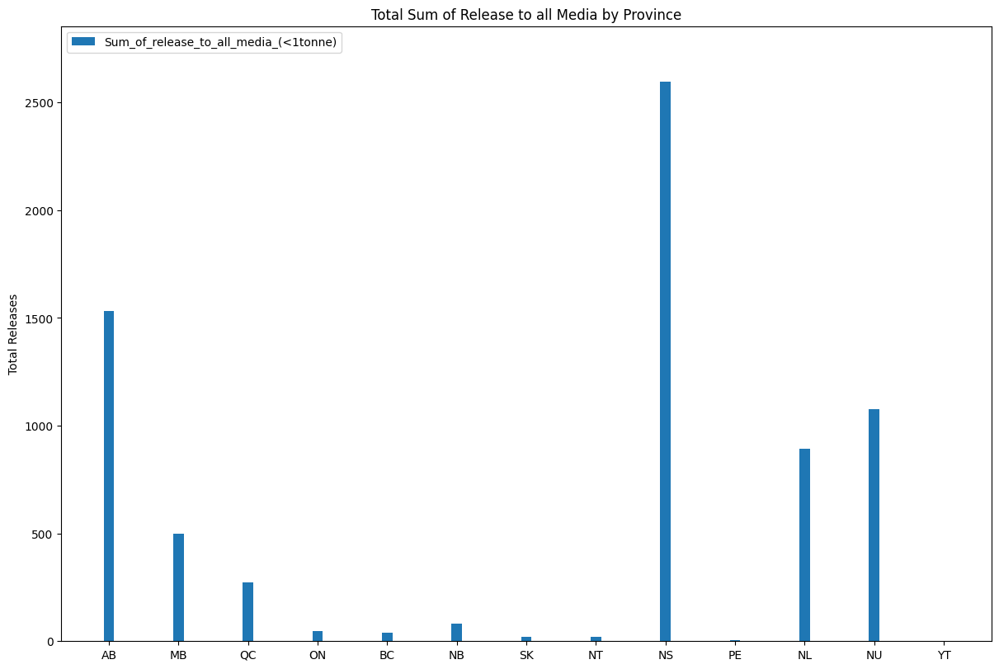

In [ ]:
# Defining provinces and release types
provinces = df_NPRI['PROVINCE'].unique()
release_type = 'Sum_of_release_to_all_media_(<1tonne)'

# Getting the sum of releases for each province
release_sums = df_NPRI.groupby('PROVINCE')[release_type].sum()

x = np.arange(len(provinces))  # the label locations
width = 0.15  # the width of the bars

fig, ax = plt.subplots(layout='constrained', figsize=(12, 8))

# Plotting the bars for the release type
# Removed the loop as it's not needed for a single release type
rects = ax.bar(x, release_sums, width, label=release_type)

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Total Releases')
ax.set_title('Total Sum of Release to all Media by Province')
ax.set_xticks(x, provinces) # Adjusted xticks to match the single bar plot
ax.legend(loc='upper left', ncols=2)
ax.set_ylim(0, release_sums.max() * 1.1)  # Adjust ylim to max value

plt.show()

**Observation**
- NS has the highest release to all media (less than 1 tonne) and YT has the least.

### 2. Correlation Matrix / Heatmap
A correlation matrix is a table that displays the correlation coefficients between multiple variables. Each cell in the table contains a numerical value
 ( between -1 and +1) that represents the correlation between two variables. A value of +1 indicates a perfect positive correlation, -1 indicates a perfect negative correlation and zeror (0) indicates no correlation.

 A heatmap visualizes the correlation coefficients using color intensity makes and makes it easier to quickly identify patterns and relationships.


In [ ]:
# creating correlation matrix
corr_matrix = df_NPRI.corr(numeric_only=True)
corr_matrix

,Reporting_Year/Année,NPRI_ID/No_INRP,NAICS/Code_SCIAN,Latitude,Longitude,Release_to_Air(Fugitive),Release_to_Air(Other_Non-Point),Release_to_Air(Road dust),Release_to_Air(Spills),Release_to_Air(Stack/Point),Release_to_Air(Storage/Handling),Releases_to_Land(Leaks),Releases_to_Land(Other),Releases_to_Land(Spills),Releases_ to_Water_Bodies(Direct Discharges),Releases_ to_Water_Bodies(Leaks),Releases_ to_Water_Bodies(Spills),Sum_of_release_to_all_media_(<1tonne)
Reporting_Year/Année,1.000000,0.378644,-0.123593,0.163081,-0.154856,0.010102,-0.037325,0.016336,0.036417,-0.022293,0.015328,0.158585,0.011184,0.016902,0.022906,0.028291,0.017708,-0.001640
NPRI_ID/No_INRP,0.378644,1.000000,-0.331809,0.395202,-0.423095,-0.021040,-0.027487,-0.010170,0.000364,-0.051969,0.008581,0.012322,0.008780,0.014942,-0.011585,-0.063139,0.000443,-0.008117
NAICS/Code_SCIAN,-0.123593,-0.331809,1.000000,-0.369478,0.342358,-0.026019,0.007489,-0.090367,0.001469,0.002923,-0.017485,-0.009025,0.230128,0.135105,-0.084283,0.023112,-0.019896,-0.009172
Latitude,0.163081,0.395202,-0.369478,1.000000,-0.755114,0.036592,0.048140,0.112224,-0.000192,-0.000293,0.022515,-0.015044,-0.050193,-0.010206,-0.049614,-0.030678,0.045186,0.008412
Longitude,-0.154856,-0.423095,0.342358,-0.755114,1.000000,-0.030738,-0.079765,-0.080904,0.015625,0.024074,-0.017537,0.014651,0.061446,0.004076,-0.000509,-0.039079,-0.033336,-0.007840
Release_to_Air(Fugitive),0.010102,-0.021040,-0.026019,0.036592,-0.030738,1.000000,0.579166,0.333680,0.036336,0.169738,0.208611,-0.022704,0.001663,0.071595,0.092987,-0.006439,-0.004211,0.001984
Release_to_Air(Other_Non-Point),-0.037325,-0.027487,0.007489,0.048140,-0.079765,0.579166,1.000000,0.163067,0.531195,0.002015,0.218205,-0.016846,0.097245,0.018217,-0.013617,-0.012709,-0.008435,-0.259338
Release_to_Air(Road dust),0.016336,-0.010170,-0.090367,0.112224,-0.080904,0.333680,0.163067,1.000000,-0.016554,0.312233,0.235039,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Release_to_Air(Spills),0.036417,0.000364,0.001469,-0.000192,0.015625,0.036336,0.531195,-0.016554,1.000000,0.086739,0.033589,0.113426,0.136630,0.695890,0.176202,0.065329,0.778534,0.997316
Release_to_Air(Stack/Point),-0.022293,-0.051969,0.002923,-0.000293,0.024074,0.169738,0.002015,0.312233,0.086739,1.000000,0.045946,0.003878,0.140661,-0.000153,0.048074,-0.014832,-0.008128,0.150716


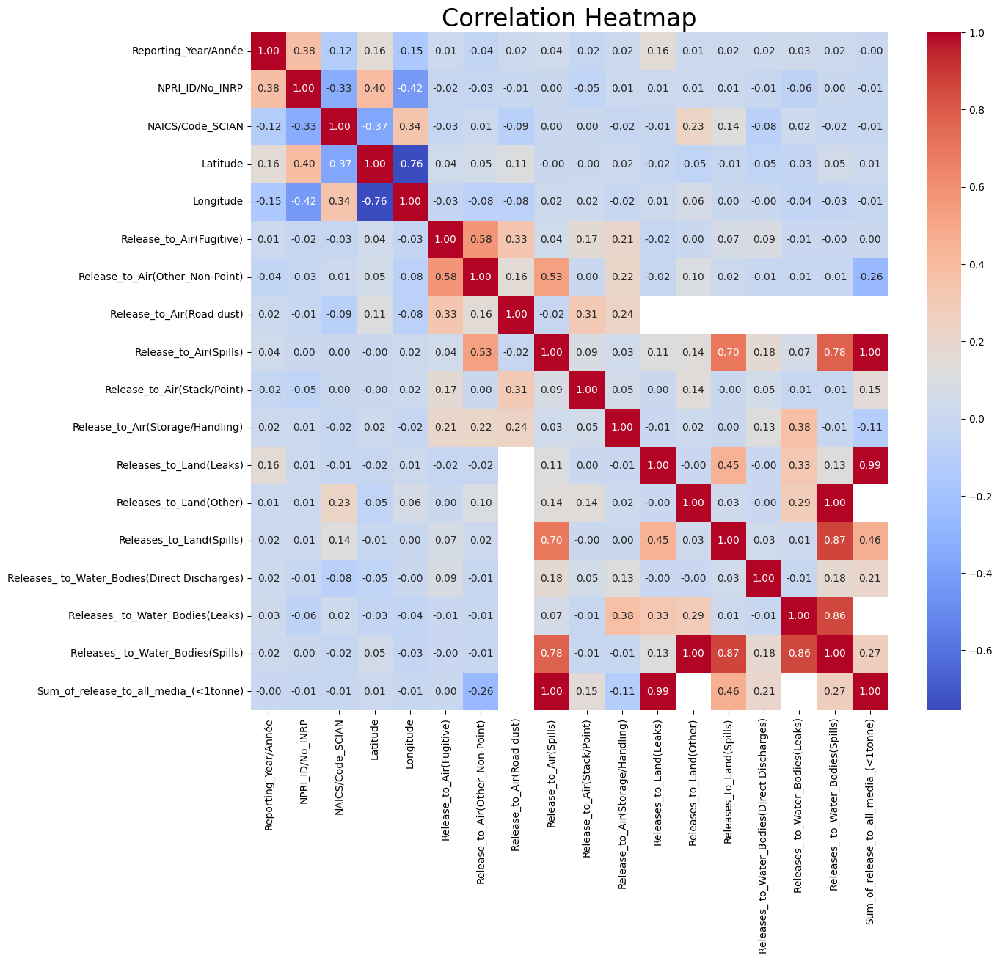

In [ ]:
# Creating a heatmap using Seaborn
plt.figure(figsize=(14, 12))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt= ".2f")
plt.title('Correlation Heatmap', size = 24)
plt.show()

# displaying map
plt.show()

**Observation**

There is the presense of strong correlations in the dataset between the following features:

Positive correlations:

- Release to air spills and release to land spills
- Release to air spills and release to water bodies spills
- Release to air spills and sum of release to all media
- Release to land leaks and sum of release to all media
- Release to land - other and releases to water bodies - spills
- Release to land - spills and releases to water bodies - spills
- Releases to water bodies - spills and releases to water bodies - leaks

Negative correlation:

The only strong negatively correlated features are longitude and latitide

### 3. Histogram
Histograms provide a graphical representation of the distribution of numerical data. Data points are grouped into bins (intervals) and counts how many data points fall into each bin. It is a great way to visualize the distribution, frequency, and shape of the dataset.

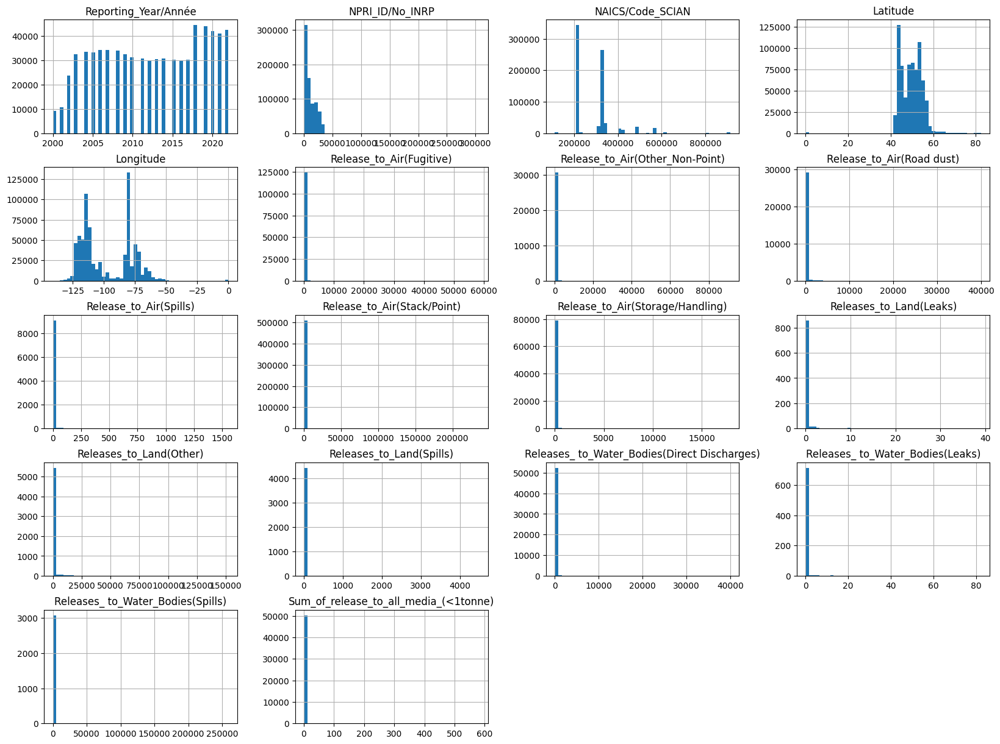

In [ ]:
df_NPRI.hist(bins=50, figsize=(20,15))
plt.show()

**Observation**
- The releases data are skewed with outliers indicated by the gaps in the bars.
- Reporting was at its lowest in the year 2000.
- The reporting between 2007 and 2022 appear fairly stable.

### 4. Boxplot

Also called Box-and-Whisker plot. It is a great way to visualize the distribution of numerical data and identify potential outliers. It displays the median, quartiles, and potential outliers in the dataset. Typically,data points beyond the upper and lower limits of the boxplot are outliers and should be removed except in scenarios where the outlier is a rare occurrence that is of significance.

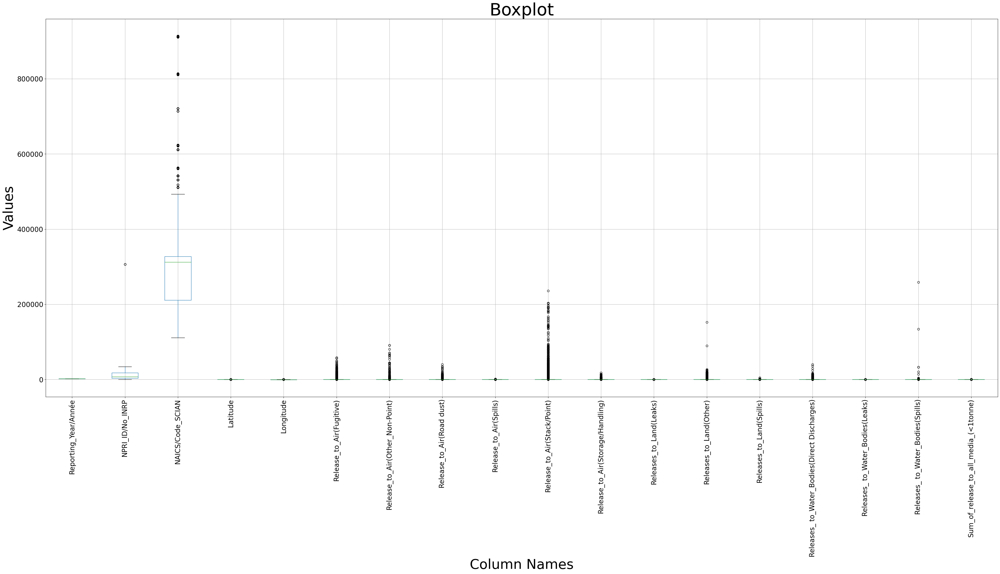

In [ ]:
df_NPRI.boxplot(figsize = (50, 20))
plt.title('Boxplot', size = 50)
plt.xlabel('Column Names', size = 40)
plt.ylabel('Values', size = 40)
plt.xticks(fontsize=20, rotation = 90)
plt.yticks(fontsize=20)
plt.show()

### 5. Multivariate Boxplot

Creating Multivariate Boxplots of the ammonia (total), nitrate_ion, Phosphorus (total) and phosphorus (white and yellow) against the 3 types of releases to water to detect outliers in the release columns

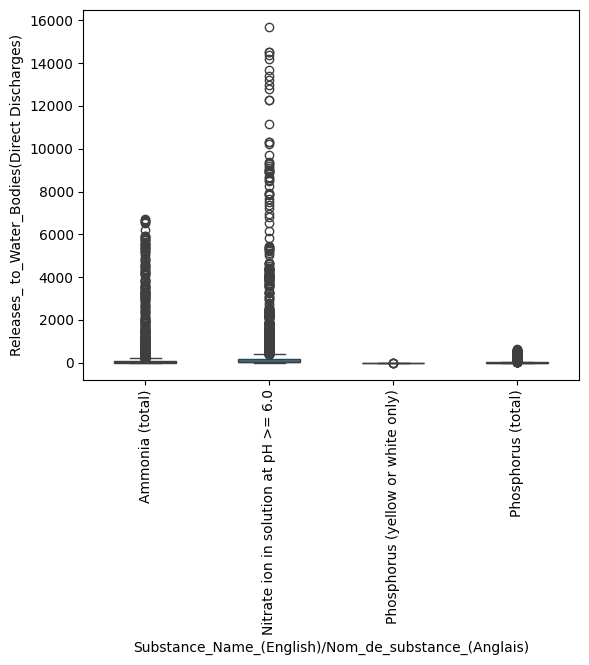

In [ ]:
# Creating multivariate boxplot
# Boxplot of ammonia, nitrate and phosphorus against all the releases
substances = ['Ammonia (total)', 'Nitrate ion in solution at pH >= 6.0',
              'Phosphorus (yellow or white only)', 'Phosphorus (total)']

# Filter the DataFrame for the desired substances
filtered_df = df_NPRI[df_NPRI['Substance_Name_(English)/Nom_de_substance_(Anglais)'].isin(substances)]

# Create the boxplot
sns.boxplot(x='Substance_Name_(English)/Nom_de_substance_(Anglais)',
            y='Releases_ to_Water_Bodies(Direct Discharges)',
            data=filtered_df, width = .5)

# Rotate x-axis labels vertically
plt.xticks(rotation=90)

plt.show()

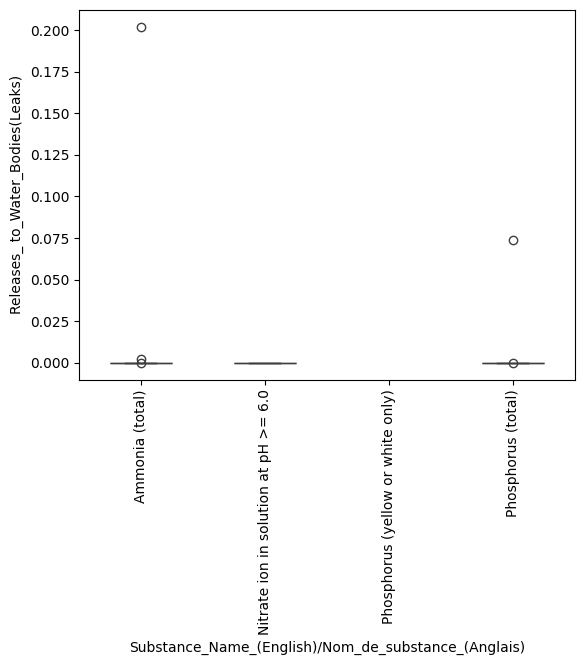

In [ ]:

# Creating multivariate boxplot
# Boxplot of ammonia, nitrate and phosphorus against all the releases
substances = ['Ammonia (total)', 'Nitrate ion in solution at pH >= 6.0',
              'Phosphorus (yellow or white only)', 'Phosphorus (total)']

# Filter the DataFrame for the desired substances
filtered_df = df_NPRI[df_NPRI['Substance_Name_(English)/Nom_de_substance_(Anglais)'].isin(substances)]

# Create the boxplot
sns.boxplot(x='Substance_Name_(English)/Nom_de_substance_(Anglais)',
            y='Releases_ to_Water_Bodies(Leaks)',
            data=filtered_df, width = .5)

# Rotate x-axis labels vertically
plt.xticks(rotation=90)

plt.show()

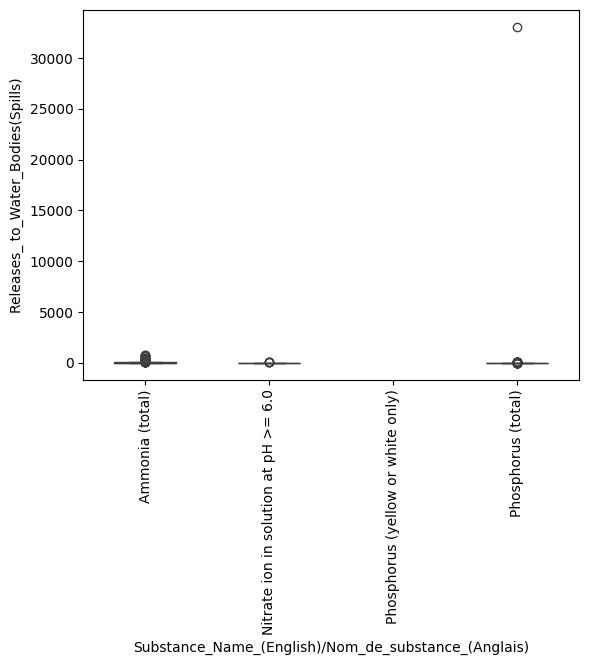

In [ ]:

# Creating multivariate boxplot
# Boxplot of ammonia, nitrate and phosphorus against all the releases
substances = ['Ammonia (total)', 'Nitrate ion in solution at pH >= 6.0',
              'Phosphorus (yellow or white only)', 'Phosphorus (total)']

# Filter the DataFrame for the desired substances
filtered_df = df_NPRI[df_NPRI['Substance_Name_(English)/Nom_de_substance_(Anglais)'].isin(substances)]

# Create the boxplot
sns.boxplot(x='Substance_Name_(English)/Nom_de_substance_(Anglais)',
            y='Releases_ to_Water_Bodies(Spills)',
            data=filtered_df, width = .5)

# Rotate x-axis labels vertically
plt.xticks(rotation=90)

plt.show()

**Observation**
- The presence of outliers shown in the box plot corroborates the observation from histogram plot.

### 5. Line plots

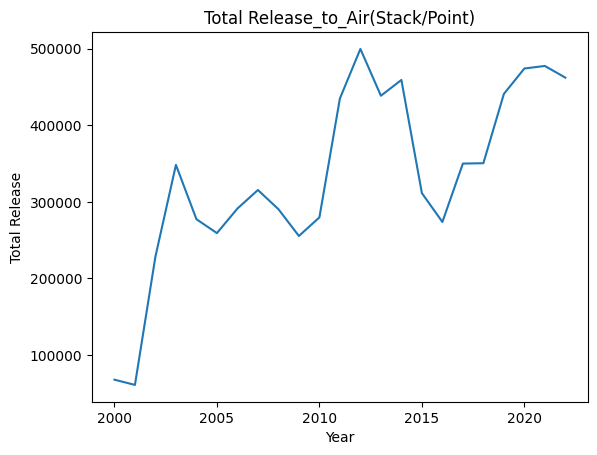

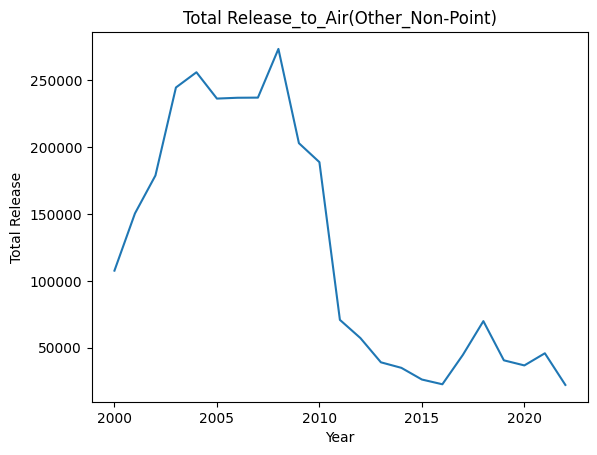

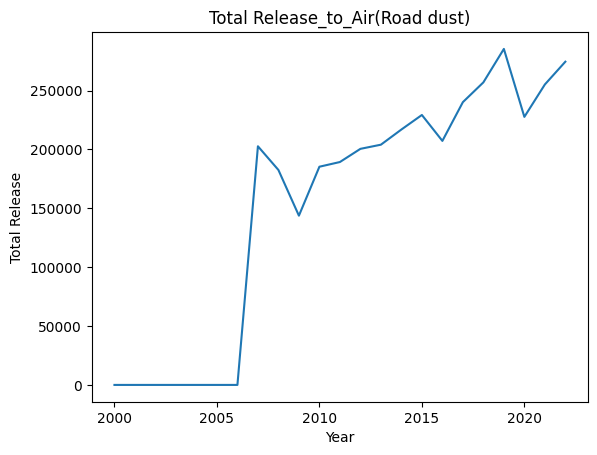

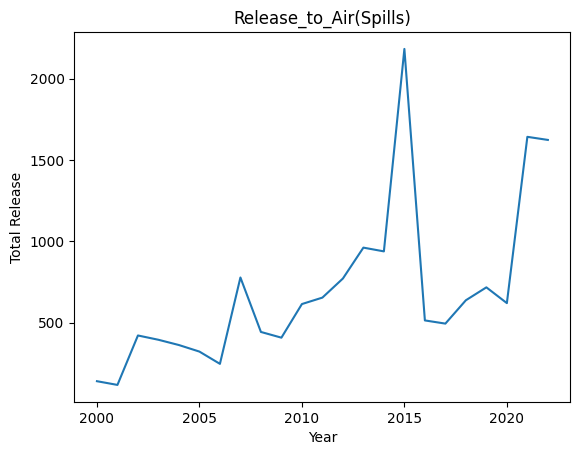

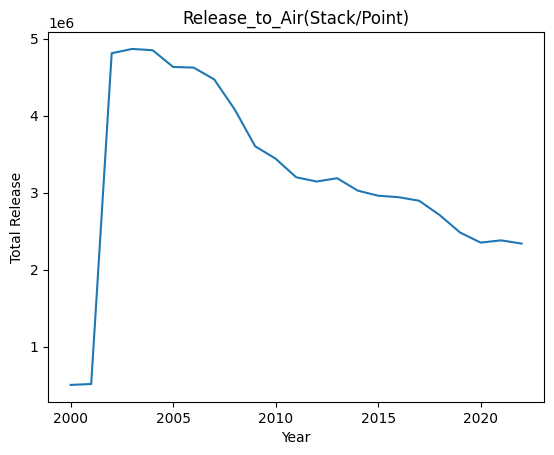

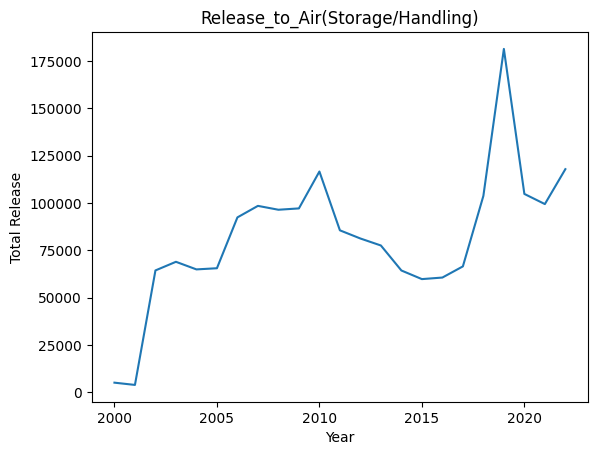

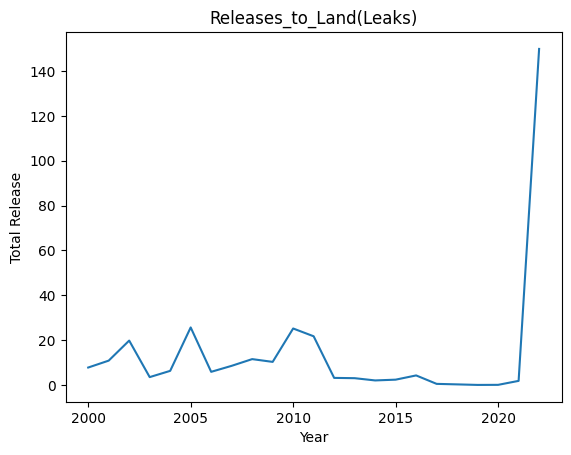

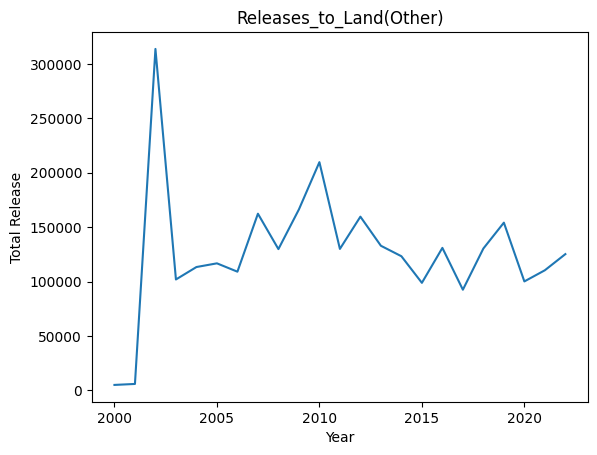

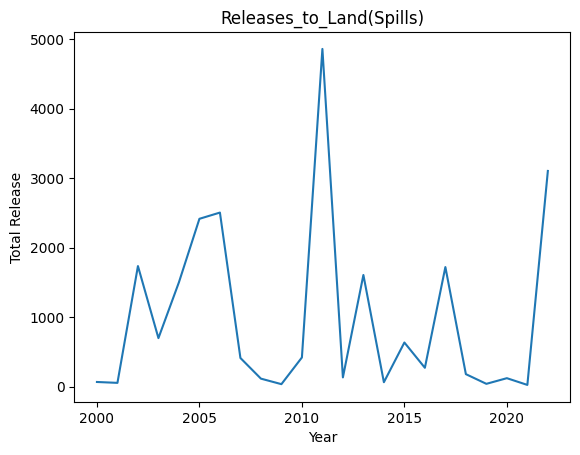

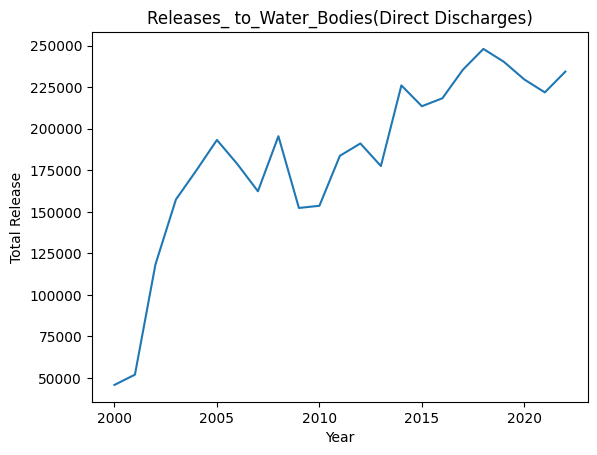

In [ ]:
#if 'Reporting_Year/Année' in df.columns:
df_NPRI.groupby('Reporting_Year/Année')['Release_to_Air(Fugitive)'].sum().plot(kind='line')
plt.title('Total Release_to_Air(Stack/Point)')
plt.xlabel('Year')
plt.ylabel('Total Release')
plt.show()


#if 'Reporting_Year/Année' in df.columns:
df_NPRI.groupby('Reporting_Year/Année')['Release_to_Air(Other_Non-Point)'].sum().plot(kind='line')
plt.title('Total Release_to_Air(Other_Non-Point)')
plt.xlabel('Year')
plt.ylabel('Total Release')
plt.show()

#if 'Reporting_Year/Année' in df.columns:
df_NPRI.groupby('Reporting_Year/Année')['Release_to_Air(Road dust)'].sum().plot(kind='line')
plt.title('Total Release_to_Air(Road dust)')
plt.xlabel('Year')
plt.ylabel('Total Release')
plt.show()

df_NPRI.groupby('Reporting_Year/Année')['Release_to_Air(Spills)'].sum().plot(kind='line')
plt.title('Release_to_Air(Spills)')
plt.xlabel('Year')
plt.ylabel('Total Release')
plt.show()

df_NPRI.groupby('Reporting_Year/Année')['Release_to_Air(Stack/Point)'].sum().plot(kind='line')
plt.title('Release_to_Air(Stack/Point)')
plt.xlabel('Year')
plt.ylabel('Total Release')
plt.show()

df_NPRI.groupby('Reporting_Year/Année')['Release_to_Air(Storage/Handling)'].sum().plot(kind='line')
plt.title('Release_to_Air(Storage/Handling)')
plt.xlabel('Year')
plt.ylabel('Total Release')
plt.show()

df_NPRI.groupby('Reporting_Year/Année')['Releases_to_Land(Leaks)'].sum().plot(kind='line')
plt.title('Releases_to_Land(Leaks)')
plt.xlabel('Year')
plt.ylabel('Total Release')
plt.show()

df_NPRI.groupby('Reporting_Year/Année')['Releases_to_Land(Other)'].sum().plot(kind='line')
plt.title('Releases_to_Land(Other)')
plt.xlabel('Year')
plt.ylabel('Total Release')
plt.show()

df_NPRI.groupby('Reporting_Year/Année')['Releases_to_Land(Spills)'].sum().plot(kind='line')
plt.title('Releases_to_Land(Spills)')
plt.xlabel('Year')
plt.ylabel('Total Release')
plt.show()

df_NPRI.groupby('Reporting_Year/Année')['Releases_ to_Water_Bodies(Direct Discharges)'].sum().plot(kind='line')
plt.title('Releases_ to_Water_Bodies(Direct Discharges)')
plt.xlabel('Year')
plt.ylabel('Total Release')
plt.show()

**The line plot shows the trend of release amount over a period of 22 years**

## Data Profiling

In [ ]:
pip install ydata-profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.9/390.9 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 21.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 30.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 69.1 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=ffe4e8bbddfd5dec5609bda409a4e46a350b8b5948626cc49a513a6509d92919
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
from ydata_profiling import ProfileReport

In [ ]:
profile = ProfileReport(df_NPRI, title="Pandas Profiling Report", explorative=True)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## **Data Problems  / Issue Dectecion**


 Dtype refers to the data type of the elements within a DataFrame. Each column in a pandas DataFrame can have a different dtype. In this dataset, we identified some columns with dtype int64 and object but the correct dtype should be category (see summary of columns with wrong dtype in the Table 1 below. This is an issue that will be addressed in the Issue Handling section.

**Table 1.**

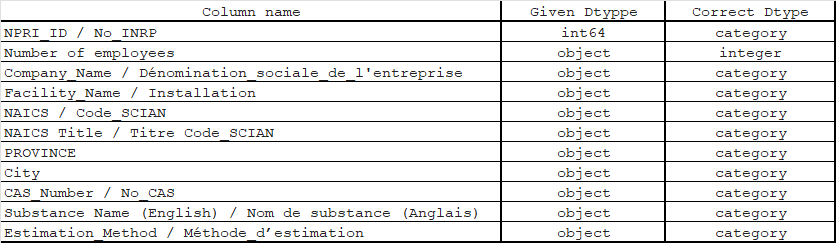

 2. Missing values refers to cells in the dataframe that contain null values and are typically represented as NaN (Not a Number). Many machine algorithm cannot handle datset with missing values, thus we will be filling these null values with appropriate techniques. Table 2 shows the list of columns with missing values, the amount and percentage of missing values.



**Table 2.**

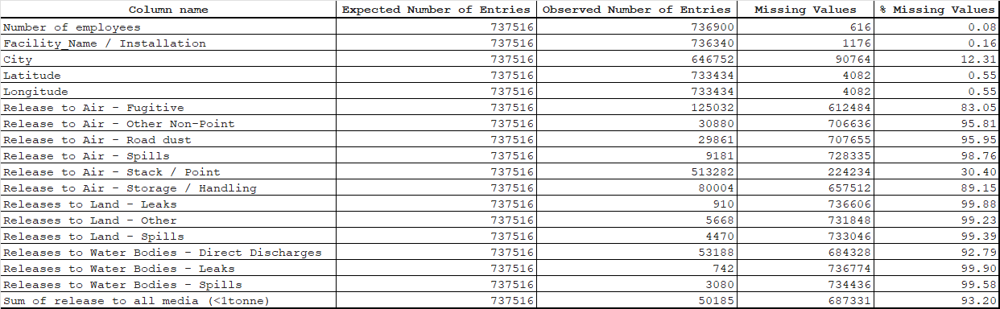

In [ ]:
# code to confirm the number of nulls in each column
df_NPRI.isnull().sum()

,0
Reporting_Year/Année,0
NPRI_ID/No_INRP,0
Number_of_Employees,616
Company_Name/Dénomination_sociale_de_l'entreprise,0
Facility_Name/Installation,1176
NAICS/Code_SCIAN,0
NAICS Title/Titre_Code_SCIAN,0
PROVINCE,0
City,90764
Latitude,4082


Inconsistent Data can refer to  incorrect formats, or varying representations of the same information.

- In the Units column, there are 4 different types of units for substance releases (gTEQ, grams, kg, tonnes). To ensure consistency, we need to use only one unit of measurement for all substances released

- Uppercase vs lowercase e.g CHEMTURA CANADA CO/CIE and Chemtura Canada Co. Cie. are the same company

- Incorrect spelling

- The same entry with slight differences in nomenclature e.g., in Company_Name column, 349977 ONTARIO and 349977 ONTARIO LIMITED are the same company because they have the same facility name and the same NAICS Title.

In [ ]:
# checking for the unique units of measurement in the Units column
df_NPRI['Units/Unités'].unique()

array(['tonnes', 'kg', 'grams', 'g TEQ'], dtype=object)

Inconsistent Column Names Some of the column names have trailing spaces and apostrophe (') causing issues with calling them in codes. For example:
'Units / Unités',

'Release to Air - Spills ',

'Company_Name / Dénomination_sociale_de_l'entreprise'

## **Data Preparation**

We coined this step as data preparation because we identified some data issues that needs to be addressed prior to splitting. Below are the list
- sychronize data units
- remove duplicates

After this we will split the dataset into Train and Test before continuing with the rest of the cleaning. The reason for the split is to avoid data leakage between the train and test set.

### **1. Sychronize data units**

To maintain consistency in our dataset, we will be converting all the units to kilogram To achieve this we will
- convert the tonnes and grams to kilograms.
- convert the g TEQ to kg TEQ as well

g TEQ is a special unit that measures toxic equivalency factor. We will retain this unit and create a special feature for it.

In [ ]:
# checking for the different units of measurement for pollutants in the dataset
df_NPRI['Units/Unités'].unique()

array(['tonnes', 'kg', 'grams', 'g TEQ'], dtype=object)

In [ ]:
# checking the number of entries for each unit type
df_NPRI['Units/Unités'].value_counts()

,count
Units/Unités,
tonnes,658955
kg,70186
g TEQ,4816
grams,3559


In [ ]:
# unit conversion

value = [
       'Releases_ to_Water_Bodies(Direct Discharges)',
       'Releases_ to_Water_Bodies(Leaks)', 'Releases_ to_Water_Bodies(Spills)']

Units = ['tonnes', 'kg', 'grams']

def convert_units(value, Units):
    if Units == 'tonnes':
        return value * 1000  # Convert tonnes to kilograms
    elif Units == 'grams':
        return value / 1000  # Convert grams to kilograms
    elif Units == 'g TEQ':
        return value / 1000  # Convert g TEQ (already in grams) to kilograms
    else:
        return value  # Kilograms remain unchanged

for col in value:
    df_NPRI[col] = df_NPRI.apply(lambda row: convert_units(row[col], row['Units/Unités']), axis=1)

In [ ]:
# Renaming tonnes and grams to kilograms and g TEQ to kg TEQ

# Dictionary to map old unit values to new ones
unit_mapping = {
    'tonnes': 'kg',
    'grams': 'kg',
    'g TEQ': 'kg TEQ'
}

# Replace the values in the 'Units' column using the mapping
df_NPRI['Units/Unités'] = df_NPRI['Units/Unités'].replace(unit_mapping)


In [ ]:
# checking for the different units of measurement for pollutants in the dataset after conversion
df_NPRI['Units/Unités'].unique()

array(['kg', 'kg TEQ'], dtype=object)

### **2. Checking and removing duplicate data entries**

In [ ]:
# checking for duplicates in the dataframe
df_NPRI.duplicated().sum()

0

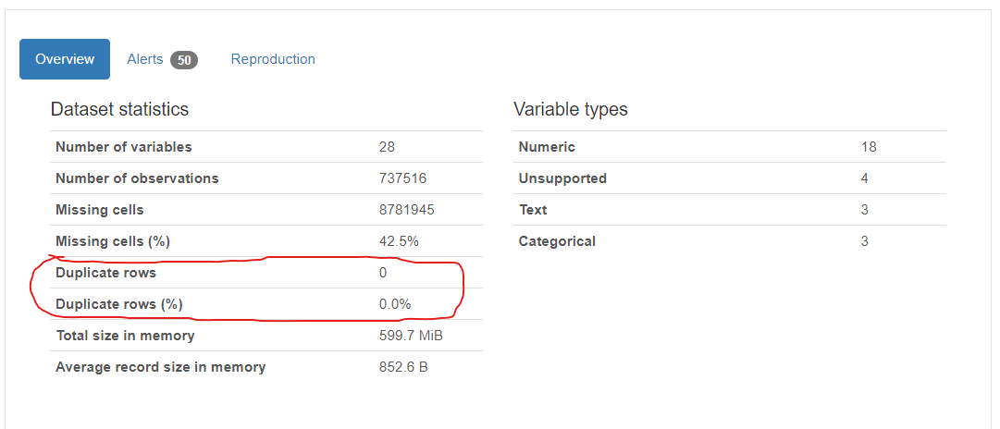

There are no duplicates in this dataset and it confirms the result from the initial data profiling carried out. So there is no need to remove any duplicate.

### **3. Changing columns with "Object" dtype into Categories**

With the exception of the "Number of Employees" column we will change the object column types into category. We will change that of the number of employees after data splitting to avoid data leakage

In [ ]:
#changing columns to the appropriate data type
df_NPRI['Reporting_Year/Année'] = df_NPRI['Reporting_Year/Année'].astype('category')
df_NPRI['NPRI_ID/No_INRP'] = df_NPRI['NPRI_ID/No_INRP'].astype('category')
#df_NPRI['Number_of_Employees'] = df_NPRI['Number_of_Employees'].astype('int')
df_NPRI["Company_Name/Dénomination_sociale_de_l'entreprise"] = df_NPRI["Company_Name/Dénomination_sociale_de_l'entreprise"].astype('category')
df_NPRI['Facility_Name/Installation'] = df_NPRI['Facility_Name/Installation'].astype('category')
df_NPRI['NAICS/Code_SCIAN'] = df_NPRI['NAICS/Code_SCIAN'].astype('category')
df_NPRI['NAICS Title/Titre_Code_SCIAN'] = df_NPRI['NAICS Title/Titre_Code_SCIAN'].astype('category')
df_NPRI['PROVINCE'] = df_NPRI['PROVINCE'].astype('category')
df_NPRI['City'] = df_NPRI['City'].astype('category')
df_NPRI['Latitude'] = df_NPRI['Latitude'].astype('float')
df_NPRI['Longitude'] = df_NPRI['Longitude'].astype('float')
df_NPRI['CAS_Number/No_CAS'] = df_NPRI['CAS_Number/No_CAS'].astype('category')
df_NPRI['Substance_Name_(English)/Nom_de_substance_(Anglais)'] = df_NPRI['Substance_Name_(English)/Nom_de_substance_(Anglais)'].astype('category')
df_NPRI['Units/Unités'] = df_NPRI['Units/Unités'].astype('category')
df_NPRI['Estimation_Method/Méthode_d’estimation'] = df_NPRI['Estimation_Method/Méthode_d’estimation'].astype('category')

### **Comments word cloud**

Creating a word cloud of the comments dataset using data profiling

In [ ]:
profile_comment = ProfileReport(df_NPRI_comments, title="Pandas Profiling Report Comments", explorative=True)
profile_comment

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# **Phase 2 - Linear Regression Model**

###  Filtering dataset based on pollutants of interest.

Since our prediction is focused on ammonia, nitrate ions and phosporus only, we will filter our dataset into three different dataframes based on the substance types of interest.

In [ ]:
# create a dataframe for ammonia(total)
df_NPRI_ammonia = df_NPRI[df_NPRI['Substance_Name_(English)/Nom_de_substance_(Anglais)'] == 'Ammonia (total)']

#reset index
df_NPRI_ammonia = df_NPRI_ammonia.reset_index(drop=True)


df_NPRI_ammonia.shape

(13934, 28)

In [ ]:
# create a dataframe for phosphorsu(total)
df_NPRI_phosphorus = df_NPRI[df_NPRI['Substance_Name_(English)/Nom_de_substance_(Anglais)'] == 'Phosphorus (total)']


#reset index
df_NPRI_phosphorus = df_NPRI_phosphorus.reset_index(drop=True)

df_NPRI_phosphorus.shape

(8031, 28)

In [ ]:
# create a dataframe for Nitrate ion
df_NPRI_nitrate = df_NPRI[df_NPRI['Substance_Name_(English)/Nom_de_substance_(Anglais)'] == 'Nitrate ion in solution at pH >= 6.0']

#reset index
df_NPRI_nitrate = df_NPRI_nitrate.reset_index(drop=True)

df_NPRI_nitrate.shape

(4357, 28)

# **Ammonia Dataframe**

# Feature Engineering and Preprocessing

In this step we carry out data aligning to ensure our dataset is suitable for use in the machine learning model. This includes splitting our data into train and test steps, and carryin out some further cleanin steps.



### Splitting dataset into Train and Test sets

We will go ahead to split the dataset using year 2018 as cutoff to separate dataset into test and train set (years 2000 to 2018 will be train set and years 2019 to 2022 will be the test set).

Step 1) Sort the dataframe by date (Reporting_Year/Année)

Step 2) Write code to separate into train and test set

In [ ]:


def split_data(df, year_column, split_year):
    """
    Splits the ammonia dataset into training and testing sets based on a specified year.

    Parameters:
        df (pd.DataFrame): The input DataFrame to be split.
        year_column (str): The name of the column containing the reporting year.
        split_year (int): The year to split the data. Rows with years <= split_year go to training, others to testing.

    Returns:
        tuple: A tuple containing two DataFrames: (train_data, test_data).
    """
    # Make a copy of the dataframe
    df_copy = df.copy()

    # Convert the year column to a categorical type (ordered)
    df_copy[year_column] = pd.Categorical(df_copy[year_column], ordered=True)

    # Split into training and testing sets
    train_data = df_copy[df_copy[year_column] <= split_year]
    test_data = df_copy[df_copy[year_column] > split_year]

    return train_data, test_data

def fill_missing_coordinates(df, facility_column, latitude_column, longitude_column):
    """
    Fills missing latitude and longitude values for a facility using the first non-null coordinates
    from the same facility's data.

    Parameters:
        df (pd.DataFrame): The input DataFrame with missing latitude and longitude values.
        facility_column (str): The column name for the facility identifier.
        latitude_column (str): The column name for latitude.
        longitude_column (str): The column name for longitude.

    Returns:
        pd.DataFrame: The DataFrame with missing latitude and longitude values filled.
    """
    # Make a copy of the DataFrame to avoid modifying the original
    df_copy = df.copy()

    # Iterate through facilities with missing latitude or longitude
    for latitude, longitude, facility_name in df_copy[[latitude_column, longitude_column, facility_column]].itertuples(index=False):
        if pd.isna(latitude) and pd.isna(longitude):
            # Filter rows for the current facility
            facility_data = df_copy[df_copy[facility_column] == facility_name]

            # Find non-null latitude and longitude for the facility
            non_null_latitude = facility_data[latitude_column].dropna()
            non_null_longitude = facility_data[longitude_column].dropna()

            # If non-null latitude and longitude exist, update missing values
            if not non_null_latitude.empty and not non_null_longitude.empty:
                df_copy.loc[df_copy[facility_column] == facility_name, latitude_column] = non_null_latitude.iloc[0]
                df_copy.loc[df_copy[facility_column] == facility_name, longitude_column] = non_null_longitude.iloc[0]

    return df_copy

def fill_missing_cities(df, facility_column, city_column):
    """
    Fills missing city values for facilities using the first non-null city value
    from the same facility's data.

    Parameters:
        df (pd.DataFrame): The input DataFrame containing city and facility data.
        facility_column (str): The column name representing facility names.
        city_column (str): The column name representing the city.

    Returns:
        pd.DataFrame: A DataFrame with missing city values filled.
    """
    # Make a copy of the DataFrame to avoid modifying the original
    df_copy = df.copy()

    # Iterate through each row with city and facility data
    for city, facility_name in df_copy[[city_column, facility_column]].itertuples(index=False):
        # If the city is missing
        if pd.isna(city):
            # Get data for the current facility
            facility_data = df_copy[df_copy[facility_column] == facility_name]

            # Find the first non-null city for this facility
            non_null_city = facility_data[city_column].dropna()

            # If a non-null city exists, fill the missing city
            if not non_null_city.empty:
                df_copy.loc[df_copy[facility_column] == facility_name, city_column] = non_null_city.iloc[0]

    return df_copy

def fill_missing_cities_by_company(df, company_column, city_column):
    """
    Fills missing city values for companies using the first non-null city value
    from the same company's data.

    Parameters:
        df (pd.DataFrame): The input DataFrame containing city and company data.
        company_column (str): The column name representing company names.
        city_column (str): The column name representing the city.

    Returns:
        pd.DataFrame: A DataFrame with missing city values filled.
    """
    # Make a copy of the DataFrame to avoid modifying the original
    df_copy = df.copy()

    # Iterate through each row with city and company data
    for city, company_name in df_copy[[city_column, company_column]].itertuples(index=False):
        # If the city is missing
        if pd.isna(city):
            # Get data for the current company
            company_data = df_copy[df_copy[company_column] == company_name]

            # Find the first non-null city for this company
            non_null_city = company_data[city_column].dropna()

            # If a non-null city exists, fill the missing city
            if not non_null_city.empty:
                df_copy.loc[df_copy[company_column] == company_name, city_column] = non_null_city.iloc[0]

    return df_copy


def fill_missing_numeric_with_median(df, column_name):
    """
    Fills missing values in a specified numeric column with the median of the column.

    Parameters:
        df (pd.DataFrame): The input DataFrame.
        column_name (str): The name of the column to process.

    Returns:
        pd.DataFrame: A DataFrame with missing values in the specified column filled with the median.
    """
    # Make a copy of the DataFrame to avoid modifying the original
    df_copy = df.copy()

    # Convert the column to numeric, replacing non-numeric values with NaN
    df_copy[column_name] = pd.to_numeric(df_copy[column_name], errors='coerce')

    # Fill NaN values with the median of the numeric values
    df_copy[column_name] = df_copy[column_name].fillna(df_copy[column_name].median())

    return df_copy




In [ ]:
df_NPRI_ammonia1 = split_data(df = df_NPRI_ammonia, year_column = 'Reporting_Year/Année', split_year = 2018)

# Unpack the tuple into train_data and test_data
train_data, test_data = df_NPRI_ammonia1

train_ammonia = train_data
test_ammonia = test_data

train_ammonia.shape, test_ammonia.shape

((11489, 28), (2445, 28))

Cleaning the train and test sets separately to avoid data leakage

In [ ]:
train_ammonia.isnull().sum()

,0
Reporting_Year/Année,0
NPRI_ID/No_INRP,0
Number_of_Employees,13
Company_Name/Dénomination_sociale_de_l'entreprise,0
Facility_Name/Installation,2
NAICS/Code_SCIAN,0
NAICS Title/Titre_Code_SCIAN,0
PROVINCE,0
City,63
Latitude,44


In [ ]:
test_ammonia.isnull().sum()

,0
Reporting_Year/Année,0
NPRI_ID/No_INRP,0
Number_of_Employees,0
Company_Name/Dénomination_sociale_de_l'entreprise,0
Facility_Name/Installation,0
NAICS/Code_SCIAN,0
NAICS Title/Titre_Code_SCIAN,0
PROVINCE,0
City,42
Latitude,12


Checking to see if any of the missing latitude and longitude rows have been previously registered by the same company and filling it with already available information

In [ ]:
train_ammonia = fill_missing_coordinates(train_ammonia, 'Facility_Name/Installation', 'Latitude', 'Longitude')
test_ammonia = fill_missing_coordinates(test_ammonia, 'Facility_Name/Installation', 'Latitude', 'Longitude')

Dropping the rows  that still have missing latitude and longitude values

In [ ]:
train_ammonia = train_ammonia.dropna(subset=['Latitude', 'Longitude'])
test_ammonia = test_ammonia.dropna(subset=['Latitude', 'Longitude'])

In [ ]:
# drop the rows with missing facility name
train_ammonia = train_ammonia.dropna(subset=['Facility_Name/Installation'])


Using the same approach to fill in the missing city names

In [ ]:
train_ammonia = fill_missing_cities(train_ammonia, 'Facility_Name/Installation', 'City')
test_ammonia = fill_missing_cities(test_ammonia, 'Facility_Name/Installation', 'City')

In [ ]:
train_ammonia = fill_missing_cities_by_company(train_ammonia, "Company_Name/Dénomination_sociale_de_l'entreprise", 'City')
test_ammonia = fill_missing_cities_by_company(test_ammonia, "Company_Name/Dénomination_sociale_de_l'entreprise", 'City')

Dropping the rows that still have missing city information

In [ ]:
# drop the rows with missing facility name
train_ammonia = train_ammonia.dropna(subset=['City'])
test_ammonia = test_ammonia.dropna(subset=['City'])

Filling the missing 'Number of Employees' with the median

In [ ]:
train_ammonia = fill_missing_numeric_with_median(train_ammonia, 'Number_of_Employees')


Company information reveals that if there are missing values in the release column it is because no value was reported for the company for that substance or year and it implies that either the company did not release that substance or the amount released does not reach the threshold that requires reporting.

For that reason, we fill the missing values in the release colums as zero(0)

In [ ]:
def fill_missing_with_zeros(df, columns):
    """
    Fills missing values in the specified columns with zeros.

    Parameters:
        df (pd.DataFrame): The input DataFrame.
        columns (list): A list of column names to process.

    Returns:
        pd.DataFrame: A DataFrame with missing values in the specified columns filled with zeros.
    """
    # Make a copy of the DataFrame to avoid modifying the original
    df_copy = df.copy()

    # Fill missing values in the specified columns with zeros
    for column in columns:
        df_copy[column] = df_copy[column].fillna(0)

    return df_copy


In [ ]:
columns = ['Release_to_Air(Fugitive)',
       'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
       'Release_to_Air(Spills)', 'Release_to_Air(Stack/Point)',
       'Release_to_Air(Storage/Handling)', 'Releases_to_Land(Leaks)',
       'Releases_to_Land(Other)', 'Releases_to_Land(Spills)',
       'Releases_ to_Water_Bodies(Direct Discharges)',
       'Releases_ to_Water_Bodies(Leaks)', 'Releases_ to_Water_Bodies(Spills)',
       'Sum_of_release_to_all_media_(<1tonne)']
for column in columns:
  train_ammonia = fill_missing_with_zeros(train_ammonia, [column])
  test_ammonia = fill_missing_with_zeros(test_ammonia, [column])


In [ ]:
train_ammonia.shape, test_ammonia.shape

((11446, 28), (2433, 28))

### Merging the population dataset with our ammonia dataset

The problem focuses on predicting substance release amount based on provincial population. Therefore, at this point we merge the population dataset that contains provincial population information from 2000 to 2022.

In [ ]:
# load the population dataset
df_population = pd.read_csv('Provincial_population_dataset.csv', encoding = 'latin1')

#Setting up notebook so that all columns are displayed
pd.set_option('display.max_columns', None)

# displaying the first 5 columns
df_population.head()


,ï»¿Reporting_Year/AnnÃ©e,PROVINCE,Population
0,2000,NL,"2,116,046"
1,2001,NL,2092160
2,2002,NL,2080388
3,2003,NL,2074982
4,2004,NL,2070803


In [ ]:
#renaming the column names in the population dataset
df_population = df_population.rename(columns={'ï»¿Reporting_Year/AnnÃ©e': 'Reporting_Year/Année', 'Province': 'PROVINCE', 'Population': 'Population'})

# Replace commas in the 'Population' column with empty strings before converting to int
df_population['Population'] = df_population['Population'].str.replace(',', '').astype(int)

In [ ]:
def merge_datasets(df1, df2, merge_columns):
    """
    Merges two DataFrames on specified columns.

    Parameters:
        df1 (pd.DataFrame): The first DataFrame.
        df2 (pd.DataFrame): The second DataFrame.
        merge_columns (list): List of column names to merge on.

    Returns:
        pd.DataFrame: The merged DataFrame.
    """
    return pd.merge(df1, df2, on=merge_columns)



In [ ]:

# Merging the train dataset with the population dataset
train_ammonia = merge_datasets(train_ammonia, df_population, merge_columns=['Reporting_Year/Année', 'PROVINCE'])

# Merging the test dataset with the population dataset
test_ammonia = merge_datasets(test_ammonia, df_population, merge_columns=['Reporting_Year/Année', 'PROVINCE'])

train_ammonia.shape, test_ammonia.shape

((11446, 29), (2433, 29))

### Feature Engineering on datasets



1.   Creating a new column called "Total Release to Water". The new column is an aggregate of the values the the three release to water column. This new column is our target column in the ML model.
2.   Creating a region  column using K-means clustering on the Latitude and Longitude values in our dataset. This helps with spatial analysis by grouping locations into clusters based on proximity. This simplifies exploring regional trends and identifying spatial patterns in the dataset.



In [ ]:
# Adding Up all the Releases to Water Bodies

Release_to_Water_columns = [
    'Releases_ to_Water_Bodies(Direct Discharges)',
    'Releases_ to_Water_Bodies(Leaks)',
    'Releases_ to_Water_Bodies(Spills)'
]

# Sum the specified release to water bodies columns and create a new column 'Total_Releases_to_Water'
train_ammonia['Total_Release_to_Water'] = train_ammonia[Release_to_Water_columns].sum(axis=1)

# Sum the specified release to water bodies columns and create a new column 'Total_Releases_to_Water'
test_ammonia['Total_Release_to_Water'] = test_ammonia[Release_to_Water_columns].sum(axis=1)

#drop the release to water columns
train_ammonia = train_ammonia.drop(['Releases_ to_Water_Bodies(Direct Discharges)', 'Releases_ to_Water_Bodies(Leaks)', 'Releases_ to_Water_Bodies(Spills)'], axis = 1)

#drop the release to water columns
test_ammonia = test_ammonia.drop(['Releases_ to_Water_Bodies(Direct Discharges)', 'Releases_ to_Water_Bodies(Leaks)', 'Releases_ to_Water_Bodies(Spills)'], axis = 1)


In [ ]:
#K means clustering on latitude and longitude
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=5, random_state=42)
train_ammonia['Region'] = kmeans.fit_predict(train_ammonia[['Latitude', 'Longitude']])
test_ammonia['Region'] = kmeans.fit_predict(test_ammonia[['Latitude', 'Longitude']])

Since the unit and the substance column each have one unique column, we drop both columns.

In [ ]:
#drop substance and unit columns
train_ammonia = train_ammonia.drop(['Substance_Name_(English)/Nom_de_substance_(Anglais)', 'Units/Unités'], axis = 1)
test_ammonia = test_ammonia.drop(['Substance_Name_(English)/Nom_de_substance_(Anglais)', 'Units/Unités'], axis = 1)

In [ ]:
train_ammonia.shape, test_ammonia.shape

((11446, 26), (2433, 26))

Building the first model without feature selection steps

We make a copy of the train and test ammonia dataframe. The train_ammonia and test_ammonia can be copied to use during feature selection

In [ ]:
# copy of the train and test sets
train_ammonia_1 = train_ammonia.copy()
test_ammonia_1 = test_ammonia.copy()

# Extract the target variable before dropping it from the features
y_train_ammonia_1 = train_ammonia_1['Total_Release_to_Water']
y_test_ammonia_1 = test_ammonia_1['Total_Release_to_Water']

# Now drop the target variable from the feature sets
X_train_ammonia_1 = train_ammonia_1.drop(['Total_Release_to_Water'], axis = 1)
X_test_ammonia_1 = test_ammonia_1.drop(['Total_Release_to_Water'], axis = 1)

In [ ]:
X_train_ammonia_1.shape, X_test_ammonia_1.shape

((11446, 25), (2433, 25))

In [ ]:
y_train_ammonia_1.shape, y_test_ammonia_1.shape

((11446,), (2433,))

Determining what methods to use for normalization of each of the numerical columns that require normalization.

Columns that don't need normalization

1.   Reporting year- It is temporal data and does not need to be normalized
2.   NPRI_ID - is a unique identifier and should not be scaled
3. Latitude and Longitude - They represent spatial locations and should not be normalized
4. CAS_Number/No_CAS - An identifier for chemicals

Columns that require normalization are the **release columns** and the "**number of employees** column" and the **population** column.



Columns that require encoding:

1.   OneHot for Province (13 unique entries) and Estimation method (11 unique entries).
2.   Binary encoding for Company name(1013 unique entries), Facility_Name(1154 unique entries), NAICS/Code (122 unique entries), NAICS Title(128 unique entries), City(558)









array([[<Axes: title={'center': 'Number_of_Employees'}>,
        <Axes: title={'center': 'Release_to_Air(Fugitive)'}>,
        <Axes: title={'center': 'Release_to_Air(Other_Non-Point)'}>],
       [<Axes: title={'center': 'Release_to_Air(Road dust)'}>,
        <Axes: title={'center': 'Release_to_Air(Spills)'}>,
        <Axes: title={'center': 'Release_to_Air(Stack/Point)'}>],
       [<Axes: title={'center': 'Release_to_Air(Storage/Handling)'}>,
        <Axes: title={'center': 'Releases_to_Land(Leaks)'}>,
        <Axes: title={'center': 'Releases_to_Land(Other)'}>],
       [<Axes: title={'center': 'Releases_to_Land(Spills)'}>,
        <Axes: title={'center': 'Sum_of_release_to_all_media_(<1tonne)'}>,
        <Axes: title={'center': 'Population'}>]], dtype=object)

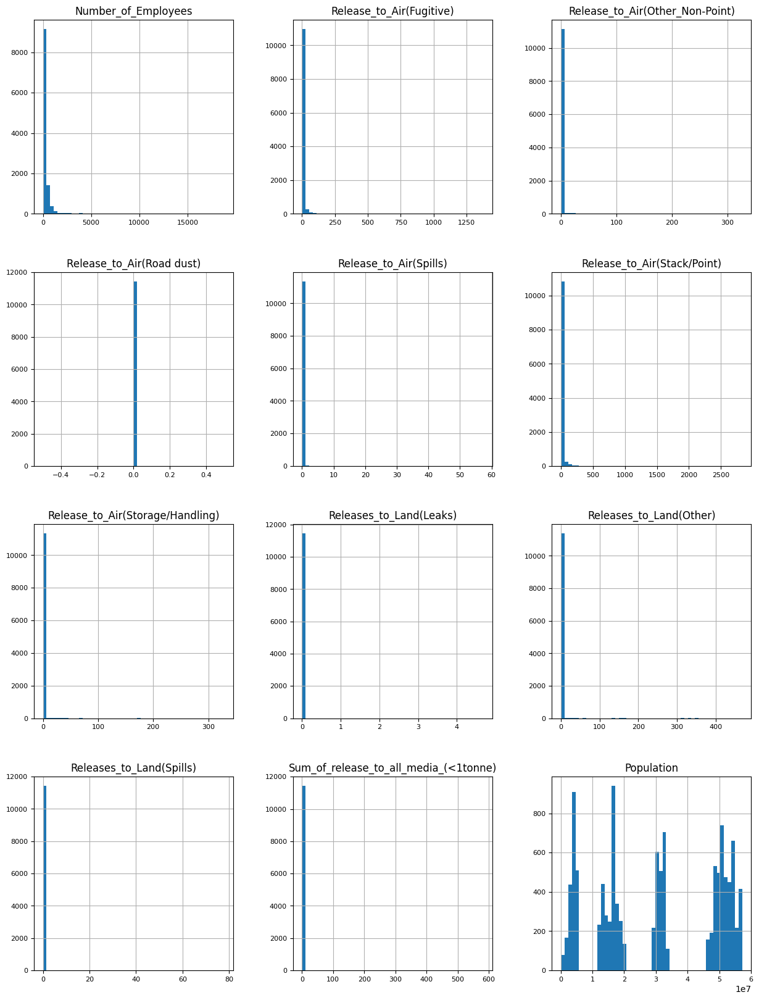

In [ ]:
#histogram plot of all the numerical columns
numerical_columns = [
    'Number_of_Employees',
    'Release_to_Air(Fugitive)', 'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
    'Release_to_Air(Spills)', 'Release_to_Air(Stack/Point)', 'Release_to_Air(Storage/Handling)',
    'Releases_to_Land(Leaks)', 'Releases_to_Land(Other)', 'Releases_to_Land(Spills)', 'Sum_of_release_to_all_media_(<1tonne)', 'Population']
X_train_ammonia_1[numerical_columns].hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8)

Based on the histogram distributions above, we choose the standard scalar for all the numerical columns as they are all normal distributions.





In [ ]:

#import category_encoders as ce

def create_preprocessor():
    """
    Creates a ColumnTransformer with preprocessing steps for numerical and categorical features.

    Returns:
        ColumnTransformer: Preprocessor that scales numerical features and encodes categorical features.
    """
    # Define numerical and categorical features
    numerical_features = ['Number_of_Employees', 'Release_to_Air(Stack/Point)',
        'Release_to_Air(Fugitive)', 'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
        'Release_to_Air(Spills)', 'Release_to_Air(Storage/Handling)', 'Releases_to_Land(Leaks)',
        'Releases_to_Land(Other)', 'Releases_to_Land(Spills)', 'Sum_of_release_to_all_media_(<1tonne)', 'Population'
    ]

    categorical_features1 = ['PROVINCE', 'Estimation_Method/Méthode_d’estimation']

    categorical_features2 = ["Company_Name/Dénomination_sociale_de_l'entreprise",
                             'Facility_Name/Installation', 'NAICS/Code_SCIAN',
                             'NAICS Title/Titre_Code_SCIAN', 'City']

    # Create transformers for numerical and categorical features
    numerical_transformer = Pipeline(steps=[('scaler', StandardScaler())])

    categorical_transformer1 = Pipeline(steps=[
        ('onehot', OneHotEncoder(sparse_output=False, handle_unknown='ignore'))
    ])

    # TargetEncoder
    categorical_transformer2 = Pipeline(steps=[
        ('target_encoder', ce.TargetEncoder(cols=categorical_features2))
    ])

    # Combine transformers using ColumnTransformer
    preprocessor = ColumnTransformer(
        transformers=[
            ('num', numerical_transformer, numerical_features),
            ('cat1', categorical_transformer1, categorical_features1),
            ('cat2', categorical_transformer2, categorical_features2)
        ]
    )

    return preprocessor


In [ ]:


def rf_pipeline(preprocessor):
    """
    Creates a pipeline with the given preprocessor and a regressor.

    Parameters:
        preprocessor (ColumnTransformer): The preprocessor to apply to the features.

    Returns:
        Pipeline: A pipeline that applies preprocessing followed by a regressor.
    """
    # Create the pipeline with preprocessor and regressor
    pipeline = Pipeline(steps=[
        ('preprocessor', preprocessor),
        ('regressor', RandomForestRegressor())
    ])

    return pipeline


### ML Model - No Feature Selection

We will train our model using all the features present in our dataset

In [ ]:
#Use this code each time to train and test on your initial model
# Step 1: Create the preprocessor
preprocessor = create_preprocessor()

# Step 2: Create the pipeline using the preprocessor
pipeline = rf_pipeline(preprocessor)

# Step 3: Fit the pipeline on the training data
pipeline.fit(X_train_ammonia_1, y_train_ammonia_1)

# Step 4: Predict and evaluate on the test data
y_pred_ammonia_1 = pipeline.predict(X_test_ammonia_1)

 # Evaluate the model's performance
rmse = np.sqrt(mean_squared_error(y_test_ammonia_1, y_pred_ammonia_1))
r2 = r2_score(y_test_ammonia_1, y_pred_ammonia_1)
mae = mean_absolute_error(y_test_ammonia_1, y_pred_ammonia_1)

# Print evaluation metrics
print(f"  RMSE: {rmse:.4f}")
print(f"  R-squared: {r2:.4f}")
print(f"  MAE: {mae:.4f}")
print("-" * 50)


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

  RMSE: 100234.4313
  R-squared: 0.9512
  MAE: 32728.3108
--------------------------------------------------


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Fitting other models

In [ ]:


def create_multiple_regressor_pipelines(X_train, y_train):
    """
    Creates multiple regression pipelines with different models: Linear Regression,
    Gradient Boosting, K-Nearest Neighbors, and Polynomial Regression.

    Parameters:
        X_train (pd.DataFrame): Training feature data.
        y_train (pd.Series): Training target data.

    Returns:
        dict: Dictionary with each model's pipeline.
    """
    # Define numerical and categorical features
    numerical_features = ['Number_of_Employees', 'Release_to_Air(Stack/Point)',
        'Release_to_Air(Fugitive)', 'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
        'Release_to_Air(Spills)', 'Release_to_Air(Storage/Handling)', 'Releases_to_Land(Leaks)',
        'Releases_to_Land(Other)', 'Releases_to_Land(Spills)', 'Sum_of_release_to_all_media_(<1tonne)', 'Population'
    ]

    categorical_features1 = ['PROVINCE', 'Estimation_Method/Méthode_d’estimation']

    categorical_features2 = ["Company_Name/Dénomination_sociale_de_l'entreprise",
                             'Facility_Name/Installation', 'NAICS/Code_SCIAN',
                             'NAICS Title/Titre_Code_SCIAN', 'City']

    # Create transformers for numerical and categorical features
    numerical_transformer = Pipeline(steps=[('scaler', StandardScaler())])

    categorical_transformer1 = Pipeline(steps=[
        ('onehot', OneHotEncoder(sparse_output=False, handle_unknown='ignore'))
    ])

    # TargetEncoder for categorical features 2
    categorical_transformer2 = Pipeline(steps=[
        ('target_encoder', ce.TargetEncoder(cols=categorical_features2))
    ])

    # Combine transformers using ColumnTransformer
    preprocessor = ColumnTransformer(
        transformers=[
            ('num', numerical_transformer, numerical_features),
            ('cat1', categorical_transformer1, categorical_features1),
            ('cat2', categorical_transformer2, categorical_features2)
        ]
    )

    # Create different models and pipelines
    models = {
        'Linear Regression': Pipeline(steps=[
            ('preprocessor', preprocessor),
            ('regressor', LinearRegression())
        ]),

        'Random Forest': Pipeline(steps=[
            ('preprocessor', preprocessor),
            ('regressor', RandomForestRegressor())
        ]),

        'Gradient Boosting': Pipeline(steps=[
            ('preprocessor', preprocessor),
            ('regressor', GradientBoostingRegressor())
        ]),

        'K-Nearest Neighbors': Pipeline(steps=[
            ('preprocessor', preprocessor),
            ('regressor', KNeighborsRegressor())
        ]),

        'Polynomial Regression': Pipeline(steps=[
            ('preprocessor', preprocessor),
            ('poly_features', PolynomialFeatures(degree=2, include_bias=False)),
            ('regressor', LinearRegression())
        ])
    }

    return models


In [ ]:
def train_and_evaluate_models(models, X_train, y_train, X_test, y_test):
    """
    Trains and evaluates each model in the provided models dictionary.

    Parameters:
        models (dict): Dictionary of model names and pipelines.
        X_train (pd.DataFrame): Training feature data.
        y_train (pd.Series): Training target data.
        X_test (pd.DataFrame): Test feature data.
        y_test (pd.Series): Test target data.

    Returns:
        None
    """
    # Loop through each model in the dictionary
    for model_name, pipeline in models.items():
        print(f"Training {model_name}...")
        pipeline.fit(X_train, y_train)  # Fit model on the training data

        # Predict with the trained model
        y_pred = pipeline.predict(X_test)

        # Evaluate the model's performance
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        r2 = r2_score(y_test, y_pred)
        mae = mean_absolute_error(y_test, y_pred)

        # Print evaluation metrics
        print(f"{model_name} Performance:")
        print(f"  RMSE: {rmse:.4f}")
        print(f"  R-squared: {r2:.4f}")
        print(f"  MAE: {mae:.4f}")
        print("-" * 50)


In [ ]:
# Step 1: Create the regressor pipelines
models_ammonia_1 = create_multiple_regressor_pipelines(X_train_ammonia_1, y_train_ammonia_1)

# Step 2: Train and evaluate models
train_and_evaluate_models(models_ammonia_1, X_train_ammonia_1, y_train_ammonia_1, X_test_ammonia_1, y_test_ammonia_1)


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





Training Linear Regression...


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Linear Regression Performance:
  RMSE: 302295.7890
  R-squared: 0.5564
  MAE: 106058.9829
--------------------------------------------------
Training Random Forest...


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Random Forest Performance:
  RMSE: 96276.7839
  R-squared: 0.9550
  MAE: 32966.9194
--------------------------------------------------
Training Gradient Boosting...


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Gradient Boosting Performance:
  RMSE: 114091.4486
  R-squared: 0.9368
  MAE: 41652.3144
--------------------------------------------------
Training K-Nearest Neighbors...
K-Nearest Neighbors Performance:
  RMSE: 187939.3789
  R-squared: 0.8285
  MAE: 36114.8395
--------------------------------------------------
Training Polynomial Regression...


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Polynomial Regression Performance:
  RMSE: 11761990.7342
  R-squared: -670.5497
  MAE: 415450.1535
--------------------------------------------------


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

In [ ]:
# Calculate the average ammonia release in the training data
average_ammonia_release = y_train_ammonia_1.mean()

# Create a baseline prediction array filled with the average
baseline_predictions = np.full(len(X_test_ammonia_1), average_ammonia_release)

# Calculate RMSE for the baseline model
baseline_rmse = np.sqrt(skMetrics.mean_squared_error(y_test_ammonia_1, baseline_predictions))
print(f"Baseline RMSE: {baseline_rmse}")

Baseline RMSE: 453887.89162866765


## **Cross Validataion of the models**

In [ ]:


def cross_validate_models(models, X_train, y_train, preprocessor, num_folds=5):
    """
    Performs cross-validation for multiple models and stores the results.

    Parameters:
        models (list): A list of tuples where each tuple contains a model's name and the model itself.
        X_train (pd.DataFrame): Training feature data.
        y_train (pd.Series): Training target data.
        preprocessor (sklearn ColumnTransformer or similar): Preprocessing pipeline.
        num_folds (int): Number of folds for cross-validation (default is 5).

    Returns:
        results (dict): A dictionary containing cross-validation results for each model.
        best_model_name (str): The name of the model with the best RMSE.
        best_model_pipeline (sklearn.pipeline.Pipeline): The pipeline of the best model.
    """
    # Initialize dictionaries to store results
    results = {}
    scoring = {
        'neg_root_mean_squared_error': 'neg_root_mean_squared_error',
        'r2': make_scorer(r2_score)
    }

    # Perform cross-validation for each model and store results
    for name, model in models:
        print(f"Cross-validating {name}...")

        # Create a pipeline for the current model
        pipeline = Pipeline(steps=[
            ('preprocessor', preprocessor),
            ('regressor', model)
        ])

        # Create a KFold object
        kfold = KFold(n_splits=num_folds, shuffle=True)

        # Perform cross-validation
        cv_results = cross_validate(pipeline, X_train, y_train, cv=kfold, scoring=scoring, n_jobs=-1)

        # Store the mean RMSE and R2 scores for the current model
        avg_rmse = -np.mean(cv_results['test_neg_root_mean_squared_error'])  # Negate to make RMSE positive
        avg_r2 = np.mean(cv_results['test_r2'])

        # Save results in a dictionary
        results[name] = {
            'pipeline': pipeline,
            'rmse': avg_rmse,
            'r2': avg_r2,
            'std_rmse': np.std(-cv_results['test_neg_root_mean_squared_error']),
            'std_r2': np.std(cv_results['test_r2']),
        }

        # Print results for the current model
        print(f"{name}: RMSE: {avg_rmse:.4f} (std: {np.std(-cv_results['test_neg_root_mean_squared_error']):.4f}), "
              f"R2: {avg_r2:.4f} (std: {np.std(cv_results['test_r2']):.4f})")
        print("-" * 50)

    # Identify the best model based on RMSE
    best_model_name = min(results, key=lambda x: results[x]['rmse'])
    best_model_pipeline = results[best_model_name]['pipeline']

    # Print the best model details
    print(f"Best Model: {best_model_name}")
    print(f"  RMSE: {results[best_model_name]['rmse']:.4f}")
    print(f"  R2: {results[best_model_name]['r2']:.4f}")

    return results, best_model_name, best_model_pipeline


In [ ]:

# Assuming you have your models list, training data, and preprocessor ready
models = [
    ('RandomForest', RandomForestRegressor(random_state=42)),
    ('LinearRegression', LinearRegression()),
    ('GradientBoosting', GradientBoostingRegressor(random_state=42)),
    ('KNN', KNeighborsRegressor()),
    ('PolynomialRegression', make_pipeline(PolynomialFeatures(degree=2), LinearRegression()))
]

# Perform cross-validation and get the results
results, best_model_name, best_model_pipeline = cross_validate_models(models, X_train_ammonia_1, y_train_ammonia_1, preprocessor)


Cross-validating RandomForest...
RandomForest: RMSE: 85208.0000 (std: 14538.3040), R2: 0.9510 (std: 0.0129)
--------------------------------------------------
Cross-validating LinearRegression...
LinearRegression: RMSE: 302157.2084 (std: 71631.6815), R2: 0.3414 (std: 0.3507)
--------------------------------------------------
Cross-validating GradientBoosting...
GradientBoosting: RMSE: 96624.4046 (std: 8316.0548), R2: 0.9352 (std: 0.0163)
--------------------------------------------------
Cross-validating KNN...
KNN: RMSE: 167336.5909 (std: 35078.5891), R2: 0.8110 (std: 0.0634)
--------------------------------------------------
Cross-validating PolynomialRegression...
PolynomialRegression: RMSE: 451953133.6284 (std: 517444341.3613), R2: -3122856.6788 (std: 4532210.6927)
--------------------------------------------------
Best Model: RandomForest
  RMSE: 85208.0000
  R2: 0.9510


Random Forest performs best after cross validation, so we will train it on the entire training set

In [ ]:
# Train the best model on the full training data
best_model_pipeline.fit(X_train_ammonia_1, y_train_ammonia_1)

# Predict on the test dataset
y_pred_ammonia_1 = best_model_pipeline.predict(X_test_ammonia_1)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test_ammonia_1, y_pred_ammonia_1))
r2 = r2_score(y_test_ammonia_1, y_pred_ammonia_1)
mae = mean_absolute_error(y_test_ammonia_1, y_pred_ammonia_1)

print(f"RMSE on test data: {rmse:.4f}")
print(f"R² score on test data: {r2:.4f}")
print(f"MAE on test data: {mae:.4f}")


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

RMSE on test data: 100949.1799
R² score on test data: 0.9505
MAE on test data: 33267.0025


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

## ML Model - Feature Selection

We will use a copy of the ammonia dataframe to perform the feature selection steps. For feature selection we will use the P-value and Pearson Correlation methods. We will then fit, train and evaluate the model using the selected features.

### Feature Selection By P-value

Get copy of encoded and cleaned dataframes
Run p-value code to select best features

In [ ]:
# copy of the train and test sets
train_ammonia_2 = train_ammonia.copy()
test_ammonia_2 = test_ammonia.copy()

# Extract the target variable before dropping it from the features
y_train_ammonia_2 = train_ammonia_2['Total_Release_to_Water']
y_test_ammonia_2 = test_ammonia_2['Total_Release_to_Water']

# Now drop the target variable from the feature sets
X_train_ammonia_2 = train_ammonia_2.drop(['Total_Release_to_Water'], axis = 1)
X_test_ammonia_2 = test_ammonia_2.drop(['Total_Release_to_Water'], axis = 1)

In [ ]:
def create_and_evaluate_pipeline(X_train, y_train, X_test, y_test):
    """
    Creates and evaluates a machine learning pipeline for regression.

    Parameters:
        X_train (pd.DataFrame): Training feature data.
        y_train (pd.Series): Training target data.
        X_test (pd.DataFrame): Test feature data.
        y_test (pd.Series): Test target data.

    Returns:
        pd.DataFrame, pd.DataFrame: Transformed training and test feature data.
    """
    # Define numerical and categorical features
    numerical_features = ['Number_of_Employees',
        'Release_to_Air(Fugitive)', 'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
        'Release_to_Air(Spills)', 'Release_to_Air(Storage/Handling)', 'Release_to_Air(Stack/Point)', 'Releases_to_Land(Leaks)',
        'Releases_to_Land(Other)', 'Releases_to_Land(Spills)', 'Sum_of_release_to_all_media_(<1tonne)', 'Population'
    ]


    categorical_features1 = ['PROVINCE', 'Estimation_Method/Méthode_d’estimation']

    categorical_features2 = ["Company_Name/Dénomination_sociale_de_l'entreprise",
                             'Facility_Name/Installation', 'NAICS/Code_SCIAN',
                             'NAICS Title/Titre_Code_SCIAN', 'City']

    # Create transformers for numerical and categorical features
    numerical_transformer = Pipeline(steps=[('scaler', StandardScaler())])


    categorical_transformer1 = Pipeline(steps=[
        ('onehot', OneHotEncoder(sparse_output=False, handle_unknown='ignore'))
    ])

     # TargetEncoder
    categorical_transformer2 = Pipeline(steps=[
        ('target_encoder', ce.TargetEncoder(cols=categorical_features2))
    ])


    # Combine transformers using ColumnTransformer
    preprocessor = ColumnTransformer(
        transformers=[
            ('num', numerical_transformer, numerical_features),
            ('cat1', categorical_transformer1, categorical_features1),
            ('cat2', categorical_transformer2, categorical_features2)
        ]
    )

    # Fit the preprocessor on the training data
    preprocessor.fit(X_train, y_train)

    # Transform both training and test data
    X_train_transformed = preprocessor.transform(X_train)
    X_test_transformed = preprocessor.transform(X_test)

    # Get feature names after transformation
    feature_names = preprocessor.get_feature_names_out()

    # Convert transformed data to DataFrame with the appropriate feature names
    X_train_encoded = pd.DataFrame(X_train_transformed, columns=feature_names)
    X_test_encoded = pd.DataFrame(X_test_transformed, columns=feature_names)

    # Return the processed feature matrices as pandas DataFrames
    return X_train_encoded, X_test_encoded


In [ ]:
X_train_encoded_ammonia, X_test_encoded_ammonia = create_and_evaluate_pipeline(X_train_ammonia_2, y_train_ammonia_2, X_test_ammonia_2, y_test_ammonia_2)


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

In [ ]:
# Load feature dataset (X) and target (y)
X = X_train_encoded_ammonia[['num__Number_of_Employees', 'num__Release_to_Air(Stack/Point)',
       'num__Release_to_Air(Fugitive)', 'num__Release_to_Air(Other_Non-Point)',
       'num__Release_to_Air(Road dust)', 'num__Release_to_Air(Spills)',
       'num__Release_to_Air(Storage/Handling)', 'num__Releases_to_Land(Leaks)',
       'num__Releases_to_Land(Other)', 'num__Releases_to_Land(Spills)',
       'num__Sum_of_release_to_all_media_(<1tonne)', 'num__Population',
       'cat1__PROVINCE_AB', 'cat1__PROVINCE_BC', 'cat1__PROVINCE_MB',
       'cat1__PROVINCE_NB', 'cat1__PROVINCE_NL', 'cat1__PROVINCE_NS',
       'cat1__PROVINCE_NT', 'cat1__PROVINCE_NU', 'cat1__PROVINCE_ON',
       'cat1__PROVINCE_PE', 'cat1__PROVINCE_QC', 'cat1__PROVINCE_SK',
       'cat1__PROVINCE_YT',
       'cat1__Estimation_Method/Méthode_d’estimation_(blank)',
       'cat1__Estimation_Method/Méthode_d’estimation_C - Mass Balance',
       'cat1__Estimation_Method/Méthode_d’estimation_E - Emission Factor',
       'cat1__Estimation_Method/Méthode_d’estimation_E1 - Site Specific Emission Factors',
       'cat1__Estimation_Method/Méthode_d’estimation_E2 - Published Emission Factors',
       'cat1__Estimation_Method/Méthode_d’estimation_M - Monitoring or Direct Measurement',
       'cat1__Estimation_Method/Méthode_d’estimation_M1 - Continuous Emission Monitoring',
       'cat1__Estimation_Method/Méthode_d’estimation_M2 - Predictive Emission Monitoring',
       'cat1__Estimation_Method/Méthode_d’estimation_M3 - Source Testing',
       'cat1__Estimation_Method/Méthode_d’estimation_NI - No Information Available',
       'cat1__Estimation_Method/Méthode_d’estimation_O - Engineering Estimates',
       "cat2__Company_Name/Dénomination_sociale_de_l'entreprise",
       'cat2__Facility_Name/Installation', 'cat2__NAICS/Code_SCIAN',
       'cat2__NAICS Title/Titre_Code_SCIAN', 'cat2__City']]

y = train_ammonia_2['Total_Release_to_Water']





In [ ]:


def backwardElimination(X, y, sl, columns):
    """
    Perform backward elimination on a dataset to select significant features.

    Parameters:
        X (np.array or pd.DataFrame): Independent variables (features).
        y (np.array or pd.Series): Dependent variable (target).
        sl (float): Significance level for removing features.
        columns (list): List of column names corresponding to features in X.

    Returns:
        np.array: Reduced feature matrix.
        list: Updated list of column names.
    """
    numVars = X.shape[1]  # Number of features
    for i in range(numVars):
        regressor_OLS = sm.OLS(y, X).fit()  # Fit OLS model
        maxVar = max(regressor_OLS.pvalues).astype(float)  # Maximum p-value
        if maxVar > sl:
            for j in range(X.shape[1]):  # Loop through features
                if regressor_OLS.pvalues[j].astype(float) == maxVar:
                    X = np.delete(X, j, 1)  # Remove feature
                    columns.pop(j)  # Remove column name
                    break  # Exit loop once feature is removed
        else:
            break  # Stop if all p-values are below threshold
    print(regressor_OLS.summary())  # Print final model summary
    return X, columns


In [ ]:
SL = 0.05

selected_columns = X.columns.tolist()


data_modeled_ammonia, selected_columns = backwardElimination(X.values, y.values, SL, selected_columns)

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.591
Model:                            OLS   Adj. R-squared (uncentered):              0.590
Method:                 Least Squares   F-statistic:                              659.7
Date:                Thu, 12 Dec 2024   Prob (F-statistic):                        0.00
Time:                        03:01:06   Log-Likelihood:                     -1.5869e+05
No. Observations:               11446   AIC:                                  3.174e+05
Df Residuals:                   11421   BIC:                                  3.176e+05
Df Model:                          25                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [ ]:

# Select the columns in the original X dataset that were selected
X_train_ammonia_selected1 = X_train_encoded_ammonia[selected_columns]
X_test_ammonia_selected1 = X_test_encoded_ammonia[selected_columns]

Fit and train the data with models

In [ ]:


def fit_and_evaluate_models(models, X_train, y_train, X_test, y_test):
    """
    Fits and evaluates multiple models.

    Parameters:
        models (list): A list of models to evaluate.
        X_train (pd.DataFrame): Training feature data.
        y_train (pd.Series): Training target data.
        X_test (pd.DataFrame): Test feature data.
        y_test (pd.Series): Test target data.

    Returns:
        dict: A dictionary with evaluation metrics (RMSE and R²) for each model.
    """
    results = {}

    for name, model in models:
        # Fit the model
        model.fit(X_train, y_train)

        # Step 3: Make predictions on the test data
        y_pred = model.predict(X_test)

        # Evaluate the model
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        r2 = r2_score(y_test, y_pred)

        # Store the results
        results[name] = {"rmse": rmse, "r2": r2}

    return results

def display_results(results):
    """Displays the evaluation results for each model."""
    for name, metrics in results.items():
        print(f'Model: {name}')
        print(f'Root Mean Squared Error: {metrics["rmse"]}')
        print(f'R^2 Score: {metrics["r2"]}')
        print('---')  # separator between model results





In [ ]:
train_and_evaluate_models

# Define the models to evaluate
models = [
    ('Linear Regression', LinearRegression()),
    ('Random Forest', RandomForestRegressor()),
    ('Gradient Boosting', GradientBoostingRegressor()),
    ('KNN', KNeighborsRegressor()),
    ('Polynomial Regression', make_pipeline(PolynomialFeatures(degree=2), LinearRegression()))
]

# Fit and evaluate the models
results = fit_and_evaluate_models(models, X_train_ammonia_selected1, y_train_ammonia_2, X_test_ammonia_selected1, y_test_ammonia_2)

# Display the results
display_results(results)

Model: Linear Regression
Root Mean Squared Error: 302058.1551336645
R^2 Score: 0.5571081850303974
---
Model: Random Forest
Root Mean Squared Error: 101662.35376783044
R^2 Score: 0.9498308382893836
---
Model: Gradient Boosting
Root Mean Squared Error: 123505.02939917229
R^2 Score: 0.9259566925782641
---
Model: KNN
Root Mean Squared Error: 119333.08966328787
R^2 Score: 0.9308744987745347
---
Model: Polynomial Regression
Root Mean Squared Error: 154338.11174280784
R^2 Score: 0.8843720334302875
---


Performing cross validation on the selected features train set

In [ ]:
def evaluate_models_with_cv(X_train, y_train, models, num_folds=5):
    """
    Evaluates multiple models using k-fold cross-validation and returns the best model based on R² score.

    Parameters:
        X_train (pd.DataFrame): Training feature data.
        y_train (pd.Series): Training target data.
        models (list): List of tuples where each tuple is (model_name, model_instance).
        num_folds (int): The number of folds for k-fold cross-validation (default is 5).

    Returns:
        best_model (sklearn.model): The best model based on R² score.
        best_model_name (str): Name of the best model.
        best_metrics (dict): Metrics (RMSE, R², MSE, MAE) for the best model.
    """
    # Initialize variables to track the best model
    best_model = None
    best_model_name = None
    best_r2 = float('-inf')  # Initialize with the lowest possible R²
    best_rmse = float('inf')  # Initialize with the highest possible RMSE
    best_metrics = {}

    # Define a scoring dictionary
    scoring = {
        'neg_root_mean_squared_error': 'neg_root_mean_squared_error',
        'r2': make_scorer(r2_score),
        'neg_mean_squared_error': 'neg_mean_squared_error',
        'neg_mean_absolute_error': 'neg_mean_absolute_error',
    }

    # Iterate through the models
    for name, model in models:
        # Create a KFold object
        kfold = KFold(n_splits=num_folds, shuffle=True)

        # Perform cross-validation
        cv_results = cross_validate(model, X_train, y_train, cv=kfold, scoring=scoring)

        # Extract and negate scores for metrics
        rmse_scores = -cv_results['test_neg_root_mean_squared_error']
        r2_scores = cv_results['test_r2']
        mse_scores = -cv_results['test_neg_mean_squared_error']
        mae_scores = -cv_results['test_neg_mean_absolute_error']

        # Calculate average scores
        avg_rmse = np.mean(rmse_scores)
        avg_r2 = np.mean(r2_scores)
        avg_mse = np.mean(mse_scores)
        avg_mae = np.mean(mae_scores)

        # Check if the current model is the best based on R²
        if avg_rmse < best_rmse:
            best_rmse = avg_rmse
            best_model = model
            best_model_name = name
            best_metrics = {
                'RMSE': avg_rmse,
                'R2': avg_r2,
                'MSE': avg_mse,
                'MAE': avg_mae
            }

    # Retrain the best model on the entire training dataset
    best_model.fit(X_train, y_train)

    return best_model, best_model_name, best_metrics


In [ ]:

# Define the models to evaluate
models = [
    ("Decision Tree", DecisionTreeRegressor()),
    ("K-Nearest Neighbors (KNN)", KNeighborsRegressor()),
    ("Random Forest", RandomForestRegressor()),
    ("Gradient Boosting", GradientBoostingRegressor()),
    ("Linear Regression", LinearRegression()),
    ("Polynomial Regression (degree 2)", Pipeline([
        ('poly_features', PolynomialFeatures(degree=2)),
        ('scaler', StandardScaler()),
        ('linear_regression', LinearRegression())
    ]))
]


best_model, best_model_name, best_metrics = evaluate_models_with_cv(
    X_train_ammonia_selected1, y_train_ammonia_2, models, num_folds=5)

# Print the results
print(f"Best Model: {best_model_name}")
print(f"Metrics for Best Model:")
print(f"  RMSE: {best_metrics['RMSE']:.4f}")
print(f"  R²: {best_metrics['R2']:.4f}")
print(f"  MSE: {best_metrics['MSE']:.4f}")
print(f"  MAE: {best_metrics['MAE']:.4f}")


Best Model: Random Forest
Metrics for Best Model:
  RMSE: 92404.6524
  R²: 0.9430
  MSE: 8993252713.9248
  MAE: 16805.7864


In [ ]:
# Train the best model on the full training data
best_model.fit(X_train_ammonia_selected1, y_train_ammonia_2)

# Predict on the test dataset
y_pred_ammonia_2 = best_model.predict(X_test_ammonia_selected1)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test_ammonia_2, y_pred_ammonia_2))
r2 = r2_score(y_test_ammonia_2, y_pred_ammonia_2)
mae = mean_absolute_error(y_test_ammonia_2, y_pred_ammonia_2)

print(f"RMSE on test data: {rmse:.4f}")
print(f"R² score on test data: {r2:.4f}")
print(f"MAE on test data: {mae:.4f}")


RMSE on test data: 94152.9248
R² score on test data: 0.9570
MAE on test data: 33348.5599


### Feature Selection by Pearson Correlation

In [ ]:
# copy of the train and test sets
train_ammonia_3 = train_ammonia.copy()
test_ammonia_3 = test_ammonia.copy()

# Extract the target variable before dropping it from the features
y_train_ammonia_3 = train_ammonia_3['Total_Release_to_Water']
y_test_ammonia_3 = test_ammonia_3['Total_Release_to_Water']

# Now drop the target variable from the feature sets
X_train_ammonia_3 = train_ammonia_3.drop(['Total_Release_to_Water'], axis = 1)
X_test_ammonia_3 = test_ammonia_3.drop(['Total_Release_to_Water'], axis = 1)

In [ ]:
X_train_encoded_ammonia3, X_test_encoded_ammonia3 = create_and_evaluate_pipeline(X_train_ammonia_3, y_train_ammonia_3, X_test_ammonia_3, y_test_ammonia_3)


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

In [ ]:
# 2. Correlation
def correlation(dataset, cor):
    df = dataset.copy()
    col_corr = set()  # For storing unique value
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > cor: # absolute values to handle positive and negative correlations
                colname = corr_matrix.columns[i]
                col_corr.add(colname)
    df.drop(col_corr,axis = 1,inplace = True)
    return df

# Apply the correlation function to remove highly correlated features
X_train_ammonia_filtered3 = correlation(X_train_encoded_ammonia3, cor=0.8)


In [ ]:
X_train_ammonia_filtered3.columns

Index(['num__Number_of_Employees', 'num__Release_to_Air(Fugitive)',
       'num__Release_to_Air(Other_Non-Point)',
       'num__Release_to_Air(Road dust)', 'num__Release_to_Air(Spills)',
       'num__Release_to_Air(Storage/Handling)',
       'num__Release_to_Air(Stack/Point)', 'num__Releases_to_Land(Leaks)',
       'num__Releases_to_Land(Other)', 'num__Releases_to_Land(Spills)',
       'num__Sum_of_release_to_all_media_(<1tonne)', 'num__Population',
       'cat1__PROVINCE_AB', 'cat1__PROVINCE_BC', 'cat1__PROVINCE_MB',
       'cat1__PROVINCE_NB', 'cat1__PROVINCE_NL', 'cat1__PROVINCE_NS',
       'cat1__PROVINCE_NT', 'cat1__PROVINCE_NU', 'cat1__PROVINCE_PE',
       'cat1__PROVINCE_QC', 'cat1__PROVINCE_SK', 'cat1__PROVINCE_YT',
       'cat1__Estimation_Method/Méthode_d’estimation_(blank)',
       'cat1__Estimation_Method/Méthode_d’estimation_C - Mass Balance',
       'cat1__Estimation_Method/Méthode_d’estimation_E - Emission Factor',
       'cat1__Estimation_Method/Méthode_d’estimation_E1 

In [ ]:
# Ensure validation and test sets have the same columns
X_val_ammonia_corr = X_train_encoded_ammonia3[X_train_ammonia_filtered3.columns]
X_test_ammonia_filtered3 = X_test_encoded_ammonia3[X_train_ammonia_filtered3.columns]


Fit and train and predict using different models

In [ ]:
# Define the models to evaluate
models = [
    ('Linear Regression', LinearRegression()),
    ('Random Forest', RandomForestRegressor()),
    ('Gradient Boosting', GradientBoostingRegressor()),
    ('KNN', KNeighborsRegressor()),
    ('Polynomial Regression', make_pipeline(PolynomialFeatures(degree=2), LinearRegression()))
]

# Fit and evaluate the models
results = fit_and_evaluate_models(models, X_val_ammonia_corr, y_train_ammonia_3, X_test_ammonia_filtered3, y_test_ammonia_3)

# Display the results
display_results(results)

Model: Linear Regression
Root Mean Squared Error: 302307.87256232864
R^2 Score: 0.5563755875486042
---
Model: Random Forest
Root Mean Squared Error: 103402.72397746313
R^2 Score: 0.9480984315247246
---
Model: Gradient Boosting
Root Mean Squared Error: 116385.94902739869
R^2 Score: 0.9342466888432814
---
Model: KNN
Root Mean Squared Error: 188108.23728956594
R^2 Score: 0.8282359978611229
---
Model: Polynomial Regression
Root Mean Squared Error: 11547122.796291951
R^2 Score: -646.2381258807653
---


Performing cross validation

In [ ]:

# Define the models to evaluate
models = [
    ("Decision Tree", DecisionTreeRegressor()),
    ("K-Nearest Neighbors (KNN)", KNeighborsRegressor()),
    ("Random Forest", RandomForestRegressor()),
    ("Gradient Boosting", GradientBoostingRegressor()),
    ("Linear Regression", LinearRegression()),
    ("Polynomial Regression (degree 2)", Pipeline([
        ('poly_features', PolynomialFeatures(degree=2)),
        ('scaler', StandardScaler()),
        ('linear_regression', LinearRegression())
    ]))
]


best_model_amcorr, best_model_name, best_metrics = evaluate_models_with_cv(
    X_val_ammonia_corr, y_train_ammonia_3, models, num_folds=5)

# Print the results
print(f"Best Model: {best_model_name}")
print(f"Metrics for Best Model:")
print(f"  RMSE: {best_metrics['RMSE']:.4f}")
print(f"  R²: {best_metrics['R2']:.4f}")
print(f"  MSE: {best_metrics['MSE']:.4f}")
print(f"  MAE: {best_metrics['MAE']:.4f}")


Best Model: Decision Tree
Metrics for Best Model:
  RMSE: 87754.1138
  R²: 0.9479
  MSE: 7885738347.3485
  MAE: 16866.2067


In [ ]:
# Train the best model on the full training data

best_model_amcorr.fit(X_val_ammonia_corr, y_train_ammonia_3)

# Predict on the test dataset
y_pred_ammonia_3 = best_model_amcorr.predict(X_test_ammonia_filtered3)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test_ammonia_3, y_pred_ammonia_3))
r2 = r2_score(y_test_ammonia_3, y_pred_ammonia_3)
mae = mean_absolute_error(y_test_ammonia_3, y_pred_ammonia_3)

print(f"RMSE on test data: {rmse:.4f}")
print(f"R² score on test data: {r2:.4f}")
print(f"MAE on test data: {mae:.4f}")


RMSE on test data: 90018.3843
R² score on test data: 0.9607
MAE on test data: 29568.2946


## Results - Ammonia


Showing the metrics obtained from the three models

RMSE values on test data using the model that performed best during cross validation


1.   Without FS:

*   RMSE: 75,304.2081
*   R2: 0.9617



  
  
2.   With p-value FS: Best Model:

*    RMSE: 86966.9714
*    R²: 0.9468




3.   With Pearson corr FS:
  

*   RMSE: 77,167.4823
*    R²: 0.9598




The model with no feature selection performed best




# **Phosphorus Dataframe**


We will perform the same steps we performed on the ammonia dataframe on the phosphorus dataframe

In [ ]:
df_NPRI_phosphorus

,Reporting_Year/Année,NPRI_ID/No_INRP,Number_of_Employees,Company_Name/Dénomination_sociale_de_l'entreprise,Facility_Name/Installation,NAICS/Code_SCIAN,NAICS Title/Titre_Code_SCIAN,PROVINCE,City,Latitude,Longitude,CAS_Number/No_CAS,Substance_Name_(English)/Nom_de_substance_(Anglais),Units/Unités,Estimation_Method/Méthode_d’estimation,Release_to_Air(Fugitive),Release_to_Air(Other_Non-Point),Release_to_Air(Road dust),Release_to_Air(Spills),Release_to_Air(Stack/Point),Release_to_Air(Storage/Handling),Releases_to_Land(Leaks),Releases_to_Land(Other),Releases_to_Land(Spills),Releases_ to_Water_Bodies(Direct Discharges),Releases_ to_Water_Bodies(Leaks),Releases_ to_Water_Bodies(Spills),Sum_of_release_to_all_media_(<1tonne)
0,2003,1,440.0,ALBERTA PACIFIC FOREST INDUSTRIES,ALBERTA PACIFIC FOREST INDUSTRIES,322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,NA - 22,Phosphorus (total),kg,M3 - Source Testing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32860.0,NaN,NaN,NaN
1,2003,4,400.0,TEMBEC INDUSTRIES,PINE FALLS OPERATIONS,322122,Newsprint mills,MB,PINE FALLS,50.568600,-96.226700,NA - 22,Phosphorus (total),kg,M3 - Source Testing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,43970.0,NaN,NaN,NaN
2,2003,159,68.0,Bunge Canada,ALTONA PLANT,311224,Oilseed processing,MB,Altona,49.111480,-97.560100,NA - 22,Phosphorus (total),kg,O - Engineering Estimates,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.090000
3,2003,161,93.0,Bunge Canada,HAMILTON PLANT,311224,Oilseed processing,ON,Hamilton,43.270220,-79.849490,NA - 22,Phosphorus (total),kg,M3 - Source Testing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.082000
4,2003,163,68.0,Bunge Canada,NIPAWIN PLANT,311224,Oilseed processing,SK,Nipawin,53.325200,-104.027000,NA - 22,Phosphorus (total),kg,O - Engineering Estimates,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.700000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8026,2022,33819,300.0,Puregold Mine Inc,Puregold Mine,212220,Gold and silver ore mining,ON,Madsen,50.967640,-93.918020,NA - 22,Phosphorus (total),kg,E2 - Published Emission Factors,0.0454,NaN,NaN,NaN,0.000016,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8027,2022,33819,300.0,Puregold Mine Inc,Puregold Mine,212220,Gold and silver ore mining,ON,Madsen,50.967640,-93.918020,NA - 22,Phosphorus (total),kg,M3 - Source Testing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.1,NaN,NaN,NaN
8028,2022,33822,87.0,Premier Tech Home & Garden.,Richer,325314,Mixed fertilizer manufacturing,MB,Richer,49.607300,-96.481500,NA - 22,Phosphorus (total),kg,E2 - Published Emission Factors,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.008102
8029,2022,33823,74.0,Premier Tech Home & Garden.,Rexton,325314,Mixed fertilizer manufacturing,NB,Rexton,46.638580,-64.918472,NA - 22,Phosphorus (total),kg,E2 - Published Emission Factors,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.001223


In [ ]:
df_NPRI_phosphorus['Reporting_Year/Année'].unique()

[2003, 2004, 2005, 2006, 2007, ..., 2018, 2019, 2020, 2021, 2022]
Length: 20
Categories (23, int64): [2000, 2001, 2002, 2003, ..., 2019, 2020, 2021, 2022]

# Feature Engineering and Preprocessing

In [ ]:
df_NPRI_phosphorus1 = split_data(df = df_NPRI_phosphorus, year_column = 'Reporting_Year/Année', split_year = 2020)

# Unpack the tuple into train_data and test_data
train_data, test_data = df_NPRI_phosphorus1

train_data

train_phosphorus = train_data
test_phosphorus = test_data

train_phosphorus.shape, test_phosphorus.shape

((7111, 28), (920, 28))

In [ ]:
train_phosphorus = fill_missing_coordinates(train_phosphorus, 'Facility_Name/Installation', 'Latitude', 'Longitude')
test_phosphorus = fill_missing_coordinates(test_phosphorus, 'Facility_Name/Installation', 'Latitude', 'Longitude')

In [ ]:
train_phosphorus = train_phosphorus.dropna(subset=['Latitude', 'Longitude'])
test_phosphorus = test_phosphorus.dropna(subset=['Latitude', 'Longitude'])

In [ ]:
# drop the rows with missing facility name
train_phosphorus = train_phosphorus.dropna(subset=['Facility_Name/Installation'])


In [ ]:
train_phosphorus = fill_missing_cities(train_phosphorus, 'Facility_Name/Installation', 'City')
test_phosphorus = fill_missing_cities(test_phosphorus, 'Facility_Name/Installation', 'City')

In [ ]:
train_phosphorus = fill_missing_numeric_with_median(train_phosphorus, 'Number_of_Employees')


In [ ]:
columns = ['Release_to_Air(Fugitive)',
       'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
       'Release_to_Air(Spills)', 'Release_to_Air(Stack/Point)',
       'Release_to_Air(Storage/Handling)', 'Releases_to_Land(Leaks)',
       'Releases_to_Land(Other)', 'Releases_to_Land(Spills)',
       'Releases_ to_Water_Bodies(Direct Discharges)',
       'Releases_ to_Water_Bodies(Leaks)', 'Releases_ to_Water_Bodies(Spills)',
       'Sum_of_release_to_all_media_(<1tonne)']
for column in columns:
  train_phosphorus = fill_missing_with_zeros(train_phosphorus, [column])
  test_phosphorus = fill_missing_with_zeros(test_phosphorus, [column])


In [ ]:
train_phosphorus.shape, test_phosphorus.shape

((7093, 28), (916, 28))

Merge population dataset with the phosphorus dataframe

In [ ]:

# Merging the train dataset with the population dataset
train_phosphorus = merge_datasets(train_phosphorus, df_population, merge_columns=['Reporting_Year/Année', 'PROVINCE'])

# Merging the test dataset with the population dataset
test_phosphorus = merge_datasets(test_phosphorus, df_population, merge_columns=['Reporting_Year/Année', 'PROVINCE'])

train_phosphorus.shape, test_phosphorus.shape

((7093, 29), (916, 29))

In [ ]:
# Adding Up all the Releases to Water Bodies

Release_to_Water_columns = [
    'Releases_ to_Water_Bodies(Direct Discharges)',
    'Releases_ to_Water_Bodies(Leaks)',
    'Releases_ to_Water_Bodies(Spills)'
]

# Sum the specified release to water bodies columns and create a new column 'Total_Releases_to_Water'
train_phosphorus['Total_Release_to_Water'] = train_phosphorus[Release_to_Water_columns].sum(axis=1)

# Sum the specified release to water bodies columns and create a new column 'Total_Releases_to_Water'
test_phosphorus['Total_Release_to_Water'] = test_phosphorus[Release_to_Water_columns].sum(axis=1)

#drop the release to water columns
train_phosphorus = train_phosphorus.drop(['Releases_ to_Water_Bodies(Direct Discharges)', 'Releases_ to_Water_Bodies(Leaks)', 'Releases_ to_Water_Bodies(Spills)'], axis = 1)

#drop the release to water columns
test_phosphorus = test_phosphorus.drop(['Releases_ to_Water_Bodies(Direct Discharges)', 'Releases_ to_Water_Bodies(Leaks)', 'Releases_ to_Water_Bodies(Spills)'], axis = 1)


In [ ]:
#K means clustering on latitude and longitude
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=5, random_state=42)
train_phosphorus['Region'] = kmeans.fit_predict(train_phosphorus[['Latitude', 'Longitude']])
test_phosphorus['Region'] = kmeans.fit_predict(test_phosphorus[['Latitude', 'Longitude']])

In [ ]:
#drop substance and unit columns
train_phosphorus = train_phosphorus.drop(['Substance_Name_(English)/Nom_de_substance_(Anglais)', 'Units/Unités'], axis = 1)
test_phosphorus = test_phosphorus.drop(['Substance_Name_(English)/Nom_de_substance_(Anglais)', 'Units/Unités'], axis = 1)

In [ ]:
train_phosphorus.shape, test_phosphorus.shape

((7093, 26), (916, 26))

In [ ]:
# copy of the train and test sets
train_phosphorus_1 = train_phosphorus.copy()
test_phosphorus_1 = test_phosphorus.copy()

# Extract the target variable before dropping it from the features
y_train_phosphorus_1 = train_phosphorus_1['Total_Release_to_Water']
y_test_phosphorus_1 = test_phosphorus_1['Total_Release_to_Water']

# Now drop the target variable from the feature sets
X_train_phosphorus_1 = train_phosphorus_1.drop(['Total_Release_to_Water'], axis = 1)
X_test_phosphorus_1 = test_phosphorus_1.drop(['Total_Release_to_Water'], axis = 1)

Plotting the histogram plot of all numerical features

array([[<Axes: title={'center': 'Number_of_Employees'}>,
        <Axes: title={'center': 'Release_to_Air(Fugitive)'}>,
        <Axes: title={'center': 'Release_to_Air(Other_Non-Point)'}>],
       [<Axes: title={'center': 'Release_to_Air(Road dust)'}>,
        <Axes: title={'center': 'Release_to_Air(Spills)'}>,
        <Axes: title={'center': 'Release_to_Air(Stack/Point)'}>],
       [<Axes: title={'center': 'Release_to_Air(Storage/Handling)'}>,
        <Axes: title={'center': 'Releases_to_Land(Leaks)'}>,
        <Axes: title={'center': 'Releases_to_Land(Other)'}>],
       [<Axes: title={'center': 'Releases_to_Land(Spills)'}>,
        <Axes: title={'center': 'Sum_of_release_to_all_media_(<1tonne)'}>,
        <Axes: title={'center': 'Population'}>]], dtype=object)

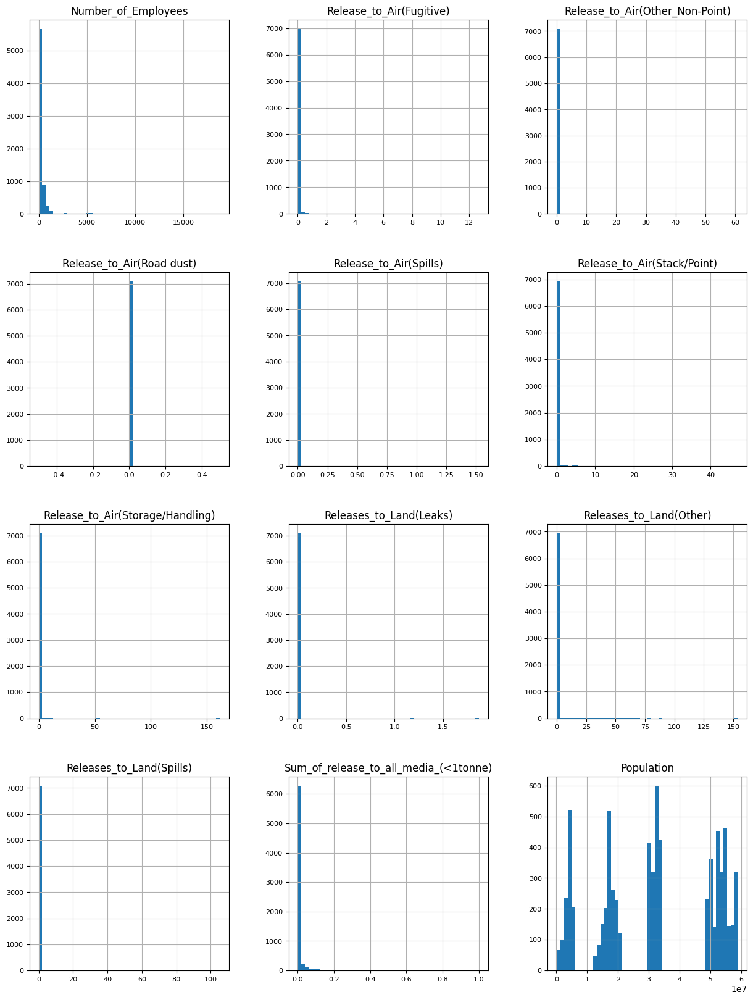

In [ ]:
#histogram plot of all the numerical columns
numerical_columns = [
    'Number_of_Employees',
    'Release_to_Air(Fugitive)', 'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
    'Release_to_Air(Spills)', 'Release_to_Air(Stack/Point)', 'Release_to_Air(Storage/Handling)',
    'Releases_to_Land(Leaks)', 'Releases_to_Land(Other)', 'Releases_to_Land(Spills)', 'Sum_of_release_to_all_media_(<1tonne)', 'Population']
X_train_phosphorus_1[numerical_columns].hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8)

In [ ]:
#Use this code each time to train and test on your initial model
# Step 1: Create the preprocessor
preprocessor = create_preprocessor()

# Step 2: Create the pipeline using the preprocessor
pipeline = rf_pipeline(preprocessor)

# Step 3: Fit the pipeline on the training data
pipeline.fit(X_train_phosphorus_1, y_train_phosphorus_1)

# Step 4: Predict and evaluate on the test data
y_pred_phosphorus_1 = pipeline.predict(X_test_phosphorus_1)

 # Evaluate the model's performance
rmse = np.sqrt(mean_squared_error(y_test_phosphorus_1, y_pred_phosphorus_1))
r2 = r2_score(y_test_phosphorus_1, y_pred_phosphorus_1)
mae = mean_absolute_error(y_test_phosphorus_1, y_pred_phosphorus_1)

# Print evaluation metrics
print(f"  RMSE: {rmse:.4f}")
print(f"  R-squared: {r2:.4f}")
print(f"  MAE: {mae:.4f}")
print("-" * 50)


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

  RMSE: 12817.1854
  R-squared: 0.9162
  MAE: 4699.8491
--------------------------------------------------


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

In [ ]:
# Step 1: Create the regressor pipelines
models_phosphorus_1 = create_multiple_regressor_pipelines(X_train_phosphorus_1, y_train_phosphorus_1)

# Step 2: Train and evaluate models
train_and_evaluate_models(models_phosphorus_1, X_train_phosphorus_1, y_train_phosphorus_1, X_test_phosphorus_1, y_test_phosphorus_1)


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Training Linear Regression...


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Linear Regression Performance:
  RMSE: 224811.0878
  R-squared: -24.7890
  MAE: 35629.3801
--------------------------------------------------
Training Random Forest...


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Random Forest Performance:
  RMSE: 28551.4974
  R-squared: 0.5840
  MAE: 5768.4597
--------------------------------------------------
Training Gradient Boosting...


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Gradient Boosting Performance:
  RMSE: 13294.9151
  R-squared: 0.9098
  MAE: 6363.6494
--------------------------------------------------
Training K-Nearest Neighbors...
K-Nearest Neighbors Performance:
  RMSE: 9953.5964
  R-squared: 0.9494
  MAE: 3753.7786
--------------------------------------------------
Training Polynomial Regression...


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Polynomial Regression Performance:
  RMSE: 134857896.0310
  R-squared: -9280091.1836
  MAE: 8382737.5155
--------------------------------------------------


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

In [ ]:
# Calculate the average ammonia release in the training data
average_phosphorus_release = y_train_phosphorus_1.mean()

# Create a baseline prediction array filled with the average
baseline_predictions = np.full(len(X_test_phosphorus_1), average_phosphorus_release)

# Calculate RMSE for the baseline model
baseline_rmse = np.sqrt(skMetrics.mean_squared_error(y_test_phosphorus_1, baseline_predictions))
print(f"Baseline RMSE: {baseline_rmse}")

Baseline RMSE: 45016.34214339834


In [ ]:

# Assuming you have your models list, training data, and preprocessor ready
models = [
    ('RandomForest', RandomForestRegressor(random_state=42)),
    ('LinearRegression', LinearRegression()),
    ('GradientBoosting', GradientBoostingRegressor(random_state=42)),
    ('KNN', KNeighborsRegressor()),
    ('PolynomialRegression', make_pipeline(PolynomialFeatures(degree=2), LinearRegression()))
]

# Perform cross-validation and get the results
results, best_model_name, best_model_pipeline = cross_validate_models(models, X_train_phosphorus_1, y_train_phosphorus_1, preprocessor)


Cross-validating RandomForest...
RandomForest: RMSE: 221964.9869 (std: 330671.0752), R2: -0.9949 (std: 2.3427)
--------------------------------------------------
Cross-validating LinearRegression...
LinearRegression: RMSE: 365498.4621 (std: 392557.6381), R2: -62.3109 (std: 125.0153)
--------------------------------------------------
Cross-validating GradientBoosting...
GradientBoosting: RMSE: 188334.5448 (std: 345225.9511), R2: 0.7194 (std: 0.3610)
--------------------------------------------------
Cross-validating KNN...
KNN: RMSE: 315817.1054 (std: 294545.1582), R2: -11.4657 (std: 10.5798)
--------------------------------------------------
Cross-validating PolynomialRegression...
PolynomialRegression: RMSE: 50680151.0561 (std: 73092626.7174), R2: -2702275.8386 (std: 5174960.6146)
--------------------------------------------------
Best Model: GradientBoosting
  RMSE: 188334.5448
  R2: 0.7194


In [ ]:
# Train the best model on the full training data
best_model_pipeline.fit(X_train_phosphorus_1, y_train_phosphorus_1)

# Predict on the test dataset
y_pred_phosphorus_1 = best_model_pipeline.predict(X_test_phosphorus_1)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test_phosphorus_1, y_pred_phosphorus_1))
r2 = r2_score(y_test_phosphorus_1, y_pred_phosphorus_1)
mae = mean_absolute_error(y_test_phosphorus_1, y_pred_phosphorus_1)

print(f"RMSE on test data: {rmse:.4f}")
print(f"R² score on test data: {r2:.4f}")
print(f"MAE on test data: {mae:.4f}")


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

RMSE on test data: 13470.0904
R² score on test data: 0.9074
MAE on test data: 6396.7351


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

### Feature selection by P-value

In [ ]:
# copy of the train and test sets
train_phosphorus_2 = train_phosphorus.copy()
test_phosphorus_2 = test_phosphorus.copy()

# Extract the target variable before dropping it from the features
y_train_phosphorus_2 = train_phosphorus_2['Total_Release_to_Water']
y_test_phosphorus_2 = test_phosphorus_2['Total_Release_to_Water']

# Now drop the target variable from the feature sets
X_train_phosphorus_2 = train_phosphorus_2.drop(['Total_Release_to_Water'], axis = 1)
X_test_phosphorus_2 = test_phosphorus_2.drop(['Total_Release_to_Water'], axis = 1)

In [ ]:
X_train_encoded_phosphorus, X_test_encoded_phosphorus = create_and_evaluate_pipeline(X_train_phosphorus_2, y_train_phosphorus_2, X_test_phosphorus_2, y_test_phosphorus_2)


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

In [ ]:
X_train_encoded_phosphorus.columns

Index(['num__Number_of_Employees', 'num__Release_to_Air(Fugitive)',
       'num__Release_to_Air(Other_Non-Point)',
       'num__Release_to_Air(Road dust)', 'num__Release_to_Air(Spills)',
       'num__Release_to_Air(Storage/Handling)',
       'num__Release_to_Air(Stack/Point)', 'num__Releases_to_Land(Leaks)',
       'num__Releases_to_Land(Other)', 'num__Releases_to_Land(Spills)',
       'num__Sum_of_release_to_all_media_(<1tonne)', 'num__Population',
       'cat1__PROVINCE_AB', 'cat1__PROVINCE_BC', 'cat1__PROVINCE_MB',
       'cat1__PROVINCE_NB', 'cat1__PROVINCE_NL', 'cat1__PROVINCE_NS',
       'cat1__PROVINCE_NT', 'cat1__PROVINCE_NU', 'cat1__PROVINCE_ON',
       'cat1__PROVINCE_PE', 'cat1__PROVINCE_QC', 'cat1__PROVINCE_SK',
       'cat1__Estimation_Method/Méthode_d’estimation_(blank)',
       'cat1__Estimation_Method/Méthode_d’estimation_C - Mass Balance',
       'cat1__Estimation_Method/Méthode_d’estimation_E1 - Site Specific Emission Factors',
       'cat1__Estimation_Method/Méthode_

In [ ]:
# Load feature dataset (X) and target (y)
X = X_train_encoded_phosphorus[['num__Number_of_Employees', 'num__Release_to_Air(Fugitive)',
       'num__Release_to_Air(Other_Non-Point)',
       'num__Release_to_Air(Road dust)', 'num__Release_to_Air(Spills)',
       'num__Release_to_Air(Storage/Handling)',
       'num__Release_to_Air(Stack/Point)', 'num__Releases_to_Land(Leaks)',
       'num__Releases_to_Land(Other)', 'num__Releases_to_Land(Spills)',
       'num__Sum_of_release_to_all_media_(<1tonne)', 'num__Population',
       'cat1__PROVINCE_AB', 'cat1__PROVINCE_BC', 'cat1__PROVINCE_MB',
       'cat1__PROVINCE_NB', 'cat1__PROVINCE_NL', 'cat1__PROVINCE_NS',
       'cat1__PROVINCE_NT', 'cat1__PROVINCE_NU', 'cat1__PROVINCE_ON',
       'cat1__PROVINCE_PE', 'cat1__PROVINCE_QC', 'cat1__PROVINCE_SK',
       'cat1__Estimation_Method/Méthode_d’estimation_(blank)',
       'cat1__Estimation_Method/Méthode_d’estimation_C - Mass Balance',
       'cat1__Estimation_Method/Méthode_d’estimation_E1 - Site Specific Emission Factors',
       'cat1__Estimation_Method/Méthode_d’estimation_E2 - Published Emission Factors',
       'cat1__Estimation_Method/Méthode_d’estimation_M1 - Continuous Emission Monitoring',
       'cat1__Estimation_Method/Méthode_d’estimation_M2 - Predictive Emission Monitoring',
       'cat1__Estimation_Method/Méthode_d’estimation_M3 - Source Testing',
       'cat1__Estimation_Method/Méthode_d’estimation_NI - No Information Available',
       'cat1__Estimation_Method/Méthode_d’estimation_O - Engineering Estimates',
       "cat2__Company_Name/Dénomination_sociale_de_l'entreprise",
       'cat2__Facility_Name/Installation', 'cat2__NAICS/Code_SCIAN',
       'cat2__NAICS Title/Titre_Code_SCIAN', 'cat2__City']]

y = train_phosphorus_2['Total_Release_to_Water']





In [ ]:
SL = 0.05

selected_columns = X.columns.tolist()


data_modeled_phosphorus, selected_columns = backwardElimination(X.values, y.values, SL, selected_columns)

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.162
Model:                            OLS   Adj. R-squared (uncentered):              0.161
Method:                 Least Squares   F-statistic:                              152.2
Date:                Thu, 12 Dec 2024   Prob (F-statistic):                   4.80e-264
Time:                        03:04:15   Log-Likelihood:                     -1.0087e+05
No. Observations:                7093   AIC:                                  2.018e+05
Df Residuals:                    7084   BIC:                                  2.018e+05
Df Model:                           9                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [ ]:

# Select the columns in the original X dataset that were selected
X_train_phosphorus_selected1 = X_train_encoded_phosphorus[selected_columns]
X_test_phosphorus_selected1 = X_test_encoded_phosphorus[selected_columns]

In [ ]:
train_and_evaluate_models

# Define the models to evaluate
models = [
    ('Linear Regression', LinearRegression()),
    ('Random Forest', RandomForestRegressor()),
    ('Gradient Boosting', GradientBoostingRegressor()),
    ('KNN', KNeighborsRegressor()),
    ('Polynomial Regression', make_pipeline(PolynomialFeatures(degree=2), LinearRegression()))
]

# Fit and evaluate the models
results = fit_and_evaluate_models(models, X_train_phosphorus_selected1, y_train_phosphorus_2, X_test_phosphorus_selected1, y_test_phosphorus_2)

# Display the results
display_results(results)

Model: Linear Regression
Root Mean Squared Error: 223659.17851589958
R^2 Score: -24.525424982976883
---
Model: Random Forest
Root Mean Squared Error: 11658.065703147262
R^2 Score: 0.9306490319062845
---
Model: Gradient Boosting
Root Mean Squared Error: 12338.68087889197
R^2 Score: 0.9223150313668802
---
Model: KNN
Root Mean Squared Error: 19609.383157864224
R^2 Score: 0.8037871727053058
---
Model: Polynomial Regression
Root Mean Squared Error: 143920.9854544894
R^2 Score: -9.569337810901521
---


In [ ]:

# Define the models to evaluate
models = [
    ("Decision Tree", DecisionTreeRegressor()),
    ("K-Nearest Neighbors (KNN)", KNeighborsRegressor()),
    ("Random Forest", RandomForestRegressor()),
    ("Gradient Boosting", GradientBoostingRegressor()),
    ("Linear Regression", LinearRegression()),
    ("Polynomial Regression (degree 2)", Pipeline([
        ('poly_features', PolynomialFeatures(degree=2)),
        ('scaler', StandardScaler()),
        ('linear_regression', LinearRegression())
    ]))
]


best_model, best_model_name, best_metrics = evaluate_models_with_cv(
    X_train_phosphorus_selected1, y_train_phosphorus_2, models, num_folds=5)

# Print the results
print(f"Best Model: {best_model_name}")
print(f"Metrics for Best Model:")
print(f"  RMSE: {best_metrics['RMSE']:.4f}")
print(f"  R²: {best_metrics['R2']:.4f}")
print(f"  MSE: {best_metrics['MSE']:.4f}")
print(f"  MAE: {best_metrics['MAE']:.4f}")


Best Model: Decision Tree
Metrics for Best Model:
  RMSE: 187522.2219
  R²: 0.7296
  MSE: 154604419602.9297
  MAE: 8660.2442


In [ ]:
# Train the best model on the full training data
best_model.fit(X_train_phosphorus_selected1, y_train_phosphorus_2)

# Predict on the test dataset
y_pred_phosphorus_2 = best_model.predict(X_test_phosphorus_selected1)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test_phosphorus_2, y_pred_phosphorus_2))
r2 = r2_score(y_test_phosphorus_2, y_pred_phosphorus_2)
mae = mean_absolute_error(y_test_phosphorus_2, y_pred_phosphorus_2)

print(f"RMSE on test data: {rmse:.4f}")
print(f"R² score on test data: {r2:.4f}")
print(f"MAE on test data: {mae:.4f}")


RMSE on test data: 11898.5331
R² score on test data: 0.9278
MAE on test data: 4835.1078


### Feature selection by Pearson Correlation

In [ ]:
# copy of the train and test sets
train_phosphorus_3 = train_phosphorus.copy()
test_phosphorus_3 = test_phosphorus.copy()

# Extract the target variable before dropping it from the features
y_train_phosphorus_3 = train_phosphorus_3['Total_Release_to_Water']
y_test_phosphorus_3 = test_phosphorus_3['Total_Release_to_Water']

# Now drop the target variable from the feature sets
X_train_phosphorus_3 = train_phosphorus_3.drop(['Total_Release_to_Water'], axis = 1)
X_test_phosphorus_3 = test_phosphorus_3.drop(['Total_Release_to_Water'], axis = 1)

In [ ]:
X_train_encoded_phosphorus3, X_test_encoded_phosphorus3 = create_and_evaluate_pipeline(X_train_phosphorus_3, y_train_phosphorus_3, X_test_phosphorus_3, y_test_phosphorus_3)


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

In [ ]:

# Apply the correlation function to remove highly correlated features
X_train_phosphorus_filtered3 = correlation(X_train_encoded_phosphorus3, cor=0.8)

In [ ]:
# Ensure validation and test sets have the same columns
X_val_phosphorus_corr = X_train_encoded_phosphorus3[X_train_phosphorus_filtered3.columns]
X_test_phosphorus_filtered3 = X_test_encoded_phosphorus3[X_train_phosphorus_filtered3.columns]


In [ ]:
# Define the models to evaluate
models = [
    ('Linear Regression', LinearRegression()),
    ('Random Forest', RandomForestRegressor()),
    ('Gradient Boosting', GradientBoostingRegressor()),
    ('KNN', KNeighborsRegressor()),
    ('Polynomial Regression', make_pipeline(PolynomialFeatures(degree=2), LinearRegression()))
]

# Fit and evaluate the models
results = fit_and_evaluate_models(models, X_val_phosphorus_corr, y_train_phosphorus_3, X_test_phosphorus_filtered3, y_test_phosphorus_3)

# Display the results
display_results(results)

Model: Linear Regression
Root Mean Squared Error: 194798.15339685313
R^2 Score: -18.3628464727758
---
Model: Random Forest
Root Mean Squared Error: 37180.611051655345
R^2 Score: 0.29460467563034864
---
Model: Gradient Boosting
Root Mean Squared Error: 14923.01310163691
R^2 Score: 0.8863648809577995
---
Model: KNN
Root Mean Squared Error: 12473.630461523571
R^2 Score: 0.9206064396429752
---
Model: Polynomial Regression
Root Mean Squared Error: 31261457.521160223
R^2 Score: -498674.43563411606
---


Performing Cross Validation

In [ ]:

# Define the models to evaluate
models = [
    ("Decision Tree", DecisionTreeRegressor()),
    ("K-Nearest Neighbors (KNN)", KNeighborsRegressor()),
    ("Random Forest", RandomForestRegressor()),
    ("Gradient Boosting", GradientBoostingRegressor()),
    ("Linear Regression", LinearRegression()),
    ("Polynomial Regression (degree 2)", Pipeline([
        ('poly_features', PolynomialFeatures(degree=2)),
        ('scaler', StandardScaler()),
        ('linear_regression', LinearRegression())
    ]))
]


best_model_phoscorr, best_model_name, best_metrics = evaluate_models_with_cv(
    X_val_phosphorus_corr, y_train_phosphorus_3, models, num_folds=5)

# Print the results
print(f"Best Model: {best_model_name}")
print(f"Metrics for Best Model:")
print(f"  RMSE: {best_metrics['RMSE']:.4f}")
print(f"  R²: {best_metrics['R2']:.4f}")
print(f"  MSE: {best_metrics['MSE']:.4f}")
print(f"  MAE: {best_metrics['MAE']:.4f}")


Best Model: Decision Tree
Metrics for Best Model:
  RMSE: 188074.7121
  R²: 0.7227
  MSE: 154539081763.8353
  MAE: 8754.9948


In [ ]:
# Train the best model on the full training data

best_model_phoscorr.fit(X_val_phosphorus_corr, y_train_phosphorus_3)

# Predict on the test dataset
y_pred_phosphorus_3 = best_model_phoscorr.predict(X_test_phosphorus_filtered3)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test_phosphorus_3, y_pred_phosphorus_3))
r2 = r2_score(y_test_phosphorus_3, y_pred_phosphorus_3)
mae = mean_absolute_error(y_test_phosphorus_3, y_pred_phosphorus_3)

print(f"RMSE on test data: {rmse:.4f}")
print(f"R² score on test data: {r2:.4f}")
print(f"MAE on test data: {mae:.4f}")


RMSE on test data: 11930.7252
R² score on test data: 0.9274
MAE on test data: 4542.0063


# Results Phosphorus

Showing the metrics obtained from the three models

RMSE values on test data using the model that performed best during cross validation


1.   Without FS:

*   RMSE: 20,998.1499
*   R²: 0.7750



  
2.   With p-value FS: Best Model:

*    RMSE: 12,338.6809
*    R²: 0.9223




3.   With Pearson corr FS:
  

*   RMSE: 11,671.2729
*   R²: 0.9305




# **Nitrate Ion Dataframe**

In [ ]:
df_NPRI_nitrate

,Reporting_Year/Année,NPRI_ID/No_INRP,Number_of_Employees,Company_Name/Dénomination_sociale_de_l'entreprise,Facility_Name/Installation,NAICS/Code_SCIAN,NAICS Title/Titre_Code_SCIAN,PROVINCE,City,Latitude,Longitude,CAS_Number/No_CAS,Substance_Name_(English)/Nom_de_substance_(Anglais),Units/Unités,Estimation_Method/Méthode_d’estimation,Release_to_Air(Fugitive),Release_to_Air(Other_Non-Point),Release_to_Air(Road dust),Release_to_Air(Spills),Release_to_Air(Stack/Point),Release_to_Air(Storage/Handling),Releases_to_Land(Leaks),Releases_to_Land(Other),Releases_to_Land(Spills),Releases_ to_Water_Bodies(Direct Discharges),Releases_ to_Water_Bodies(Leaks),Releases_ to_Water_Bodies(Spills),Sum_of_release_to_all_media_(<1tonne)
0,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,NA - 17,Nitrate ion in solution at pH >= 6.0,kg,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
1,2000,108,150,BARRICK GOLD CORPORATION,HOLT MCDERMOTT,212220,Gold and silver ore mining,ON,MATHESON,48.521200,-81.121800,NA - 17,Nitrate ion in solution at pH >= 6.0,kg,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7001.0,NaN,NaN,NaN
2,2000,319,120,ETI CANADA INC.,North Bay Site,325920,Explosives manufacturing,ON,North Bay,46.266700,-79.377800,NA - 17,Nitrate ion in solution at pH >= 6.0,kg,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13668.0,NaN,NaN,NaN
3,2000,351,1100,GENCORP CANADA INC.,GDX AUTOMOTIVE,326290,Other rubber product manufacturing,ON,Welland,42.997700,-79.238900,NA - 17,Nitrate ion in solution at pH >= 6.0,kg,C - Mass Balance,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16125.0,NaN,NaN,NaN
4,2000,394,10,HOMESTAKE CANADA INC,Nickel Plate Mine,212220,Gold and silver ore mining,BC,Penticton,49.371100,-120.023100,NA - 17,Nitrate ion in solution at pH >= 6.0,kg,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,155.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4352,2022,29897,220.0,Silver Lake Ontario Inc.,Silver Lake Ontario Inc. - Sugar Zone Mine,212220,Gold and silver ore mining,ON,White River,48.622573,-85.229848,NA - 17,Nitrate ion in solution at pH >= 6.0,kg,M1 - Continuous Emission Monitoring,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12025.0,NaN,NaN,NaN
4353,2022,30807,475.0,Eldorado Gold (Québec) Inc.,Eldorado Gold (Québec) Inc.,212220,Gold and silver ore mining,QC,Val-d'Or,48.094314,-77.585005,NA - 17,Nitrate ion in solution at pH >= 6.0,kg,M3 - Source Testing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17820.0,NaN,NaN,NaN
4354,2022,31967,12.0,The Corporation of the Town of Bradford West G...,BWG Wastewater Treatment Plant,221320,Sewage treatment facilities,ON,Bradford,44.122380,-79.558530,NA - 17,Nitrate ion in solution at pH >= 6.0,kg,M3 - Source Testing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,87125.0,NaN,NaN,NaN
4355,2022,33819,300.0,Puregold Mine Inc,Puregold Mine,212220,Gold and silver ore mining,ON,Madsen,50.967640,-93.918020,NA - 17,Nitrate ion in solution at pH >= 6.0,kg,M3 - Source Testing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,152770.0,NaN,NaN,NaN


In [ ]:
df_NPRI_nitrate['Reporting_Year/Année'].unique()

[2000, 2001, 2002, 2003, 2004, ..., 2018, 2019, 2020, 2021, 2022]
Length: 23
Categories (23, int64): [2000, 2001, 2002, 2003, ..., 2019, 2020, 2021, 2022]

# Feature Engineering and Preprocessing

In [ ]:
df_NPRI_nitrate1 = split_data(df = df_NPRI_nitrate, year_column = 'Reporting_Year/Année', split_year = 2018)

# Unpack the tuple into train_data and test_data
train_data, test_data = df_NPRI_nitrate1

train_data

train_nitrate = train_data
test_nitrate = test_data

train_nitrate.shape, test_nitrate.shape

((3499, 28), (858, 28))

In [ ]:
train_nitrate = fill_missing_coordinates(train_nitrate, 'Facility_Name/Installation', 'Latitude', 'Longitude')
test_nitrate = fill_missing_coordinates(test_nitrate, 'Facility_Name/Installation', 'Latitude', 'Longitude')

In [ ]:
train_nitrate = train_nitrate.dropna(subset=['Latitude', 'Longitude'])
test_nitrate = test_nitrate.dropna(subset=['Latitude', 'Longitude'])

In [ ]:
# drop the rows with missing facility name
train_nitrate = train_nitrate.dropna(subset=['Facility_Name/Installation'])


In [ ]:
# drop rows with missing cities
train_nitrate = train_nitrate.dropna(subset=['City'])

In [ ]:
columns = ['Release_to_Air(Fugitive)',
       'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
       'Release_to_Air(Spills)', 'Release_to_Air(Stack/Point)',
       'Release_to_Air(Storage/Handling)', 'Releases_to_Land(Leaks)',
       'Releases_to_Land(Other)', 'Releases_to_Land(Spills)',
       'Releases_ to_Water_Bodies(Direct Discharges)',
       'Releases_ to_Water_Bodies(Leaks)', 'Releases_ to_Water_Bodies(Spills)',
       'Sum_of_release_to_all_media_(<1tonne)']
for column in columns:
  train_nitrate = fill_missing_with_zeros(train_nitrate, [column])
  test_nitrate = fill_missing_with_zeros(test_nitrate, [column])


Merging with population dataset

In [ ]:
train_nitrate.shape, test_nitrate.shape

((3476, 28), (854, 28))

In [ ]:

# Merging the train dataset with the population dataset
train_nitrate = merge_datasets(train_nitrate, df_population, merge_columns=['Reporting_Year/Année', 'PROVINCE'])

# Merging the test dataset with the population dataset
test_nitrate = merge_datasets(test_nitrate, df_population, merge_columns=['Reporting_Year/Année', 'PROVINCE'])

train_nitrate.shape, test_nitrate.shape

((3476, 29), (854, 29))

In [ ]:
# Adding Up all the Releases to Water Bodies

Release_to_Water_columns = [
    'Releases_ to_Water_Bodies(Direct Discharges)',
    'Releases_ to_Water_Bodies(Leaks)',
    'Releases_ to_Water_Bodies(Spills)'
]

# Sum the specified release to water bodies columns and create a new column 'Total_Releases_to_Water'
train_nitrate['Total_Release_to_Water'] = train_nitrate[Release_to_Water_columns].sum(axis=1)

# Sum the specified release to water bodies columns and create a new column 'Total_Releases_to_Water'
test_nitrate['Total_Release_to_Water'] = test_nitrate[Release_to_Water_columns].sum(axis=1)

#drop the release to water columns
train_nitrate = train_nitrate.drop(['Releases_ to_Water_Bodies(Direct Discharges)', 'Releases_ to_Water_Bodies(Leaks)', 'Releases_ to_Water_Bodies(Spills)'], axis = 1)

#drop the release to water columns
test_nitrate = test_nitrate.drop(['Releases_ to_Water_Bodies(Direct Discharges)', 'Releases_ to_Water_Bodies(Leaks)', 'Releases_ to_Water_Bodies(Spills)'], axis = 1)


In [ ]:
#K means clustering on latitude and longitude
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=5, random_state=42)
train_nitrate['Region'] = kmeans.fit_predict(train_nitrate[['Latitude', 'Longitude']])
test_nitrate['Region'] = kmeans.fit_predict(test_nitrate[['Latitude', 'Longitude']])

In [ ]:
#drop substance and unit columns
train_nitrate = train_nitrate.drop(['Substance_Name_(English)/Nom_de_substance_(Anglais)', 'Units/Unités'], axis = 1)
test_nitrate = test_nitrate.drop(['Substance_Name_(English)/Nom_de_substance_(Anglais)', 'Units/Unités'], axis = 1)

In [ ]:
train_nitrate.shape, test_nitrate.shape

((3476, 26), (854, 26))

In [ ]:
# copy of the train and test sets
train_nitrate_1 = train_nitrate.copy()
test_nitrate_1 = test_nitrate.copy()

# Extract the target variable before dropping it from the features
y_train_nitrate_1 = train_nitrate_1['Total_Release_to_Water']
y_test_nitrate_1 = test_nitrate_1['Total_Release_to_Water']

# Now drop the target variable from the feature sets
X_train_nitrate_1 = train_nitrate_1.drop(['Total_Release_to_Water'], axis = 1)
X_test_nitrate_1 = test_nitrate_1.drop(['Total_Release_to_Water'], axis = 1)

array([[<Axes: title={'center': 'Release_to_Air(Fugitive)'}>,
        <Axes: title={'center': 'Release_to_Air(Other_Non-Point)'}>,
        <Axes: title={'center': 'Release_to_Air(Road dust)'}>],
       [<Axes: title={'center': 'Release_to_Air(Spills)'}>,
        <Axes: title={'center': 'Release_to_Air(Stack/Point)'}>,
        <Axes: title={'center': 'Release_to_Air(Storage/Handling)'}>],
       [<Axes: title={'center': 'Releases_to_Land(Leaks)'}>,
        <Axes: title={'center': 'Releases_to_Land(Other)'}>,
        <Axes: title={'center': 'Releases_to_Land(Spills)'}>],
       [<Axes: title={'center': 'Sum_of_release_to_all_media_(<1tonne)'}>,
        <Axes: title={'center': 'Population'}>, <Axes: >]], dtype=object)

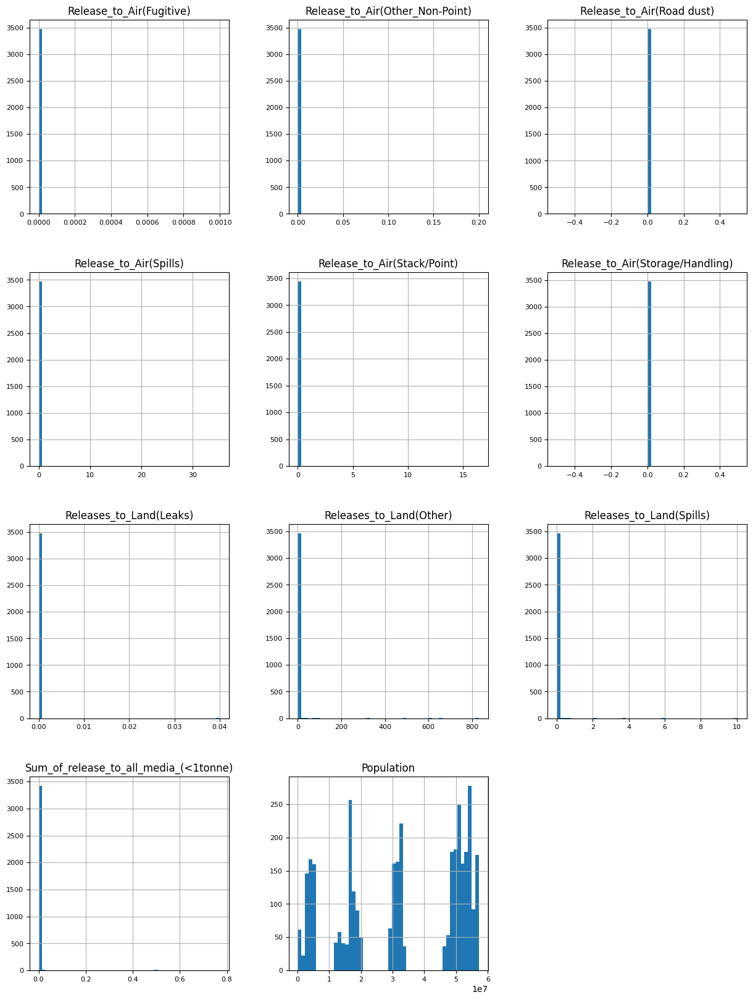

In [ ]:
#histogram plot of all the numerical columns
numerical_columns = [
    'Number_of_Employees',
    'Release_to_Air(Fugitive)', 'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
    'Release_to_Air(Spills)', 'Release_to_Air(Stack/Point)', 'Release_to_Air(Storage/Handling)',
    'Releases_to_Land(Leaks)', 'Releases_to_Land(Other)', 'Releases_to_Land(Spills)', 'Sum_of_release_to_all_media_(<1tonne)', 'Population']
X_train_nitrate_1[numerical_columns].hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8)

In [ ]:
#Use this code each time to train and test on your initial model
# Step 1: Create the preprocessor
preprocessor = create_preprocessor()

# Step 2: Create the pipeline using the preprocessor
pipeline = rf_pipeline(preprocessor)

# Step 3: Fit the pipeline on the training data
pipeline.fit(X_train_nitrate_1, y_train_nitrate_1)

# Step 4: Predict and evaluate on the test data
y_pred_nitrate_1 = pipeline.predict(X_test_nitrate_1)

 # Evaluate the model's performance
rmse = np.sqrt(mean_squared_error(y_test_nitrate_1, y_pred_nitrate_1))
r2 = r2_score(y_test_nitrate_1, y_pred_nitrate_1)
mae = mean_absolute_error(y_test_nitrate_1, y_pred_nitrate_1)

# Print evaluation metrics
print(f"  RMSE: {rmse:.4f}")
print(f"  R-squared: {r2:.4f}")
print(f"  MAE: {mae:.4f}")
print("-" * 50)


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

  RMSE: 254877.5512
  R-squared: 0.9620
  MAE: 111361.3979
--------------------------------------------------


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

In [ ]:
# Step 1: Create the regressor pipelines
models_nitrate_1 = create_multiple_regressor_pipelines(X_train_nitrate_1, y_train_nitrate_1)

# Step 2: Train and evaluate models
train_and_evaluate_models(models_nitrate_1, X_train_nitrate_1, y_train_nitrate_1, X_test_nitrate_1, y_test_nitrate_1)


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Training Linear Regression...
Linear Regression Performance:
  RMSE: 19762270.9689
  R-squared: -227.2639
  MAE: 939783.9923
--------------------------------------------------
Training Random Forest...


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Random Forest Performance:
  RMSE: 257305.4648
  R-squared: 0.9613
  MAE: 112506.6509
--------------------------------------------------
Training Gradient Boosting...


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Gradient Boosting Performance:
  RMSE: 306184.3536
  R-squared: 0.9452
  MAE: 142504.8887
--------------------------------------------------
Training K-Nearest Neighbors...
K-Nearest Neighbors Performance:
  RMSE: 309450.2566
  R-squared: 0.9440
  MAE: 123000.3549
--------------------------------------------------
Training Polynomial Regression...


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Polynomial Regression Performance:
  RMSE: 993250834.4123
  R-squared: -576607.9392
  MAE: 35462623.6598
--------------------------------------------------


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

In [ ]:
# Calculate the average ammonia release in the training data
average_nitrate_release = y_train_nitrate_1.mean()

# Create a baseline prediction array filled with the average
baseline_predictions = np.full(len(X_test_nitrate_1), average_nitrate_release)

# Calculate RMSE for the baseline model
baseline_rmse = np.sqrt(skMetrics.mean_squared_error(y_test_nitrate_1, baseline_predictions))
print(f"Baseline RMSE: {baseline_rmse}")

Baseline RMSE: 1309580.9672963293


In [ ]:


models = [
    ('RandomForest', RandomForestRegressor(random_state=42)),
    ('LinearRegression', LinearRegression()),
    ('GradientBoosting', GradientBoostingRegressor(random_state=42)),
    ('KNN', KNeighborsRegressor()),
    ('PolynomialRegression', make_pipeline(PolynomialFeatures(degree=2), LinearRegression()))
]

# Perform cross-validation and get the results
results, best_model_name, best_model_pipeline = cross_validate_models(models, X_train_nitrate_1, y_train_nitrate_1, preprocessor)


Cross-validating RandomForest...
RandomForest: RMSE: 303763.9860 (std: 126495.0122), R2: 0.9228 (std: 0.0547)
--------------------------------------------------
Cross-validating LinearRegression...
LinearRegression: RMSE: 409844.3112 (std: 60596.9891), R2: 0.8642 (std: 0.0378)
--------------------------------------------------
Cross-validating GradientBoosting...
GradientBoosting: RMSE: 302423.9558 (std: 63577.4059), R2: 0.9017 (std: 0.0799)
--------------------------------------------------
Cross-validating KNN...
KNN: RMSE: 288249.9155 (std: 28725.1738), R2: 0.9315 (std: 0.0240)
--------------------------------------------------
Cross-validating PolynomialRegression...
PolynomialRegression: RMSE: 767037.0942 (std: 419099.9632), R2: 0.4516 (std: 0.5092)
--------------------------------------------------
Best Model: KNN
  RMSE: 288249.9155
  R2: 0.9315


In [ ]:
# Train the best model on the full training data
best_model_pipeline.fit(X_train_nitrate_1, y_train_nitrate_1)

# Predict on the test dataset
y_pred_nitrate_1 = best_model_pipeline.predict(X_test_nitrate_1)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test_nitrate_1, y_pred_nitrate_1))
r2 = r2_score(y_test_nitrate_1, y_pred_nitrate_1)
mae = mean_absolute_error(y_test_nitrate_1, y_pred_nitrate_1)

print(f"RMSE on test data: {rmse:.4f}")
print(f"R² score on test data: {r2:.4f}")
print(f"MAE on test data: {mae:.4f}")


RMSE on test data: 309450.2566
R² score on test data: 0.9440
MAE on test data: 123000.3549


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

## Feature Selection by P-value

In [ ]:
# copy of the train and test sets
train_nitrate_2 = train_nitrate.copy()
test_nitrate_2 = test_nitrate.copy()

# Extract the target variable before dropping it from the features
y_train_nitrate_2 = train_nitrate_2['Total_Release_to_Water']
y_test_nitrate_2 = test_nitrate_2['Total_Release_to_Water']

# Now drop the target variable from the feature sets
X_train_nitrate_2 = train_nitrate_2.drop(['Total_Release_to_Water'], axis = 1)
X_test_nitrate_2 = test_nitrate_2.drop(['Total_Release_to_Water'], axis = 1)

In [ ]:
X_train_encoded_nitrate, X_test_encoded_nitrate = create_and_evaluate_pipeline(X_train_nitrate_2, y_train_nitrate_2, X_test_nitrate_2, y_test_nitrate_2)


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

In [ ]:
X_train_encoded_nitrate.columns

Index(['num__Number_of_Employees', 'num__Release_to_Air(Fugitive)',
       'num__Release_to_Air(Other_Non-Point)',
       'num__Release_to_Air(Road dust)', 'num__Release_to_Air(Spills)',
       'num__Release_to_Air(Storage/Handling)',
       'num__Release_to_Air(Stack/Point)', 'num__Releases_to_Land(Leaks)',
       'num__Releases_to_Land(Other)', 'num__Releases_to_Land(Spills)',
       'num__Sum_of_release_to_all_media_(<1tonne)', 'num__Population',
       'cat1__PROVINCE_AB', 'cat1__PROVINCE_BC', 'cat1__PROVINCE_MB',
       'cat1__PROVINCE_NB', 'cat1__PROVINCE_NL', 'cat1__PROVINCE_NS',
       'cat1__PROVINCE_NT', 'cat1__PROVINCE_NU', 'cat1__PROVINCE_ON',
       'cat1__PROVINCE_PE', 'cat1__PROVINCE_QC', 'cat1__PROVINCE_SK',
       'cat1__PROVINCE_YT',
       'cat1__Estimation_Method/Méthode_d’estimation_(blank)',
       'cat1__Estimation_Method/Méthode_d’estimation_C - Mass Balance',
       'cat1__Estimation_Method/Méthode_d’estimation_E - Emission Factor',
       'cat1__Estimation_Met

In [ ]:
# Load feature dataset (X) and target (y)
X = X_train_encoded_nitrate[['num__Number_of_Employees', 'num__Release_to_Air(Fugitive)',
       'num__Release_to_Air(Other_Non-Point)',
       'num__Release_to_Air(Road dust)', 'num__Release_to_Air(Spills)',
       'num__Release_to_Air(Storage/Handling)',
       'num__Release_to_Air(Stack/Point)', 'num__Releases_to_Land(Leaks)',
       'num__Releases_to_Land(Other)', 'num__Releases_to_Land(Spills)',
       'num__Sum_of_release_to_all_media_(<1tonne)', 'num__Population',
       'cat1__PROVINCE_AB', 'cat1__PROVINCE_BC', 'cat1__PROVINCE_MB',
       'cat1__PROVINCE_NB', 'cat1__PROVINCE_NL', 'cat1__PROVINCE_NS',
       'cat1__PROVINCE_NT', 'cat1__PROVINCE_NU', 'cat1__PROVINCE_ON',
       'cat1__PROVINCE_PE', 'cat1__PROVINCE_QC', 'cat1__PROVINCE_SK',
       'cat1__PROVINCE_YT',
       'cat1__Estimation_Method/Méthode_d’estimation_(blank)',
       'cat1__Estimation_Method/Méthode_d’estimation_C - Mass Balance',
       'cat1__Estimation_Method/Méthode_d’estimation_E - Emission Factor',
       'cat1__Estimation_Method/Méthode_d’estimation_E1 - Site Specific Emission Factors',
       'cat1__Estimation_Method/Méthode_d’estimation_E2 - Published Emission Factors',
       'cat1__Estimation_Method/Méthode_d’estimation_M - Monitoring or Direct Measurement',
       'cat1__Estimation_Method/Méthode_d’estimation_M1 - Continuous Emission Monitoring',
       'cat1__Estimation_Method/Méthode_d’estimation_M2 - Predictive Emission Monitoring',
       'cat1__Estimation_Method/Méthode_d’estimation_M3 - Source Testing',
       'cat1__Estimation_Method/Méthode_d’estimation_O - Engineering Estimates',
       "cat2__Company_Name/Dénomination_sociale_de_l'entreprise",
       'cat2__Facility_Name/Installation', 'cat2__NAICS/Code_SCIAN',
       'cat2__NAICS Title/Titre_Code_SCIAN', 'cat2__City']]

y = train_nitrate_2['Total_Release_to_Water']





In [ ]:
SL = 0.05

selected_columns = X.columns.tolist()


data_modeled_nitrate, selected_columns = backwardElimination(X.values, y.values, SL, selected_columns)

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.882
Model:                            OLS   Adj. R-squared:                  0.882
Method:                 Least Squares   F-statistic:                     1127.
Date:                Thu, 12 Dec 2024   Prob (F-statistic):               0.00
Time:                        03:05:29   Log-Likelihood:                -49734.
No. Observations:                3476   AIC:                         9.952e+04
Df Residuals:                    3452   BIC:                         9.966e+04
Df Model:                          23                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const               0          0        nan        n

/usr/local/lib/python3.10/dist-packages/statsmodels/regression/linear_model.py:1966: RuntimeWarning:

divide by zero encountered in scalar divide



In [ ]:

# Select the columns in the original X dataset that were selected
X_train_nitrate_selected1 = X_train_encoded_nitrate[selected_columns]
X_test_nitrate_selected1 = X_test_encoded_nitrate[selected_columns]

In [ ]:
train_and_evaluate_models

# Define the models to evaluate
models = [
    ('Linear Regression', LinearRegression()),
    ('Random Forest', RandomForestRegressor()),
    ('Gradient Boosting', GradientBoostingRegressor()),
    ('KNN', KNeighborsRegressor()),
    ('Polynomial Regression', make_pipeline(PolynomialFeatures(degree=2), LinearRegression()))
]

# Fit and evaluate the models
results = fit_and_evaluate_models(models, X_train_nitrate_selected1, y_train_nitrate_2, X_test_nitrate_selected1, y_test_nitrate_2)

# Display the results
display_results(results)

Model: Linear Regression
Root Mean Squared Error: 489347.79770887905
R^2 Score: 0.8600416640851213
---
Model: Random Forest
Root Mean Squared Error: 260775.1905153602
R^2 Score: 0.9602537612834473
---
Model: Gradient Boosting
Root Mean Squared Error: 312157.8427955403
R^2 Score: 0.9430476045453721
---
Model: KNN
Root Mean Squared Error: 306864.63073839503
R^2 Score: 0.9449626946103723
---
Model: Polynomial Regression
Root Mean Squared Error: 849045.0181612899
R^2 Score: 0.5786675293492736
---


In [ ]:

# Define the models to evaluate
models = [
    ("Decision Tree", DecisionTreeRegressor()),
    ("K-Nearest Neighbors (KNN)", KNeighborsRegressor()),
    ("Random Forest", RandomForestRegressor()),
    ("Gradient Boosting", GradientBoostingRegressor()),
    ("Linear Regression", LinearRegression()),
    ("Polynomial Regression (degree 2)", Pipeline([
        ('poly_features', PolynomialFeatures(degree=2)),
        ('scaler', StandardScaler()),
        ('linear_regression', LinearRegression())
    ]))
]


best_model, best_model_name, best_metrics = evaluate_models_with_cv(
    X_train_nitrate_selected1, y_train_nitrate_2, models, num_folds=5)

# Print the results
print(f"Best Model: {best_model_name}")
print(f"Metrics for Best Model:")
print(f"  RMSE: {best_metrics['RMSE']:.4f}")
print(f"  R²: {best_metrics['R2']:.4f}")
print(f"  MSE: {best_metrics['MSE']:.4f}")
print(f"  MAE: {best_metrics['MAE']:.4f}")


Best Model: Random Forest
Metrics for Best Model:
  RMSE: 233660.6408
  R²: 0.9532
  MSE: 63228871057.9499
  MAE: 59367.4430


In [ ]:
# Train the best model on the full training data
best_model.fit(X_train_nitrate_selected1, y_train_nitrate_2)

# Predict on the test dataset
y_pred_nitrate_2 = best_model.predict(X_test_nitrate_selected1)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test_nitrate_2, y_pred_nitrate_2))
r2 = r2_score(y_test_nitrate_2, y_pred_nitrate_2)
mae = mean_absolute_error(y_test_nitrate_2, y_pred_nitrate_2)

print(f"RMSE on test data: {rmse:.4f}")
print(f"R² score on test data: {r2:.4f}")
print(f"MAE on test data: {mae:.4f}")


RMSE on test data: 267031.9867
R² score on test data: 0.9583
MAE on test data: 111101.4789


## Feature Selection by Pearson Correlation

In [ ]:
# copy of the train and test sets
train_nitrate_3 = train_nitrate.copy()
test_nitrate_3 = test_nitrate.copy()

# Extract the target variable before dropping it from the features
y_train_nitrate_3 = train_nitrate_3['Total_Release_to_Water']
y_test_nitrate_3 = test_nitrate_3['Total_Release_to_Water']

# Now drop the target variable from the feature sets
X_train_nitrate_3 = train_nitrate_3.drop(['Total_Release_to_Water'], axis = 1)
X_test_nitrate_3 = test_nitrate_3.drop(['Total_Release_to_Water'], axis = 1)

In [ ]:
X_train_encoded_nitrate3, X_test_encoded_nitrate3 = create_and_evaluate_pipeline(X_train_nitrate_3, y_train_nitrate_3, X_test_nitrate_3, y_test_nitrate_3)


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

In [ ]:

# Apply the correlation function to remove highly correlated features
X_train_nitrate_filtered3 = correlation(X_train_encoded_nitrate3, cor=0.8)

In [ ]:
# Ensure validation and test sets have the same columns
X_val_nitrate_corr = X_train_encoded_nitrate3[X_train_nitrate_filtered3.columns]
X_test_nitrate_filtered3 = X_test_encoded_nitrate3[X_train_nitrate_filtered3.columns]


In [ ]:
# Define the models to evaluate
models = [
    ('Linear Regression', LinearRegression()),
    ('Random Forest', RandomForestRegressor()),
    ('Gradient Boosting', GradientBoostingRegressor()),
    ('KNN', KNeighborsRegressor()),
    ('Polynomial Regression', make_pipeline(PolynomialFeatures(degree=2), LinearRegression()))
]

# Fit and evaluate the models
results = fit_and_evaluate_models(models, X_val_nitrate_corr, y_train_nitrate_3, X_test_nitrate_filtered3, y_test_nitrate_3)

# Display the results
display_results(results)

Model: Linear Regression
Root Mean Squared Error: 13503489.217726089
R^2 Score: -105.57503841424293
---
Model: Random Forest
Root Mean Squared Error: 259780.84758502498
R^2 Score: 0.960556290395394
---
Model: Gradient Boosting
Root Mean Squared Error: 317217.4533199261
R^2 Score: 0.9411864164184562
---
Model: KNN
Root Mean Squared Error: 311740.471074057
R^2 Score: 0.9431997995248541
---
Model: Polynomial Regression
Root Mean Squared Error: 1775091333.893535
R^2 Score: -1841639.687843654
---


Performing Cross Validation

In [ ]:

# Define the models to evaluate
models = [
    ("Decision Tree", DecisionTreeRegressor()),
    ("K-Nearest Neighbors (KNN)", KNeighborsRegressor()),
    ("Random Forest", RandomForestRegressor()),
    ("Gradient Boosting", GradientBoostingRegressor()),
    ("Linear Regression", LinearRegression()),
    ("Polynomial Regression (degree 2)", Pipeline([
        ('poly_features', PolynomialFeatures(degree=2)),
        ('scaler', StandardScaler()),
        ('linear_regression', LinearRegression())
    ]))
]


best_model_nitcorr, best_model_name, best_metrics = evaluate_models_with_cv(
    X_val_nitrate_corr, y_train_nitrate_3, models, num_folds=5)

# Print the results
print(f"Best Model: {best_model_name}")
print(f"Metrics for Best Model:")
print(f"  RMSE: {best_metrics['RMSE']:.4f}")
print(f"  R²: {best_metrics['R2']:.4f}")
print(f"  MSE: {best_metrics['MSE']:.4f}")
print(f"  MAE: {best_metrics['MAE']:.4f}")


Best Model: Random Forest
Metrics for Best Model:
  RMSE: 277011.6631
  R²: 0.9361
  MSE: 82816340167.4376
  MAE: 62444.6010


In [ ]:
# Train the best model on the full training data

best_model_nitcorr.fit(X_val_nitrate_corr, y_train_nitrate_3)

# Predict on the test dataset
y_pred_nitrate_3 = best_model_nitcorr.predict(X_test_nitrate_filtered3)

# Evaluate the model
rmse = np.sqrt(mean_squared_error(y_test_nitrate_3, y_pred_nitrate_3))
r2 = r2_score(y_test_nitrate_3, y_pred_nitrate_3)
mae = mean_absolute_error(y_test_nitrate_3, y_pred_nitrate_3)

print(f"RMSE on test data: {rmse:.4f}")
print(f"R² score on test data: {r2:.4f}")
print(f"MAE on test data: {mae:.4f}")


RMSE on test data: 264885.1671
R² score on test data: 0.9590
MAE on test data: 116423.5674


## Results Nitrate

Showing the metrics obtained from the three models

RMSE values on test data using the model that performed best during cross validation


1.   Without FS:

*   RMSE: 294083.9120
*  R2: 0.9285



  
2.   With p-value FS: Best Model:

*    RMSE: 262445.5377
*    R²: 0.9597



3.   With Pearson corr FS:
  

*   RMSE: 263,290.5408
*   R²: 0.9595




# Forecasting Total Release for future years

**Forecasting Total Releases to Water for 2023**

In this phase of the project, we focus on forecasting the total release of three key substances to water for the year 2023. Since the dataset does not include features for 2023, we employ lag features to enable the model to predict future releases based on historical patterns.

**Methodology:**

**Feature Engineering:**
Lag Values: We create lagged features for numerical columns to capture temporal relationships and trends.

**Categorical Encoding:**  Categorical variables are encoded to ensure they can be effectively utilized in the model.
Feature Selection: Features are chosen based on insights derived from exploratory data analysis and feature selection methods to improve model accuracy.

**Pipeline Creation:**
We construct a modeling pipeline that integrates the lagged and encoded features. This pipeline ensures consistency and scalability for preprocessing and model training.

**Historical Pattern Alignment:**
By utilizing lagged features, the model leverages historical data trends to make accurate future predictions, enabling it to forecast releases for 2023 effectively.

## Forecast for Ammonia

In [ ]:
train_ammonia.columns

Index(['Reporting_Year/Année', 'NPRI_ID/No_INRP', 'Number_of_Employees',
       'Company_Name/Dénomination_sociale_de_l'entreprise',
       'Facility_Name/Installation', 'NAICS/Code_SCIAN',
       'NAICS Title/Titre_Code_SCIAN', 'PROVINCE', 'City', 'Latitude',
       'Longitude', 'CAS_Number/No_CAS',
       'Estimation_Method/Méthode_d’estimation', 'Release_to_Air(Fugitive)',
       'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
       'Release_to_Air(Spills)', 'Release_to_Air(Stack/Point)',
       'Release_to_Air(Storage/Handling)', 'Releases_to_Land(Leaks)',
       'Releases_to_Land(Other)', 'Releases_to_Land(Spills)',
       'Sum_of_release_to_all_media_(<1tonne)', 'Population',
       'Total_Release_to_Water', 'Region'],
      dtype='object')

In [ ]:
# copy of the train and test sets
train_ammonia_forecast= train_ammonia.copy()
test_ammonia_forecast = test_ammonia.copy()

In [ ]:
# Combine train and test data into a single dataframe
data_NPRI_ammonia_2 = pd.concat([train_ammonia_forecast, test_ammonia_forecast], axis=0)

# Reset the index of the combined dataframe
data_NPRI_ammonia_2.reset_index(drop=True, inplace=True)

In [ ]:
data_NPRI_ammonia_2.columns

Index(['Reporting_Year/Année', 'NPRI_ID/No_INRP', 'Number_of_Employees',
       'Company_Name/Dénomination_sociale_de_l'entreprise',
       'Facility_Name/Installation', 'NAICS/Code_SCIAN',
       'NAICS Title/Titre_Code_SCIAN', 'PROVINCE', 'City', 'Latitude',
       'Longitude', 'CAS_Number/No_CAS',
       'Estimation_Method/Méthode_d’estimation', 'Release_to_Air(Fugitive)',
       'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
       'Release_to_Air(Spills)', 'Release_to_Air(Stack/Point)',
       'Release_to_Air(Storage/Handling)', 'Releases_to_Land(Leaks)',
       'Releases_to_Land(Other)', 'Releases_to_Land(Spills)',
       'Sum_of_release_to_all_media_(<1tonne)', 'Population',
       'Total_Release_to_Water', 'Region'],
      dtype='object')

In [ ]:
def forecast_future_years_with_metrics(data, start_year, end_year, n_lags=5, target='Total_Release_to_Water', params=None):
    """
    Forecast pollutant release by province for future years using RandomForestRegressor,
    and calculate evaluation metrics.

    Parameters:
    - data (pd.DataFrame): Historical dataset containing features and target.
    - start_year (int): Start year for the forecast.
    - end_year (int): End year for the forecast.
    - n_lags (int): Number of lagged features to create.
    - target (str): Target variable to forecast.
    - params (dict, optional): Parameters for RandomForestRegressor.

    Returns:
    - future_forecasts (pd.DataFrame): Forecasted total release aggregated by province for each year.
    - metrics (dict): Evaluation metrics (RMSE, MAE, R²) for the model.
    """
    def create_lags_no_group(df, feature, n_lags):
        """Create lagged features for the target and predictors."""
        for i in range(1, n_lags + 1):
            df[f'{feature}_lag{i}'] = df[feature].shift(i)
        return df

    # Define lagged features
    pollutants = [target]
    additional_features = [
        'Population',
        'Number_of_Employees',
        'Release_to_Air(Fugitive)',
        'Release_to_Air(Other_Non-Point)',
        'Release_to_Air(Road dust)',
        'Release_to_Air(Spills)',
        'Release_to_Air(Stack/Point)',
        'Release_to_Air(Storage/Handling)',
        'Releases_to_Land(Leaks)',
        'Releases_to_Land(Other)',
        'Releases_to_Land(Spills)',
        'Sum_of_release_to_all_media_(<1tonne)'
    ]

    for feature in pollutants + additional_features:
        data = create_lags_no_group(data, feature, n_lags)

    # Drop missing values (introduced by lagging)
    data = data.dropna()

    # One-hot encode categorical variables
    province_encoded = pd.get_dummies(data['PROVINCE'], prefix='PROVINCE', drop_first=True, dtype=int)
    data = pd.concat([data, province_encoded], axis=1)

    # Perform one-hot encoding for 'Estimation_Method'
    estimation_encoded = pd.get_dummies(data['Estimation_Method/Méthode_d’estimation'], prefix='Estimation_Method', drop_first=True, dtype=int)
    data = pd.concat([data, estimation_encoded], axis=1)

    # perform targegt encoding for 'City' columns
    encoder = ce.TargetEncoder(cols=['City', 'Facility_Name/Installation', 'NAICS Title/Titre_Code_SCIAN', 'NAICS/Code_SCIAN', "Company_Name/Dénomination_sociale_de_l'entreprise"])
    data = encoder.fit_transform(data, data[pollutants[0]])



    # Define features for training
    features = [f'{pollutant}_lag{i}' for pollutant in pollutants for i in range(1, n_lags + 1)] + \
               [f'{feature}_lag{i}' for feature in additional_features for i in range(1, n_lags + 1)] + \
               list(province_encoded.columns) +  \
               ['City', 'Facility_Name/Installation', 'NAICS Title/Titre_Code_SCIAN',  'NAICS/Code_SCIAN', "Company_Name/Dénomination_sociale_de_l'entreprise"] +  \
               list(estimation_encoded.columns)

    # Add region if available
    if 'Region' in data.columns:
        features += ['Region']

    # Initialize model
    pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('regressor', RandomForestRegressor(random_state=42, **params if params else {}))
    ])

    # Train on historical data up to the start year - 1 to have data for the start year in the test set
    train_data = data[data['Reporting_Year/Année'] < start_year -1] # Changed to start_year - 1
    test_data = data[data['Reporting_Year/Année'] >= start_year - 1] # Changed to start_year - 1

    X_train = train_data[features]
    y_train = train_data[target]
    X_test = test_data[features]
    y_test = test_data[target]

    # Fit the model
    pipeline.fit(X_train, y_train)

    # Evaluate the model
    y_pred = pipeline.predict(X_test)
    metrics = {
        'Root Mean Squared Error': root_mean_squared_error(y_test, y_pred),
        'Mean Absolute Error': mean_absolute_error(y_test, y_pred),
        'R² Score': r2_score(y_test, y_pred)
    }

    # Create a DataFrame to store forecasted values
    future_forecasts = []

    # Forecast for each year in the range
    for year in range(start_year, end_year + 1):
        # Generate lagged features for the forecast year
        latest_data = data[data['Reporting_Year/Année'] == year - 1].copy()
        latest_data['Reporting_Year/Année'] = year
        latest_data[target] = pipeline.predict(latest_data[features])

        # Append forecasts to the dataset
        data = pd.concat([data, latest_data], ignore_index=True)

        # Aggregate forecasted values by province
        yearly_forecast = latest_data.groupby('PROVINCE')[[target]].sum()
        yearly_forecast['Year'] = year
        future_forecasts.append(yearly_forecast)

    # Combine all yearly forecasts into a single DataFrame
    future_forecasts = pd.concat(future_forecasts).reset_index()

    return future_forecasts, metrics


In [ ]:
# Forecast total releases by province and get model metrics
future_forecasts_ammonia, metrics = forecast_future_years_with_metrics(
    data=data_NPRI_ammonia_2,
    start_year=2023,
    end_year=2023,
    n_lags=5,
    target='Total_Release_to_Water',
    params={'n_estimators': 200, 'max_depth': 10}
)

# Display the forecasted releases by province
print("Forecasted Releases by Province:")
print(future_forecasts_ammonia)

# Display model evaluation metrics
print("\nModel Evaluation Metrics:")
for metric, value in metrics.items():
    print(f"{metric}: {value:.4f}")


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Forecasted Releases by Province:
  PROVINCE  Total_Release_to_Water  Year
0       AB            1.498139e+06  2023
1       BC            1.412532e+07  2023
2       MB            2.772990e+06  2023
3       NB            1.048699e+06  2023
4       NL            7.756551e+05  2023
5       NS            1.483435e+06  2023
6       ON            1.028825e+07  2023
7       PE            3.358189e+04  2023
8       QC            1.502704e+07  2023
9       SK            6.519091e+05  2023

Model Evaluation Metrics:
Root Mean Squared Error: 51830.9332
Mean Absolute Error: 19112.5946
R² Score: 0.9874


In [ ]:
# to compare the RMSE value
std_dev = pd.Series(data_NPRI_ammonia_2['Total_Release_to_Water']).std()
print(f"Standard Deviation: {std_dev}")

Standard Deviation: 401766.1051569635


Plotting the chart to show the historical trends and the forecasted values

In [ ]:
def plot_actual_vs_forecasted_aggregated(data, future_forecasts, target):
    """
    Plots actual values (2000–2022) and forecasted value (2023)
    for each province, aggregating data by year.

    Args:
        data (DataFrame): DataFrame containing the original data.
        future_forecasts (DataFrame): DataFrame containing the forecasted values.
        target (str): The target pollutant column name.
    """
    provinces = data['PROVINCE'].unique()

    for province in provinces:
        fig, ax = plt.subplots(figsize=(10, 6))

        # Aggregate actual data for the specific province and years up to 2022
        province_data = (data[(data['PROVINCE'] == province) &
                              (data['Reporting_Year/Année'] <= 2022)]
                         .groupby('Reporting_Year/Année')[target]
                         .sum()  # Change to mean() if appropriate
                         .reset_index())

        # Plot actual values (2000–2022)
        if not province_data.empty:
            ax.plot(province_data['Reporting_Year/Année'], province_data[target],
                    label='Actual', marker='o', color='blue', linestyle='-')

        # Filter forecast data for the province and the year 2023
        forecast_data = future_forecasts[(future_forecasts['PROVINCE'] == province) &
                                         (future_forecasts['Year'] == 2023)]

        # Plot forecasted value for 2023
        if not forecast_data.empty:
            ax.scatter(forecast_data['Year'], forecast_data[target],
                       color='red', label='Forecasted', marker='x', s=100)

        # Formatting the plot
        ax.set_title(f'{province} - {target}', fontsize=14, fontweight='bold')
        ax.set_xlabel('Year', fontsize=12)
        ax.set_ylabel(target, fontsize=12)
        ax.legend(loc='best', fontsize=10)
        ax.grid(True, linestyle='--', alpha=0.6)

        # Improve layout and show plot
        plt.tight_layout()
        plt.show()




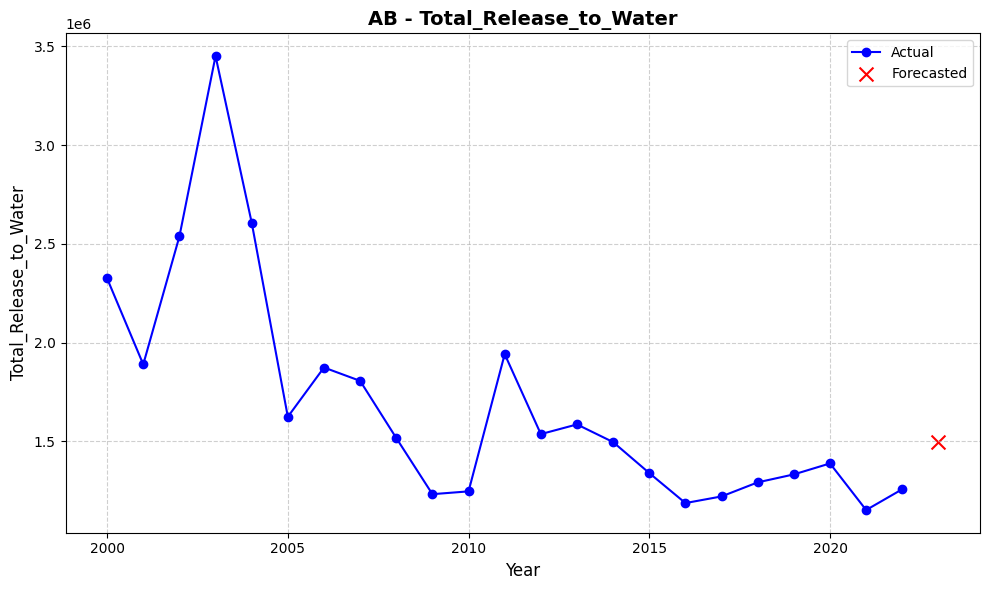

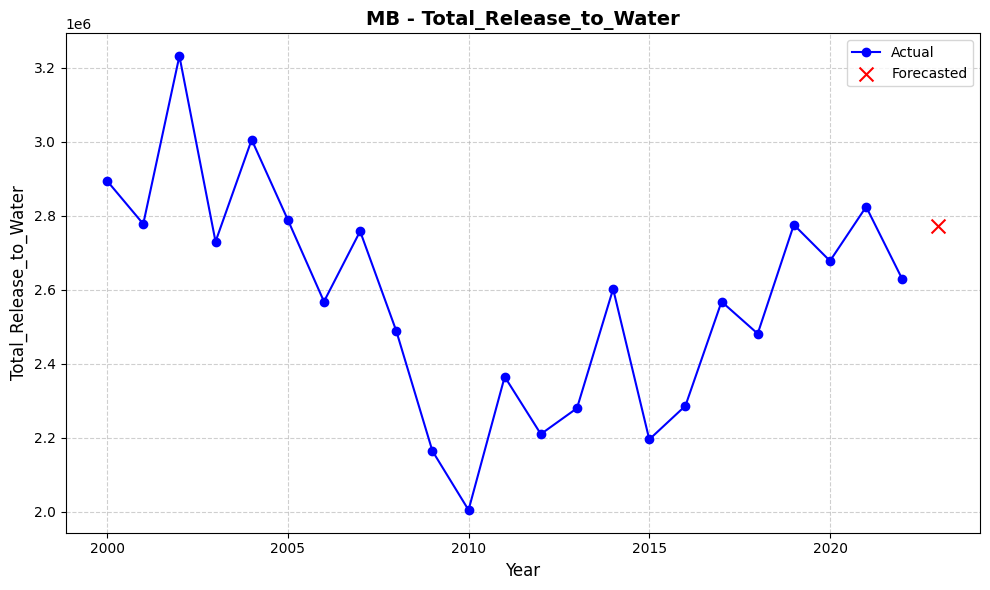

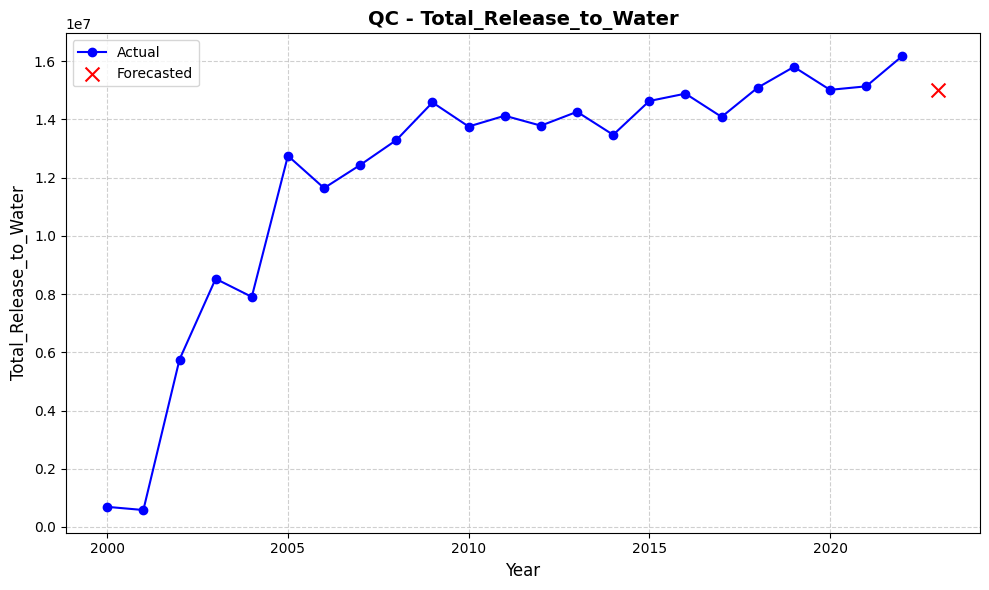

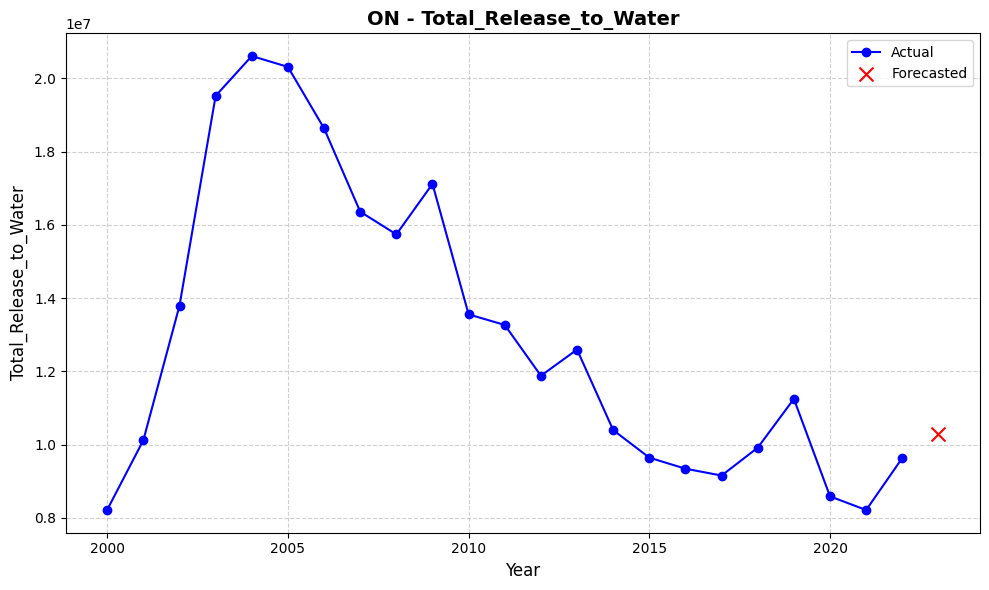

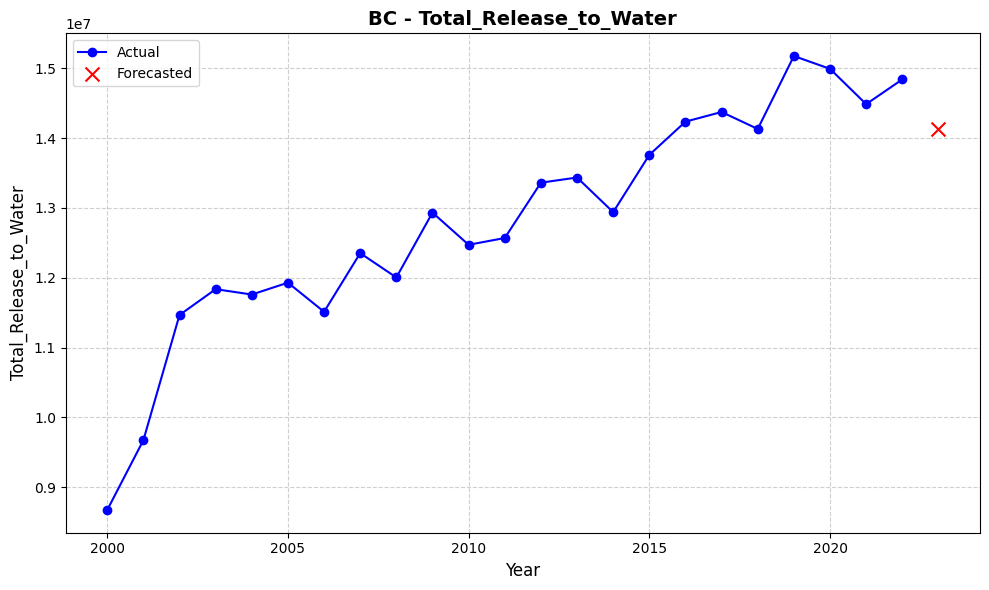

...

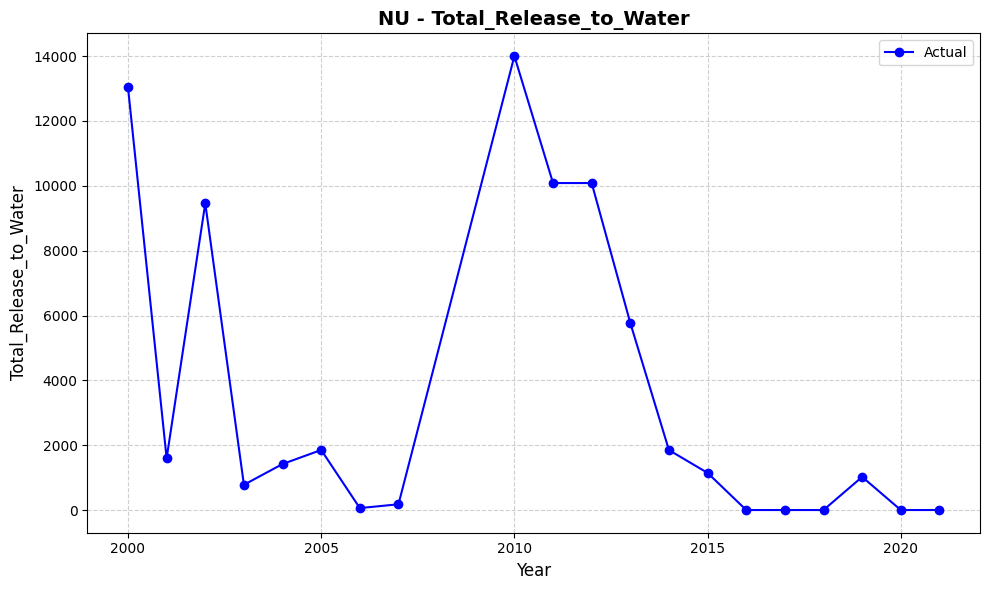

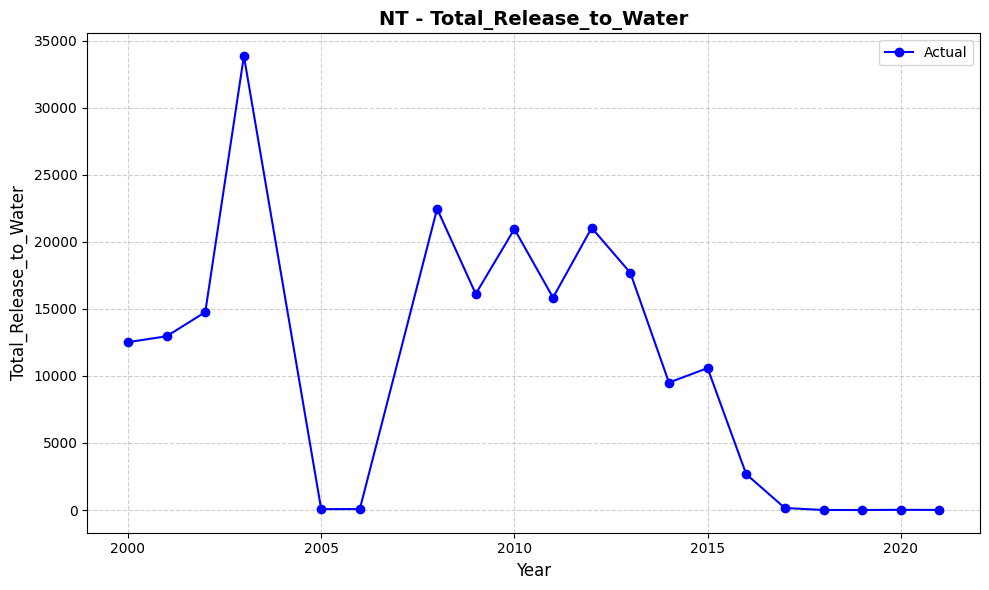

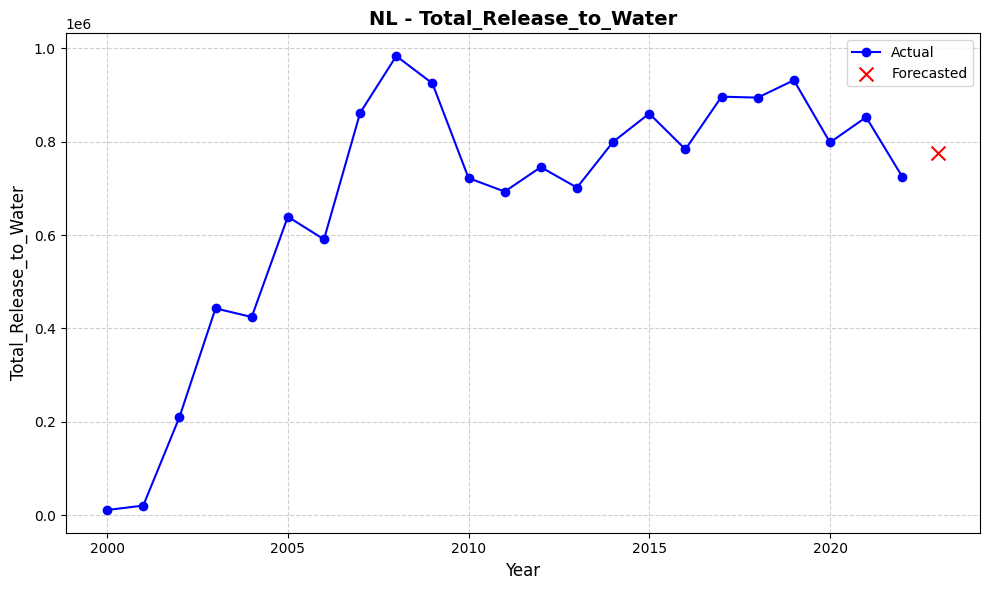

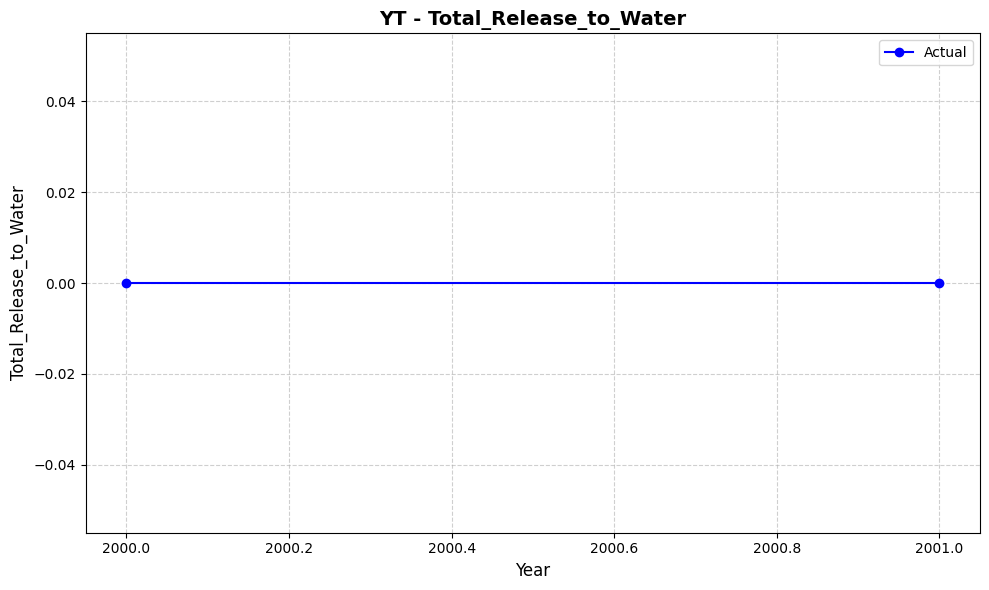

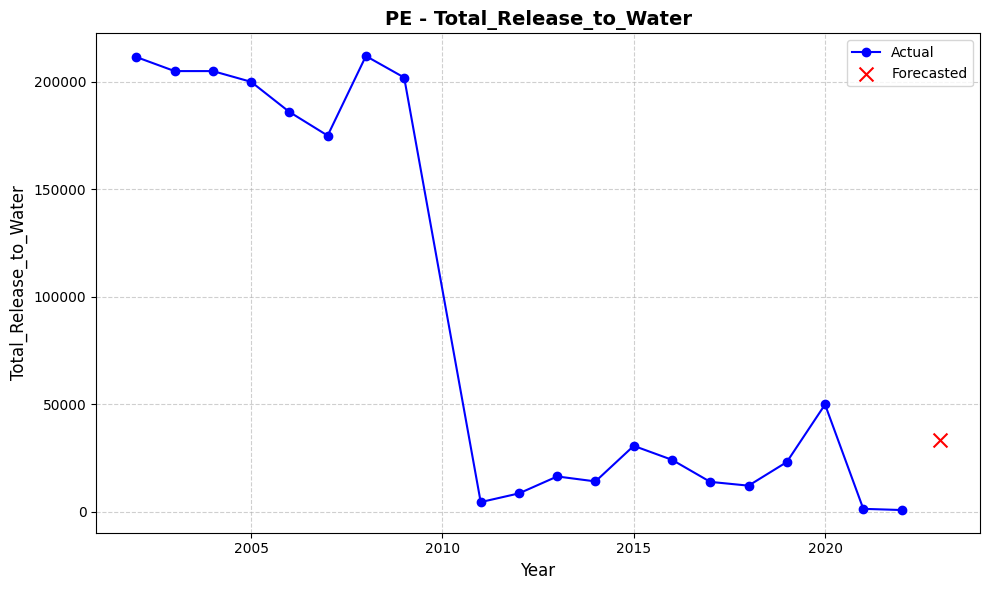

In [ ]:
plot_actual_vs_forecasted_aggregated(data_NPRI_ammonia_2, future_forecasts_ammonia, 'Total_Release_to_Water')

## Forecast for Phosphorus

In [ ]:
X_val_phosphorus_corr

,num__Number_of_Employees,num__Release_to_Air(Fugitive),num__Release_to_Air(Other_Non-Point),num__Release_to_Air(Road dust),num__Release_to_Air(Spills),num__Release_to_Air(Storage/Handling),num__Release_to_Air(Stack/Point),num__Releases_to_Land(Leaks),num__Releases_to_Land(Other),num__Releases_to_Land(Spills),num__Sum_of_release_to_all_media_(<1tonne),num__Population,cat1__PROVINCE_AB,cat1__PROVINCE_BC,cat1__PROVINCE_MB,cat1__PROVINCE_NB,cat1__PROVINCE_NL,cat1__PROVINCE_NS,cat1__PROVINCE_NT,cat1__PROVINCE_NU,cat1__PROVINCE_PE,cat1__PROVINCE_QC,cat1__PROVINCE_SK,cat1__Estimation_Method/Méthode_d’estimation_(blank),cat1__Estimation_Method/Méthode_d’estimation_C - Mass Balance,cat1__Estimation_Method/Méthode_d’estimation_E1 - Site Specific Emission Factors,cat1__Estimation_Method/Méthode_d’estimation_E2 - Published Emission Factors,cat1__Estimation_Method/Méthode_d’estimation_M1 - Continuous Emission Monitoring,cat1__Estimation_Method/Méthode_d’estimation_M2 - Predictive Emission Monitoring,cat1__Estimation_Method/Méthode_d’estimation_M3 - Source Testing,cat1__Estimation_Method/Méthode_d’estimation_NI - No Information Available,cat1__Estimation_Method/Méthode_d’estimation_O - Engineering Estimates,cat2__Company_Name/Dénomination_sociale_de_l'entreprise,cat2__NAICS/Code_SCIAN
0,0.136092,-0.076905,-0.034889,0.0,-0.036701,-0.024564,-0.108221,-0.016388,-0.119378,-0.028631,-0.230304,-1.030142,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,20925.755662,15968.305121
1,0.093124,-0.076905,-0.034889,0.0,-0.036701,-0.024564,-0.108221,-0.016388,-0.119378,-0.028631,-0.230304,-1.459362,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,22836.879010,12741.222500
2,-0.263513,-0.076905,-0.034889,0.0,-0.036701,-0.024564,-0.108221,-0.016388,-0.119378,-0.028631,0.673425,-1.459362,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3589.409584,1962.693346
3,-0.236657,-0.076905,-0.034889,0.0,-0.036701,-0.024564,-0.108221,-0.016388,-0.119378,-0.028631,0.593094,0.896982,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,3589.409584,1962.693346
4,-0.263513,-0.076905,-0.034889,0.0,-0.036701,-0.024564,-0.108221,-0.016388,-0.119378,-0.028631,6.798698,-1.494692,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3589.409584,1962.693346
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7088,-0.315075,-0.076905,-0.034889,0.0,-0.036701,-0.024564,-0.108221,-0.016388,-0.119378,-0.028631,-0.230304,1.435322,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,13575.956716,186.263111
7089,-0.323668,-0.076905,-0.034889,0.0,-0.036701,-0.024564,-0.108221,-0.016388,-0.119378,-0.028631,-0.230304,1.435322,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,16674.814458,31604.876476
7090,-0.320446,-0.076905,-0.034889,0.0,-0.036701,-0.024564,-0.108221,-0.016388,-0.119378,-0.028631,-0.230304,-0.605564,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,67934.967767,31604.876476
7091,0.254255,0.783359,-0.034889,0.0,-0.036701,-0.024564,-0.108221,-0.016388,-0.119378,-0.028631,-0.230304,-0.605564,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,17116.009393,48.073549


In [ ]:
# copy of the train and test sets
train_phosphorus_forecast= train_phosphorus.copy()
test_phosphorus_forecast = test_phosphorus.copy()

In [ ]:
# Combine train and test data into a single dataframe
data_NPRI_phosphorus_2 = pd.concat([train_phosphorus_forecast, test_phosphorus_forecast], axis=0)

# Reset the index of the combined dataframe
data_NPRI_phosphorus_2.reset_index(drop=True, inplace=True)

In [ ]:
data_NPRI_phosphorus_2.columns

Index(['Reporting_Year/Année', 'NPRI_ID/No_INRP', 'Number_of_Employees',
       'Company_Name/Dénomination_sociale_de_l'entreprise',
       'Facility_Name/Installation', 'NAICS/Code_SCIAN',
       'NAICS Title/Titre_Code_SCIAN', 'PROVINCE', 'City', 'Latitude',
       'Longitude', 'CAS_Number/No_CAS',
       'Estimation_Method/Méthode_d’estimation', 'Release_to_Air(Fugitive)',
       'Release_to_Air(Other_Non-Point)', 'Release_to_Air(Road dust)',
       'Release_to_Air(Spills)', 'Release_to_Air(Stack/Point)',
       'Release_to_Air(Storage/Handling)', 'Releases_to_Land(Leaks)',
       'Releases_to_Land(Other)', 'Releases_to_Land(Spills)',
       'Sum_of_release_to_all_media_(<1tonne)', 'Population',
       'Total_Release_to_Water', 'Region'],
      dtype='object')

In [ ]:
def forecast_future_years_with_metrics2(data, start_year, end_year, n_lags=5, target='Total_Release_to_Water', params=None):
    """
    Forecast pollutant release by province for future years using RandomForestRegressor,
    and calculate evaluation metrics.

    Parameters:
    - data (pd.DataFrame): Historical dataset containing features and target.
    - start_year (int): Start year for the forecast.
    - end_year (int): End year for the forecast.
    - n_lags (int): Number of lagged features to create.
    - target (str): Target variable to forecast.
    - params (dict, optional): Parameters for RandomForestRegressor.

    Returns:
    - future_forecasts (pd.DataFrame): Forecasted total release aggregated by province for each year.
    - metrics (dict): Evaluation metrics (RMSE, MAE, R²) for the model.
    """
    def create_lags_no_group(df, feature, n_lags):
        """Create lagged features for the target and predictors."""
        for i in range(1, n_lags + 1):
            df[f'{feature}_lag{i}'] = df[feature].shift(i)
        return df

    # Define lagged features
    pollutants = [target]
    additional_features = [
        'Population',
        'Number_of_Employees',
        'Release_to_Air(Fugitive)',
        'Release_to_Air(Other_Non-Point)',
        'Release_to_Air(Road dust)',
        'Release_to_Air(Spills)',
        'Release_to_Air(Stack/Point)',
        'Release_to_Air(Storage/Handling)',
        'Releases_to_Land(Leaks)',
        'Releases_to_Land(Other)',
        'Releases_to_Land(Spills)',
        'Sum_of_release_to_all_media_(<1tonne)'
    ]

    for feature in pollutants + additional_features:
        data = create_lags_no_group(data, feature, n_lags)

    # Drop missing values (introduced by lagging)
    data = data.dropna()

    # One-hot encode categorical variables
    province_encoded = pd.get_dummies(data['PROVINCE'], prefix='PROVINCE', drop_first=True, dtype=int)
    data = pd.concat([data, province_encoded], axis=1)

    # Define features for training
    features = [f'{pollutant}_lag{i}' for pollutant in pollutants for i in range(1, n_lags + 1)] + \
               [f'{feature}_lag{i}' for feature in additional_features for i in range(1, n_lags + 1)] + \
               list(province_encoded.columns)

    # Add region if available
    if 'Region' in data.columns:
        features += ['Region']

    # Initialize model
    pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('regressor', RandomForestRegressor(random_state=42, **params if params else {}))
    ])

    # Train on historical data up to the start year - 1 to have data for the start year in the test set
    train_data = data[data['Reporting_Year/Année'] < start_year -1] # Changed to start_year - 1
    test_data = data[data['Reporting_Year/Année'] >= start_year - 1] # Changed to start_year - 1

    X_train = train_data[features]
    y_train = train_data[target]
    X_test = test_data[features]
    y_test = test_data[target]

    # Fit the model
    pipeline.fit(X_train, y_train)

    # Evaluate the model
    y_pred = pipeline.predict(X_test)
    metrics = {
        'Root Mean Squared Error': root_mean_squared_error(y_test, y_pred),
        'Mean Absolute Error': mean_absolute_error(y_test, y_pred),
        'R² Score': r2_score(y_test, y_pred)
    }

    # Create a DataFrame to store forecasted values
    future_forecasts = []

    # Forecast for each year in the range
    for year in range(start_year, end_year + 1):
        # Generate lagged features for the forecast year
        latest_data = data[data['Reporting_Year/Année'] == year - 1].copy()
        latest_data['Reporting_Year/Année'] = year
        latest_data[target] = pipeline.predict(latest_data[features])

        # Append forecasts to the dataset
        data = pd.concat([data, latest_data], ignore_index=True)

        # Aggregate forecasted values by province
        yearly_forecast = latest_data.groupby('PROVINCE')[[target]].sum()
        yearly_forecast['Year'] = year
        future_forecasts.append(yearly_forecast)

    # Combine all yearly forecasts into a single DataFrame
    future_forecasts = pd.concat(future_forecasts).reset_index()

    return future_forecasts, metrics


In [ ]:
# Forecast total releases by province and get model metrics
future_forecasts_phosphorus, metrics = forecast_future_years_with_metrics2(
    data=data_NPRI_phosphorus_2,
    start_year=2023,
    end_year=2023,
    n_lags=5,
    target='Total_Release_to_Water',
    params={'n_estimators': 200, 'max_depth': 10}
)

# Display the forecasted releases by province
print("Forecasted Releases by Province:")
print(future_forecasts_phosphorus)

# Display model evaluation metrics
print("\nModel Evaluation Metrics:")
for metric, value in metrics.items():
    print(f"{metric}: {value:.4f}")


Forecasted Releases by Province:
   PROVINCE  Total_Release_to_Water  Year
0        AB            5.109414e+05  2023
1        BC            2.015782e+06  2023
2        MB            3.333002e+05  2023
3        NB            1.767769e+05  2023
4        NL            2.163440e+05  2023
5        NS            1.051038e+05  2023
6        NT            9.059446e+03  2023
7        NU            3.095780e+04  2023
8        ON            1.265224e+06  2023
9        PE            2.262727e+04  2023
10       QC            9.045731e+05  2023
11       SK            1.259437e+05  2023

Model Evaluation Metrics:
Root Mean Squared Error: 30939.5443
Mean Absolute Error: 12523.7860
R² Score: 0.5412


In [ ]:
# to compare the RMSE value
std_dev = pd.Series(data_NPRI_phosphorus_2['Total_Release_to_Water']).std()
print(f"Standard Deviation: {std_dev}")

Standard Deviation: 372924.7004234139


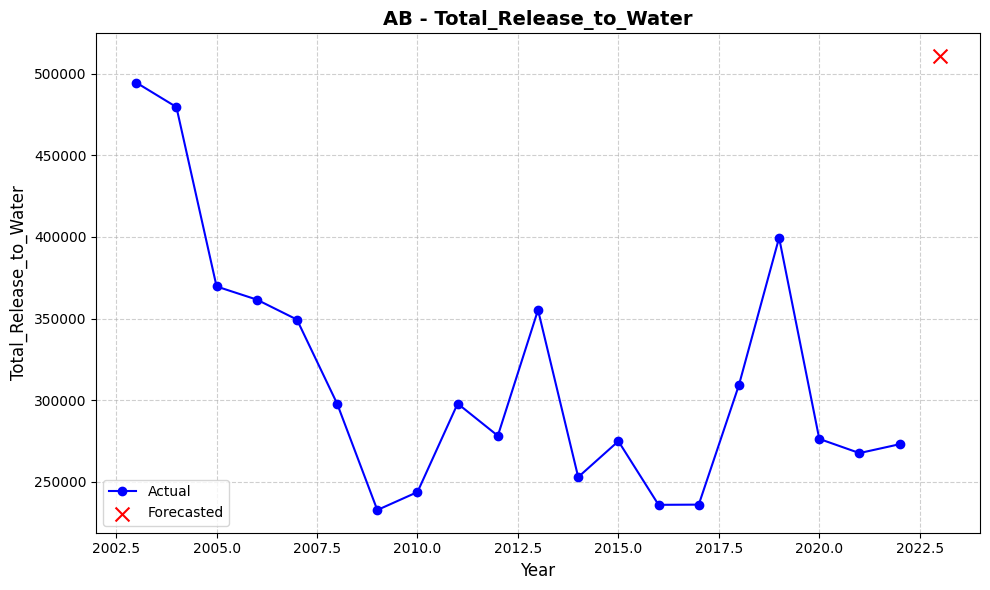

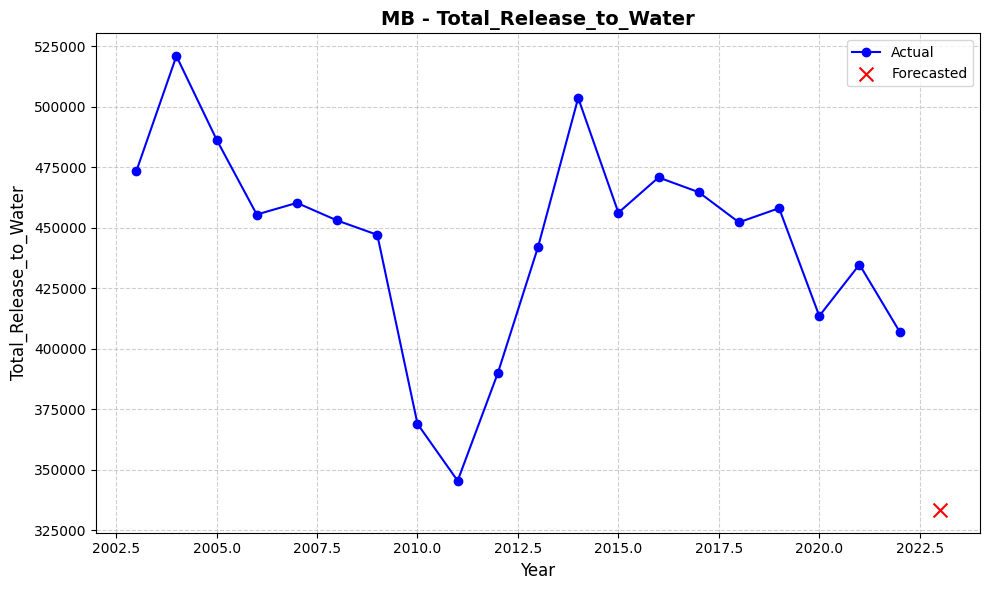

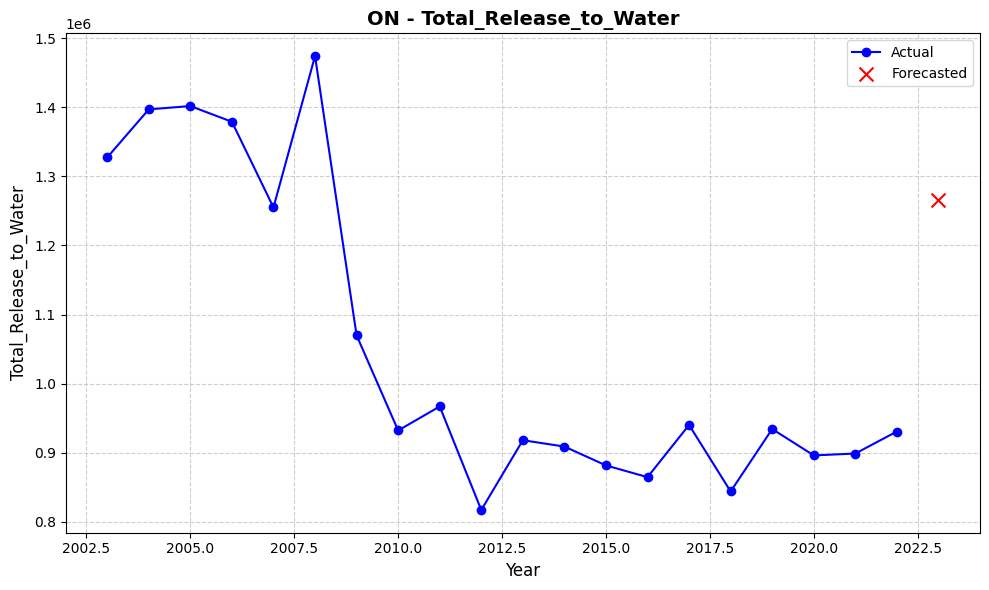

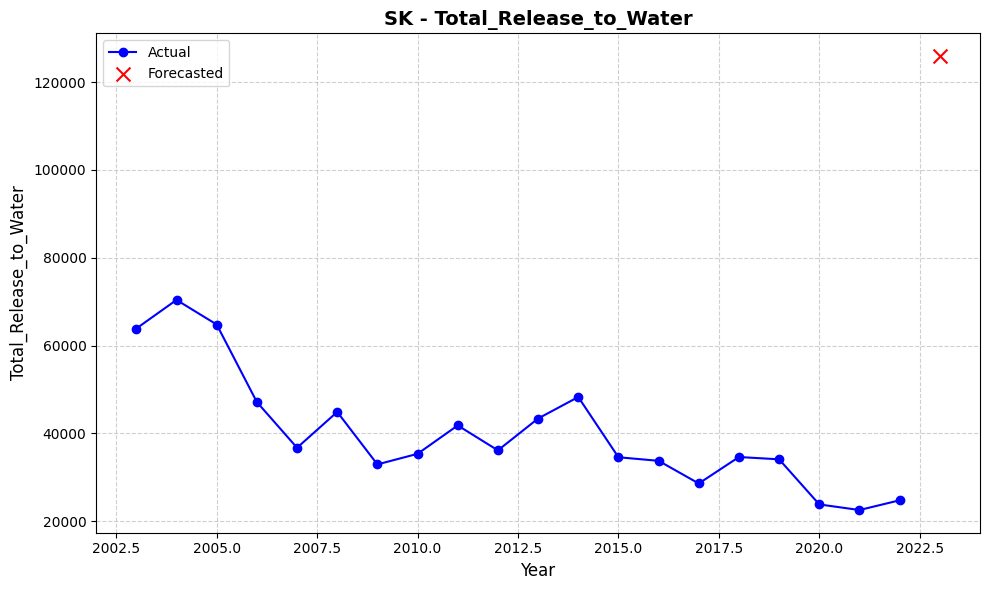

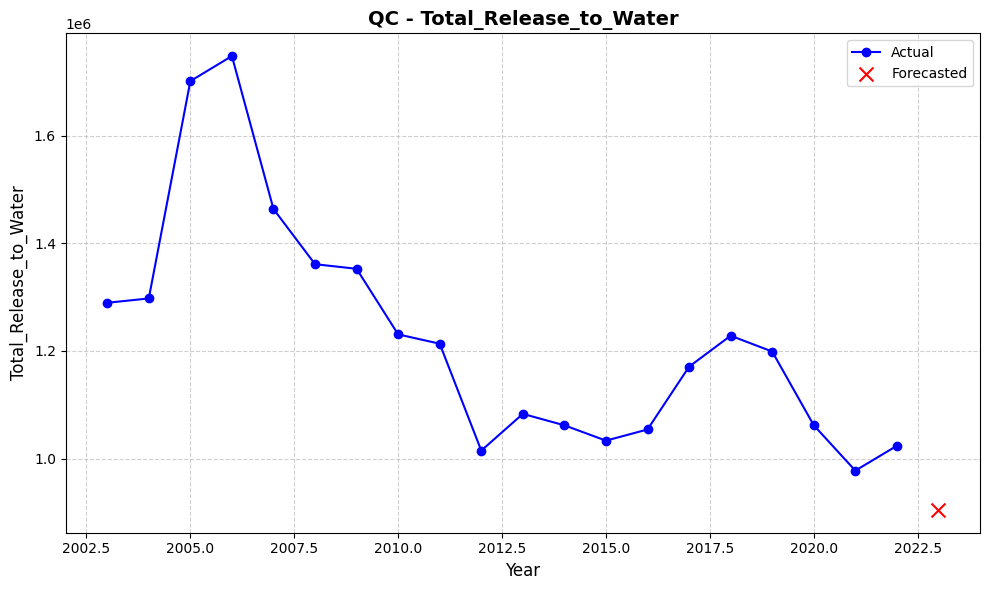

...

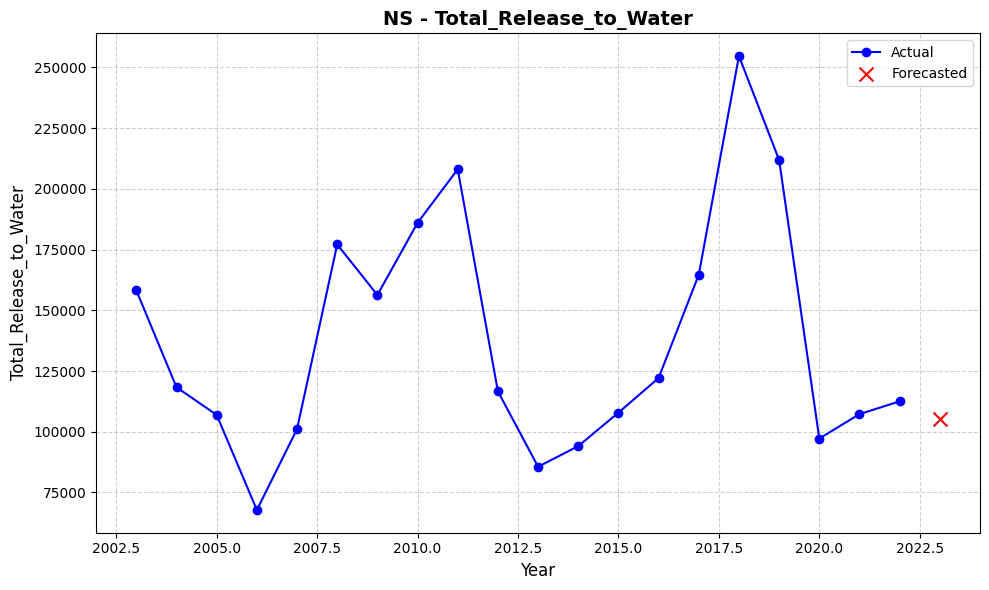

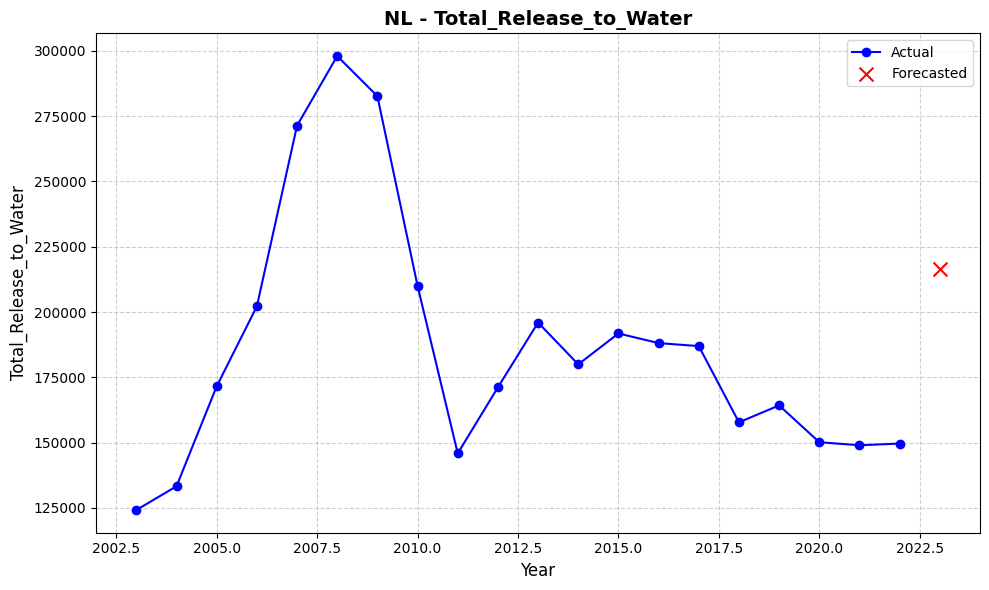

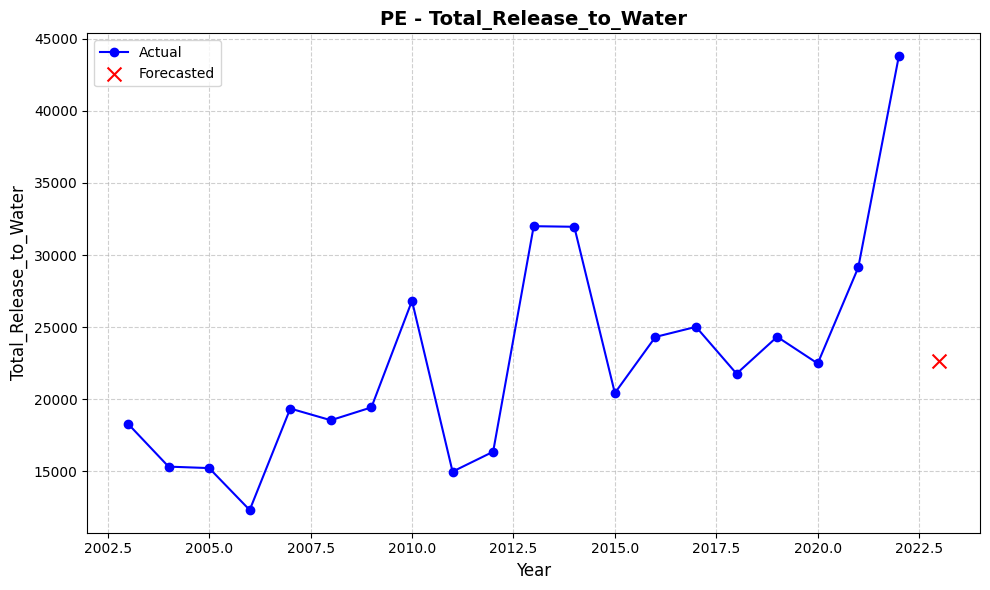

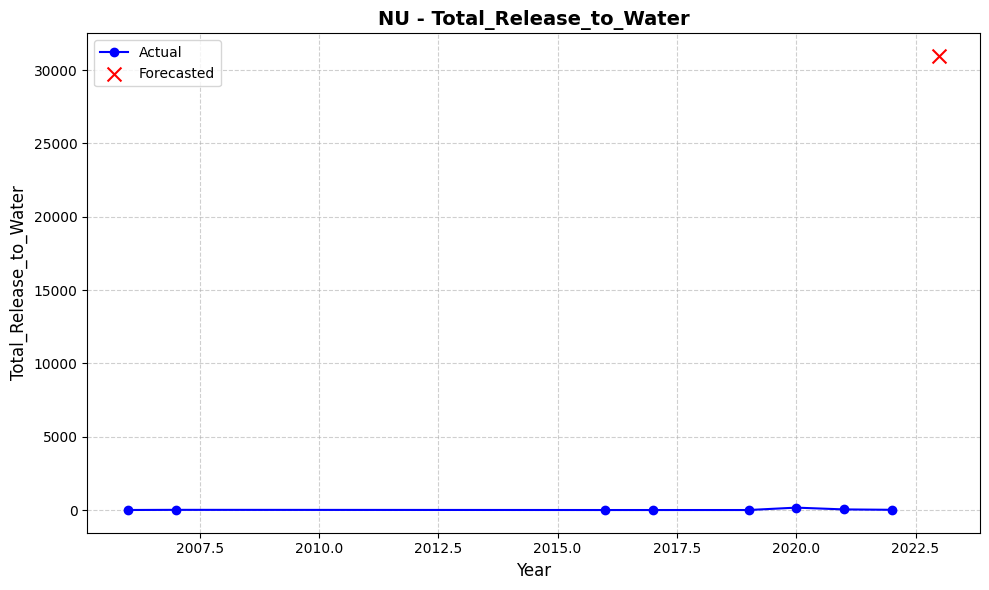

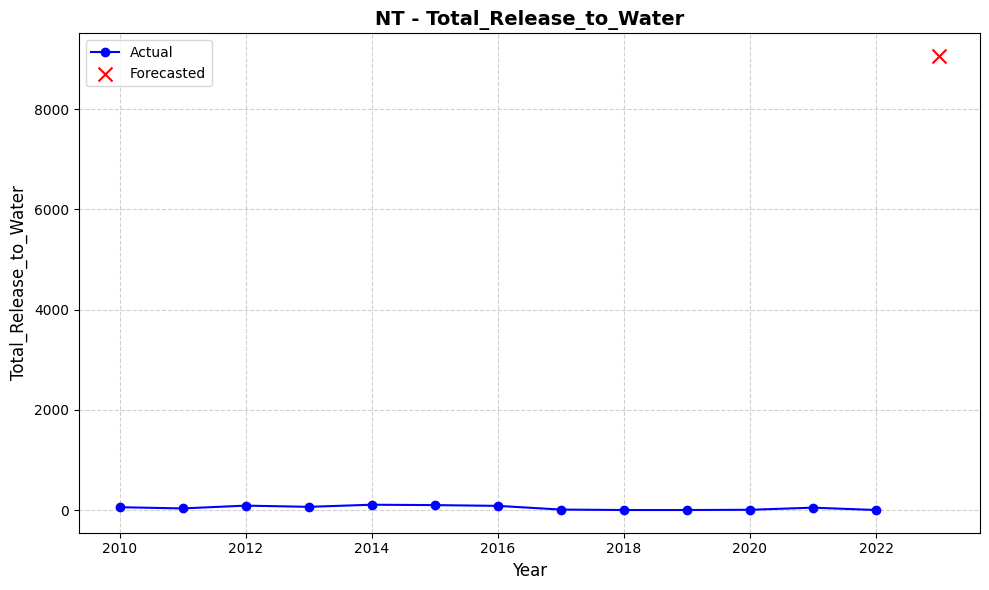

In [ ]:
plot_actual_vs_forecasted_aggregated(data_NPRI_phosphorus_2, future_forecasts_phosphorus, 'Total_Release_to_Water')

## Forecast for Nitrate Ion

In [ ]:
# copy of the train and test sets
train_nitrate_forecast= train_nitrate.copy()
test_nitrate_forecast = test_nitrate.copy()

In [ ]:
# Combine train and test data into a single dataframe
data_NPRI_nitrate_2 = pd.concat([train_nitrate_forecast, test_nitrate_forecast], axis=0)

# Reset the index of the combined dataframe
data_NPRI_nitrate_2.reset_index(drop=True, inplace=True)

In [ ]:
def forecast_future_years_with_metrics3(data, start_year, end_year, n_lags=5, target='Total_Release_to_Water', params=None):
    """
    Forecast pollutant release by province for future years using RandomForestRegressor,
    and calculate evaluation metrics.

    Parameters:
    - data (pd.DataFrame): Historical dataset containing features and target.
    - start_year (int): Start year for the forecast.
    - end_year (int): End year for the forecast.
    - n_lags (int): Number of lagged features to create.
    - target (str): Target variable to forecast.
    - params (dict, optional): Parameters for RandomForestRegressor.

    Returns:
    - future_forecasts (pd.DataFrame): Forecasted total release aggregated by province for each year.
    - metrics (dict): Evaluation metrics (RMSE, MAE, R²) for the model.
    """
    def create_lags_no_group(df, feature, n_lags):
        """Create lagged features for the target and predictors."""
        for i in range(1, n_lags + 1):
            df[f'{feature}_lag{i}'] = df[feature].shift(i)
        return df

    # Define lagged features
    pollutants = [target]
    additional_features = [
        'Population',
        'Number_of_Employees',
        'Release_to_Air(Storage/Handling)',
        'Releases_to_Land(Leaks)',
        'Sum_of_release_to_all_media_(<1tonne)'

    ]

    for feature in pollutants + additional_features:
        data = create_lags_no_group(data, feature, n_lags)

    # Drop missing values (introduced by lagging)
    data = data.dropna()

    # One-hot encode categorical variables
    province_encoded = pd.get_dummies(data['PROVINCE'], prefix='PROVINCE', drop_first=True, dtype=int)
    data = pd.concat([data, province_encoded], axis=1)

    # Perform one-hot encoding for 'Estimation_Method'
    estimation_encoded = pd.get_dummies(data['Estimation_Method/Méthode_d’estimation'], prefix='Estimation_Method', drop_first=True, dtype=int)
    data = pd.concat([data, estimation_encoded], axis=1)

    # perform targegt encoding for 'City' columns
    encoder = ce.TargetEncoder(cols=['City', 'Facility_Name/Installation', 'NAICS Title/Titre_Code_SCIAN', "Company_Name/Dénomination_sociale_de_l'entreprise"])
    data = encoder.fit_transform(data, data[pollutants[0]])



    # Define features for training
    features = [f'{pollutant}_lag{i}' for pollutant in pollutants for i in range(1, n_lags + 1)] + \
               [f'{feature}_lag{i}' for feature in additional_features for i in range(1, n_lags + 1)] + \
               list(province_encoded.columns) +  \
               ['City', 'Facility_Name/Installation', 'NAICS Title/Titre_Code_SCIAN', "Company_Name/Dénomination_sociale_de_l'entreprise"] +  \
               list(estimation_encoded.columns)

    # Add region if available
    if 'Region' in data.columns:
        features += ['Region']

    # Initialize model
    pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('regressor', RandomForestRegressor(random_state=42, **params if params else {}))
    ])

    # Train on historical data up to the start year - 1 to have data for the start year in the test set
    train_data = data[data['Reporting_Year/Année'] < start_year -1] # Changed to start_year - 1
    test_data = data[data['Reporting_Year/Année'] >= start_year - 1] # Changed to start_year - 1

    X_train = train_data[features]
    y_train = train_data[target]
    X_test = test_data[features]
    y_test = test_data[target]

    # Fit the model
    pipeline.fit(X_train, y_train)

    # Evaluate the model
    y_pred = pipeline.predict(X_test)
    metrics = {
        'Root Mean Squared Error': root_mean_squared_error(y_test, y_pred),
        'Mean Absolute Error': mean_absolute_error(y_test, y_pred),
        'R² Score': r2_score(y_test, y_pred)
    }

    # Create a DataFrame to store forecasted values
    future_forecasts = []

    # Forecast for each year in the range
    for year in range(start_year, end_year + 1):
        # Generate lagged features for the forecast year
        latest_data = data[data['Reporting_Year/Année'] == year - 1].copy()
        latest_data['Reporting_Year/Année'] = year
        latest_data[target] = pipeline.predict(latest_data[features])

        # Append forecasts to the dataset
        data = pd.concat([data, latest_data], ignore_index=True)

        # Aggregate forecasted values by province
        yearly_forecast = latest_data.groupby('PROVINCE')[[target]].sum()
        yearly_forecast['Year'] = year
        future_forecasts.append(yearly_forecast)

    # Combine all yearly forecasts into a single DataFrame
    future_forecasts = pd.concat(future_forecasts).reset_index()

    return future_forecasts, metrics


In [ ]:
# Forecast total releases by province and get model metrics
future_forecasts_nitrate, metrics = forecast_future_years_with_metrics3(
    data=data_NPRI_nitrate_2,
    start_year=2023,
    end_year=2023,
    n_lags=5,
    target='Total_Release_to_Water',
    params={'n_estimators': 200, 'max_depth': 10}
)

# Display the forecasted releases by province
print("Forecasted Releases by Province:")
print(future_forecasts_nitrate)

# Display model evaluation metrics
print("\nModel Evaluation Metrics:")
for metric, value in metrics.items():
    print(f"{metric}: {value:.4f}")


/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/usr/local/lib/python3.10/dist-packages/category_encoders/ordinal.py:209: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(v

Forecasted Releases by Province:
  PROVINCE  Total_Release_to_Water  Year
0       AB            1.385600e+07  2023
1       BC            2.865145e+06  2023
2       MB            7.134054e+05  2023
3       NB            9.948897e+05  2023
4       NL            7.175603e+05  2023
5       ON            5.226080e+07  2023
6       PE            7.044364e+05  2023
7       QC            2.917272e+06  2023
8       SK            1.280975e+06  2023

Model Evaluation Metrics:
Root Mean Squared Error: 233954.9489
Mean Absolute Error: 84762.4039
R² Score: 0.9728


In [ ]:
# to compare the RMSE value
std_dev = pd.Series(data_NPRI_nitrate_2['Total_Release_to_Water']).std()
print(f"Standard Deviation: {std_dev}")

Standard Deviation: 1187215.3247673574


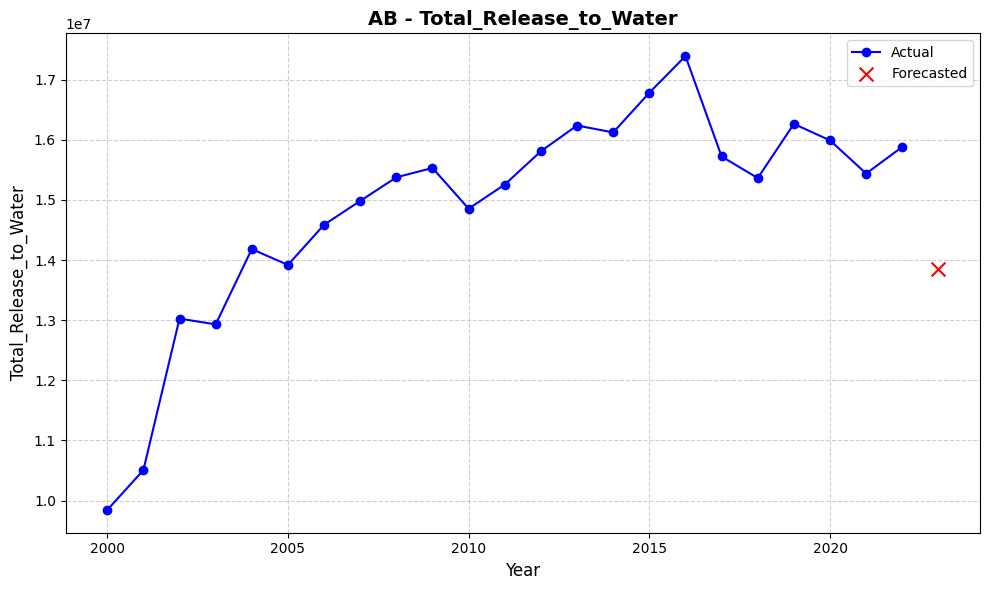

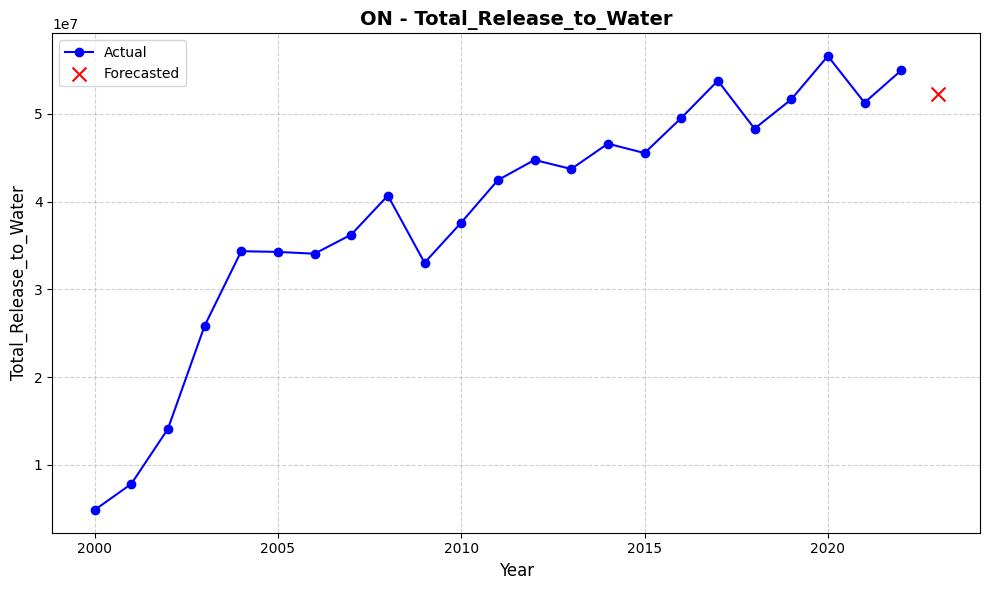

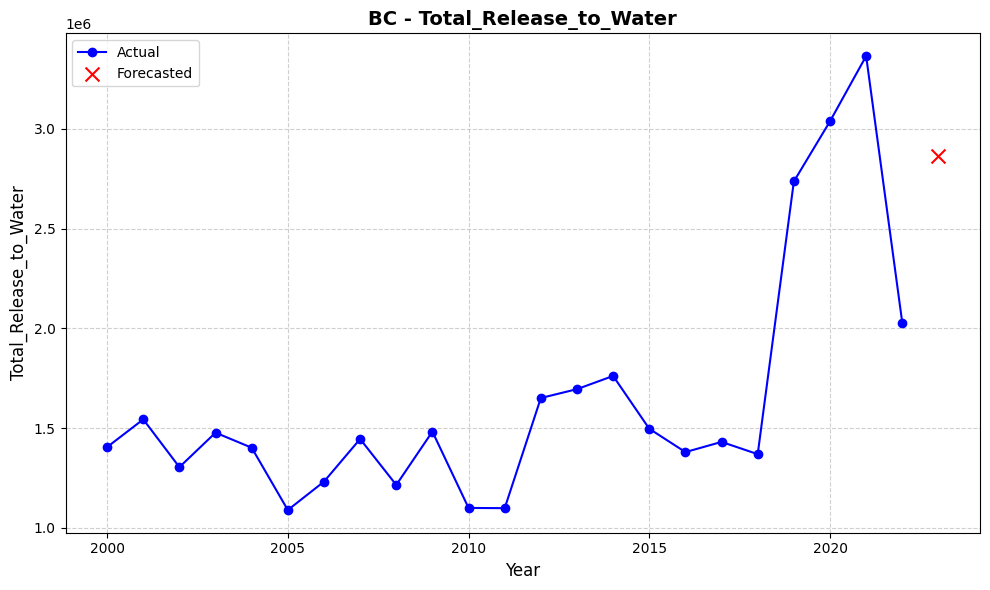

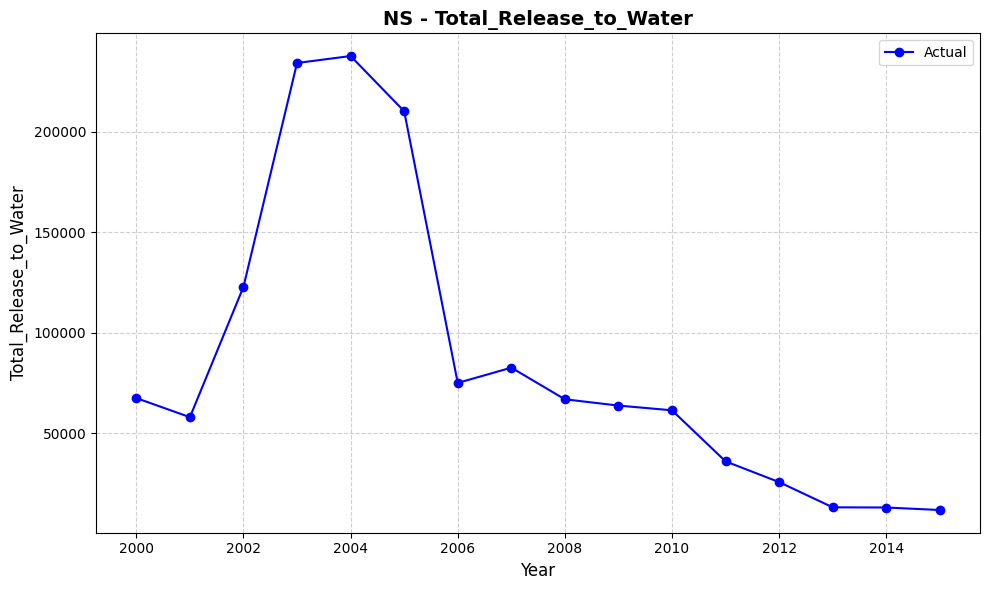

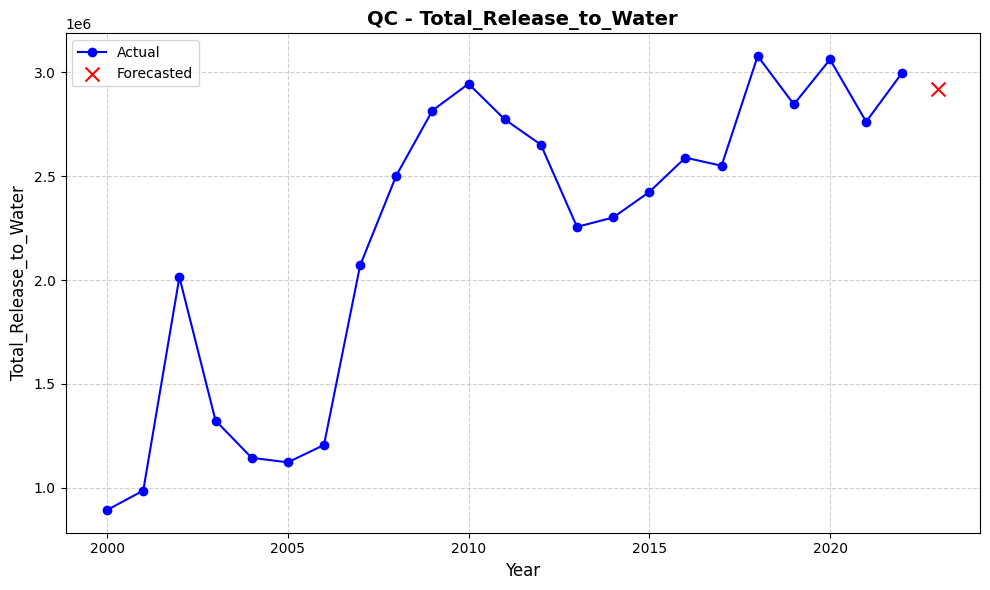

...

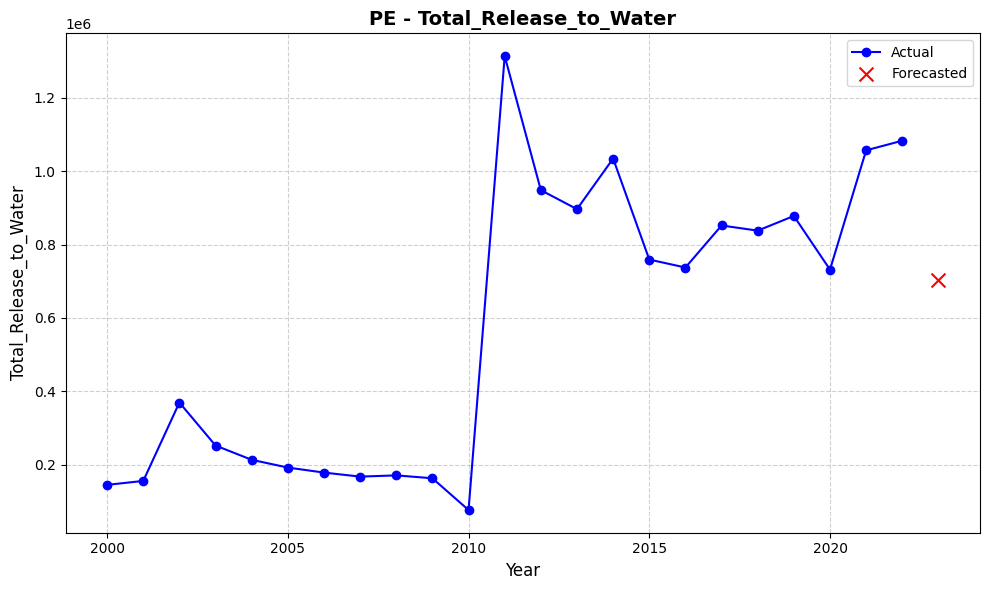

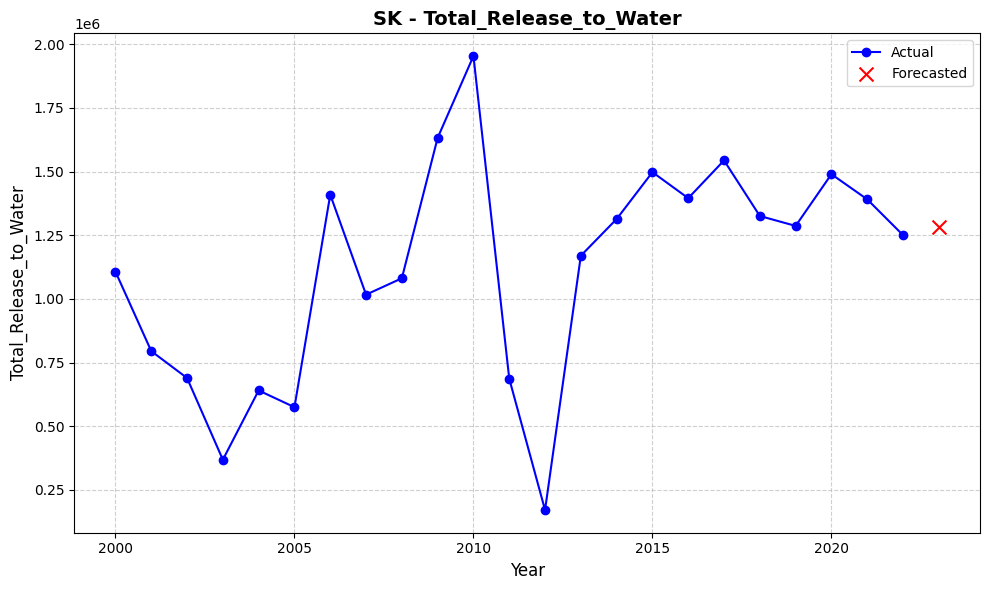

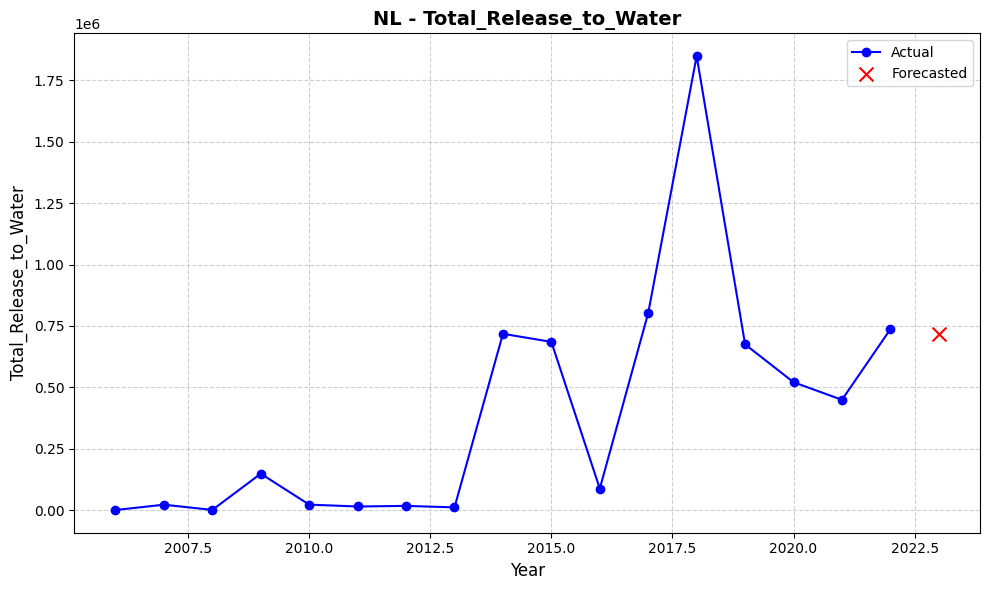

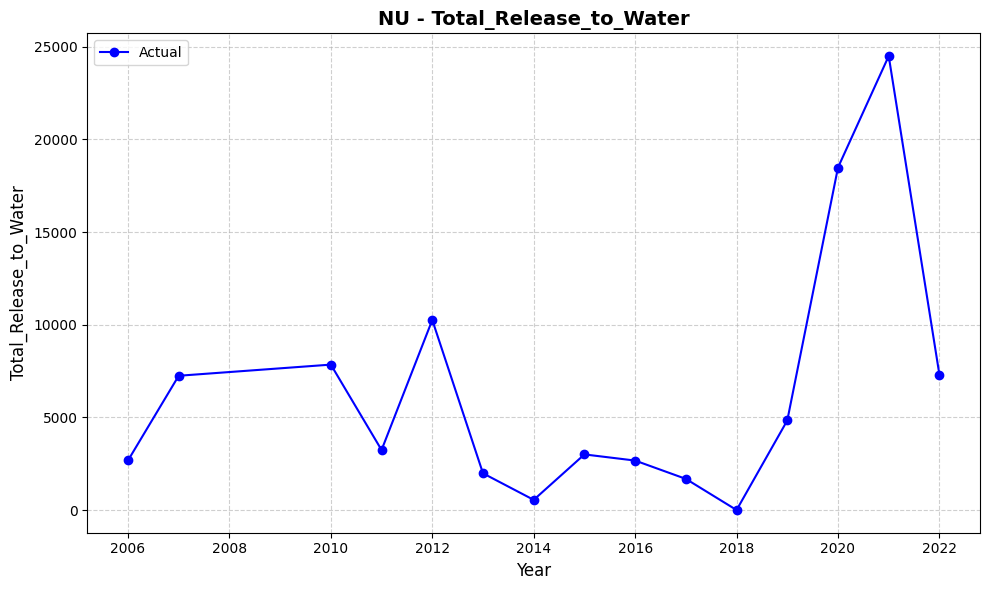

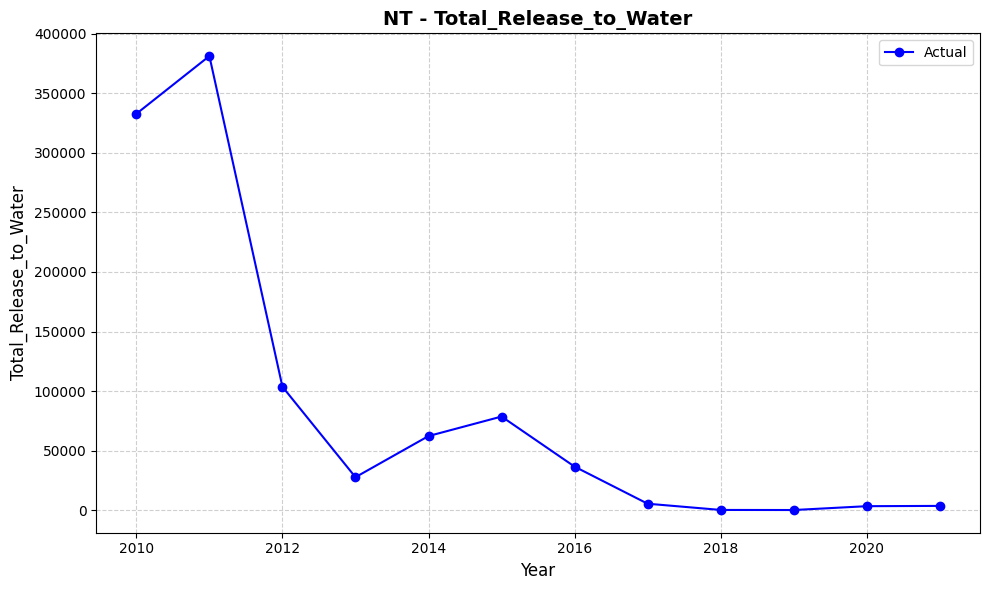

In [ ]:
plot_actual_vs_forecasted_aggregated(data_NPRI_nitrate_2, future_forecasts_nitrate, 'Total_Release_to_Water')

##  Hyperparameter Tuning of all three models

In [ ]:


# Function for hyperparameter tuning and forecasting
def forecast_with_hyperparameter_tuning(data, start_year, end_year, n_lags, target, param_grid):
    # Prepare the dataset for time series forecasting
    data = data.copy()

    # Create lag features
    for lag in range(1, n_lags + 1):
        data[f'lag_{lag}'] = data[target].shift(lag)

    data = data.dropna()  # Remove rows with NaN values caused by lagging

    # We want to predict on future years not present in the data,
    # so we'll fit the final model on all data to use for forecasting.
    # Instead of splitting, we use all available data for training
    train_data = data

    X_train = train_data[[f'lag_{i}' for i in range(1, n_lags + 1)]]
    y_train = train_data[target]

    # Perform hyperparameter tuning
    rf = RandomForestRegressor(random_state=42)
    grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error', verbose=1)
    grid_search.fit(X_train, y_train)

    # Retrieve the best parameters and train the model with them
    best_params = grid_search.best_params_
    best_model = grid_search.best_estimator_

    # Forecast future values
    future_forecasts = []
    # Using the last 'n_lags' values as initial input for forecasting
    current_input = train_data[target].tail(n_lags).values.reshape(1, -1)

    for year in range(start_year, end_year + 1):
        prediction = best_model.predict(current_input)[0]
        future_forecasts.append({'Reporting_Year/Année': year, 'Forecasted_Total_Release': prediction})

        # Update the input for the next year with the predicted value
        current_input = np.roll(current_input, -1)
        current_input[0, -1] = prediction

    # For evaluation, using the entire dataset
    X_all = data[[f'lag_{i}' for i in range(1, n_lags + 1)]]
    y_all = data[target]
    y_pred = best_model.predict(X_all)
    rmse = np.sqrt(mean_squared_error(y_all, y_pred))
    mse = np.mean((y_all - y_pred) ** 2)
    mae = np.mean(np.abs(y_all - y_pred))
    r2 = best_model.score(X_all, y_all)

    metrics = {'MSE': mse, 'MAE': mae, 'R2': r2}

    return future_forecasts, metrics, best_params



Hyperparameter tuning for Ammonia

In [ ]:
# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [5, 10, 15],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Call the function with the provided data
future_forecasts_ammonia, metrics, best_params = forecast_with_hyperparameter_tuning(
    data=data_NPRI_ammonia_2,
    start_year=2023,
    end_year=2023,
    n_lags=5,
    target='Total_Release_to_Water',
    param_grid=param_grid
)

# Display the forecasted releases by province
print("Forecasted Releases by Province:")
print(future_forecasts_ammonia)

# Display model evaluation metrics
print("\nModel Evaluation Metrics:")
for metric, value in metrics.items():
    print(f"{metric}: {value:.4f}")

# Display the best hyperparameters
print("\nBest Hyperparameters:")
print(best_params)

Fitting 3 folds for each of 81 candidates, totalling 243 fits


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names



Forecasted Releases by Province:
[{'Reporting_Year/Année': 2023, 'Forecasted_Total_Release': 22024.51209555799}]

Model Evaluation Metrics:
MSE: 104544890665.5252
MAE: 94077.1681
R2: 0.3525

Best Hyperparameters:
{'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 300}


Hyperparameter tuning for Phosphorus

In [ ]:
# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [5, 10, 15],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Call the function with the provided data
future_forecasts_phosphorus, metrics, best_params = forecast_with_hyperparameter_tuning(
    data=data_NPRI_phosphorus_2,
    start_year=2023,
    end_year=2023,
    n_lags=5,
    target='Total_Release_to_Water',
    param_grid=param_grid
)

# Display the forecasted releases by province
print("Forecasted Releases by Province:")
print(future_forecasts_phosphorus)

# Display model evaluation metrics
print("\nModel Evaluation Metrics:")
for metric, value in metrics.items():
    print(f"{metric}: {value:.4f}")

# Display the best hyperparameters
print("\nBest Hyperparameters:")
print(best_params)

Fitting 3 folds for each of 81 candidates, totalling 243 fits


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names



Forecasted Releases by Province:
[{'Reporting_Year/Année': 2023, 'Forecasted_Total_Release': 4567.288445410706}]

Model Evaluation Metrics:
MSE: 109026843085.5756
MAE: 20329.6422
R2: 0.2164

Best Hyperparameters:
{'max_depth': 15, 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 300}


Hyperparameter for Nitrate

In [ ]:
# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [5, 10, 15],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Call the function with the provided data
future_forecasts_nitrate, metrics, best_params = forecast_with_hyperparameter_tuning(
    data=data_NPRI_nitrate_2,
    start_year=2023,
    end_year=2023,
    n_lags=5,
    target='Total_Release_to_Water',
    param_grid=param_grid
)

# Display the forecasted releases by province
print("Forecasted Releases by Province:")
print(future_forecasts_nitrate)

# Display model evaluation metrics
print("\nModel Evaluation Metrics:")
for metric, value in metrics.items():
    print(f"{metric}: {value:.4f}")

# Display the best hyperparameters
print("\nBest Hyperparameters:")
print(best_params)

Fitting 3 folds for each of 81 candidates, totalling 243 fits
Forecasted Releases by Province:
[{'Reporting_Year/Année': 2023, 'Forecasted_Total_Release': 81159.18923049809}]

Model Evaluation Metrics:
MSE: 249740587342.1002
MAE: 225533.9271
R2: 0.8231

Best Hyperparameters:
{'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 100}


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names



# **Insights and Conclusion**

## Plot of Pollution Releases by Provinces

In [ ]:


def plot_forecasted_pollution(data, value_column, title, ylabel='Pollution'):
    """
    Plots a bar chart of forecasted pollution by province.

    Args:
        data (DataFrame): Data containing the provinces and forecasted pollution values.
        value_column (str): The column name for the pollution values to be plotted.
        title (str): The title of the chart.
        ylabel (str, optional): The label for the y-axis. Defaults to 'Pollution'.
    """
    # Define a list of colors - one for each province
    colors = ['skyblue', 'lightgreen', 'salmon', 'gold', 'coral',
              'limegreen', 'lightcoral', 'mediumseagreen', 'orange', 'plum']

    # Create a bar chart
    plt.figure(figsize=(12, 6))
    plt.bar(data['PROVINCE'], data[value_column], color=colors[:len(data['PROVINCE'])], edgecolor='black')

    # Add labels and title
    plt.xlabel('Province', fontsize=12)
    plt.ylabel(ylabel, fontsize=12)
    plt.title(title, fontsize=14, fontweight='bold')

    # Format y-axis for better readability
    plt.ticklabel_format(style='plain', axis='y')
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.grid(axis='y', linestyle='--', alpha=0.6)

    # Show the chart
    plt.tight_layout()
    plt.show()




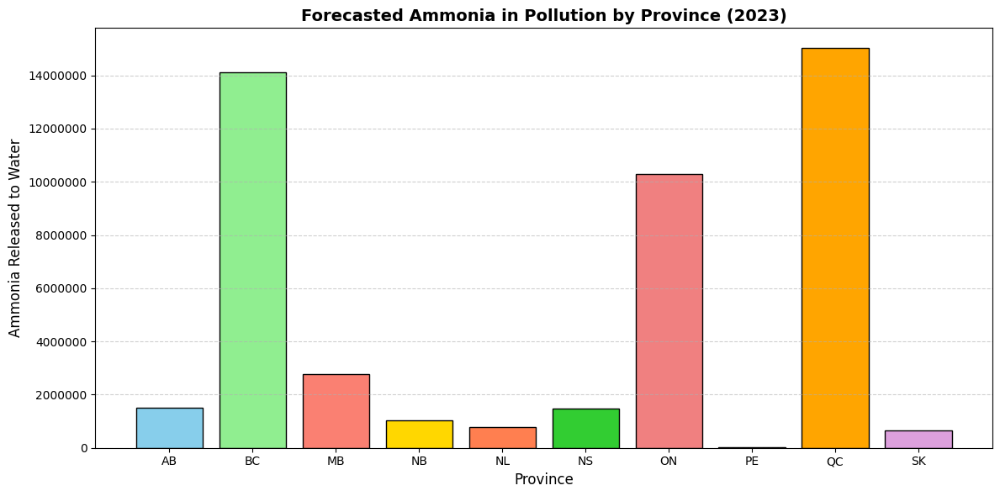

In [ ]:

plot_forecasted_pollution(
    data=future_forecasts_ammonia,
    value_column='Total_Release_to_Water',
    title='Forecasted Ammonia in Pollution by Province (2023)',
    ylabel='Ammonia Released to Water'
)

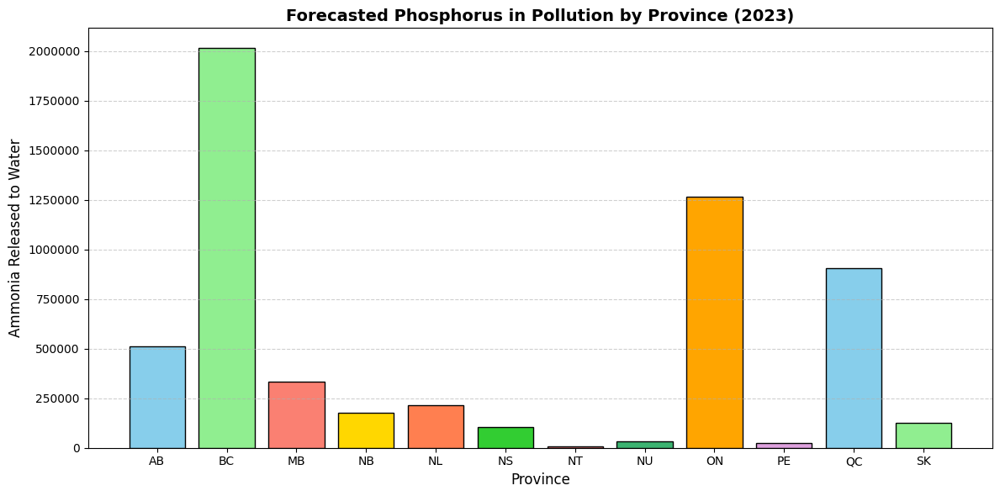

In [ ]:

plot_forecasted_pollution(
    data=future_forecasts_phosphorus,
    value_column='Total_Release_to_Water',
    title='Forecasted Phosphorus in Pollution by Province (2023)',
    ylabel='Ammonia Released to Water'
)

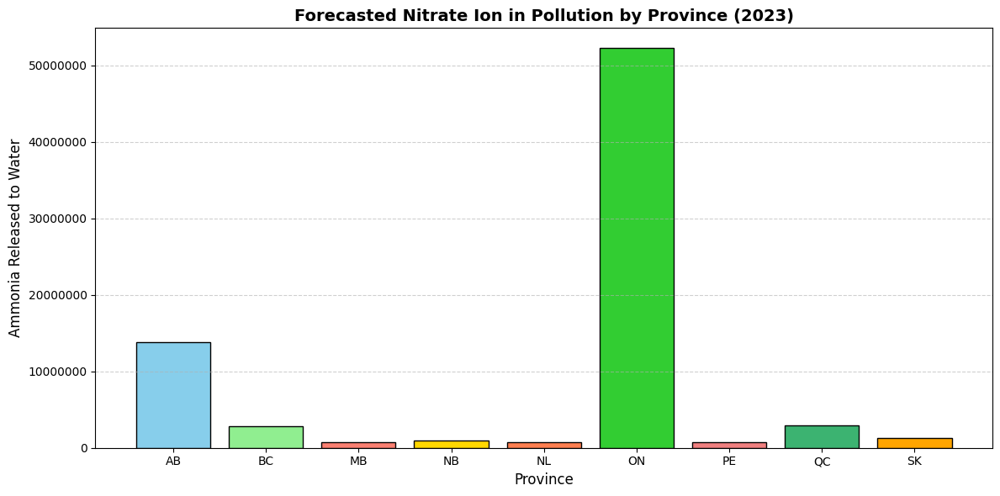

In [ ]:

plot_forecasted_pollution(
    data=future_forecasts_nitrate,
    value_column='Total_Release_to_Water',
    title='Forecasted Nitrate Ion in Pollution by Province (2023)',
    ylabel='Ammonia Released to Water'
)

In [ ]:
def plot_actual_vs_forecasted_with_population(data, future_forecasts, target, population_data):
    """
    Plots actual pollutant values (2000–2022), forecasted value (2023),
    and population trends for each province.

    Args:
        data (DataFrame): DataFrame containing the original pollutant data.
        future_forecasts (DataFrame): DataFrame containing the forecasted values.
        target (str): The target pollutant column name.
        population_data (DataFrame): DataFrame containing population data by province and year.
                                      Expected columns: ['PROVINCE', 'Year', 'Population']
    """
    provinces = data['PROVINCE'].unique()

    for province in provinces:
        fig, ax1 = plt.subplots(figsize=(10, 6))

        # Aggregate actual data for the specific province and years up to 2022
        province_data = (data[(data['PROVINCE'] == province) &
                              (data['Reporting_Year/Année'] <= 2022)]
                         .groupby('Reporting_Year/Année')[target]
                         .sum()  # Change to mean() if appropriate
                         .reset_index())

        # Plot actual pollutant values (2000–2022)
        if not province_data.empty:
            ax1.plot(province_data['Reporting_Year/Année'], province_data[target],
                     label='Pollutant - Actual', marker='o', color='blue', linestyle='-')

        # Filter forecast data for the province and the year 2023
        forecast_data = future_forecasts[(future_forecasts['PROVINCE'] == province) &
                                         (future_forecasts['Year'] == 2023)]

        # Plot forecasted pollutant value for 2023
        if not forecast_data.empty:
            ax1.scatter(forecast_data['Year'], forecast_data[target],
                        color='red', label='Pollutant - Forecasted', marker='x', s=100)

        # Format primary y-axis for pollutant
        ax1.set_ylabel(target, fontsize=12, color='blue')
        ax1.tick_params(axis='y', labelcolor='blue')
        ax1.set_xlabel('Year', fontsize=12)

        # Overlay population trends on a secondary y-axis
        ax2 = ax1.twinx()  # Create a secondary y-axis
        province_population = population_data[population_data['PROVINCE'] == province]

        if not province_population.empty:
            # Changed 'Year' to 'Reporting_Year/Année' to match the column name in df_population
            ax2.plot(province_population['Reporting_Year/Année'], province_population['Population'],
                     label='Population', marker='^', color='green', linestyle='--')

        # Format secondary y-axis for population
        ax2.set_ylabel('Population', fontsize=12, color='green')
        ax2.tick_params(axis='y', labelcolor='green')

        # Add legends and title
        ax1.legend(loc='upper left', fontsize=10)
        ax2.legend(loc='upper right', fontsize=10)
        ax1.set_title(f'{province} - {target} and Population Trends', fontsize=14, fontweight='bold')

        # Add grid and improve layout
        ax1.grid(True, linestyle='--', alpha=0.6)
        plt.tight_layout()
        plt.show()

## Population and Ammonia Trends

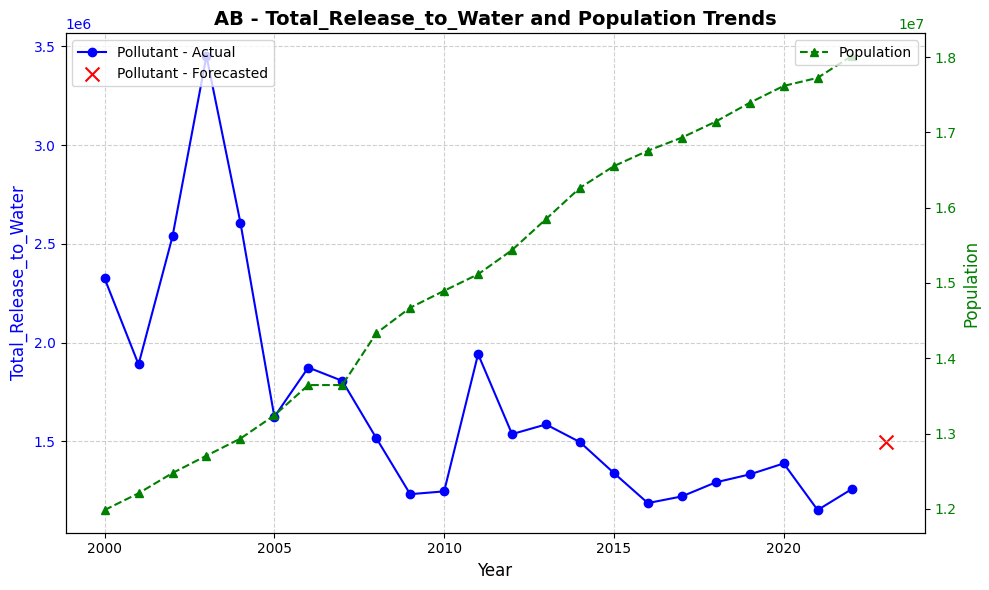

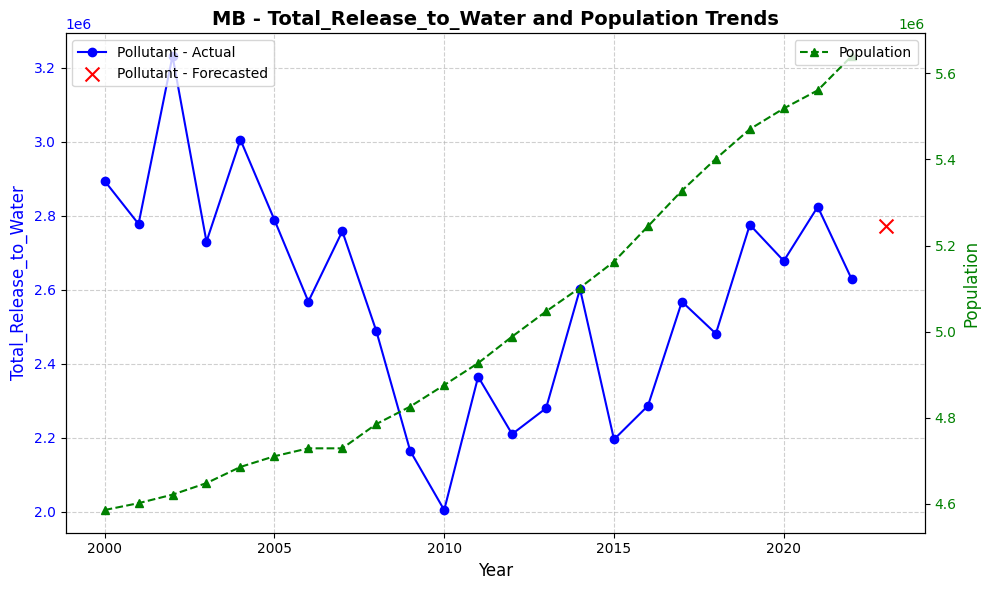

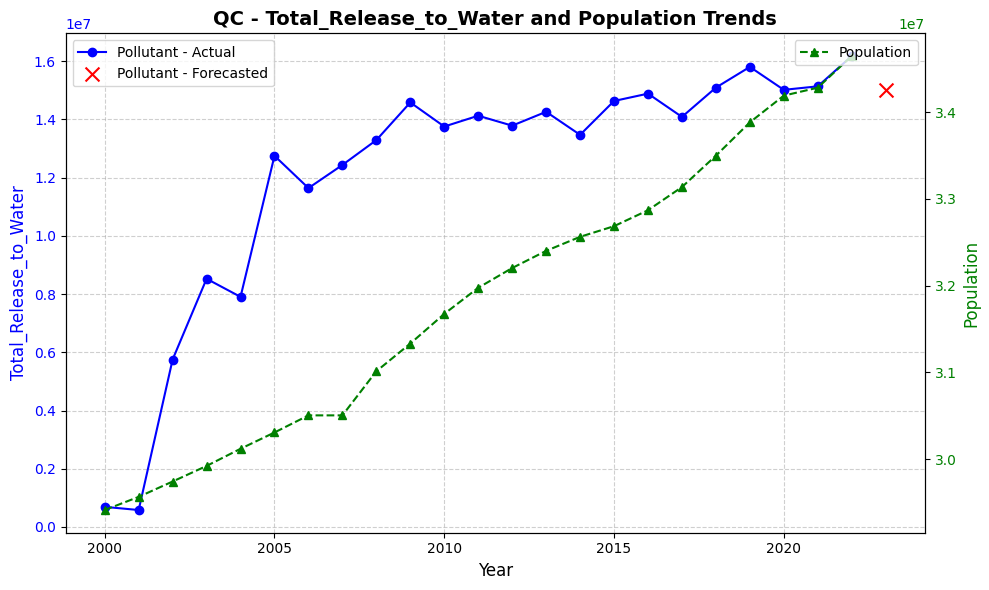

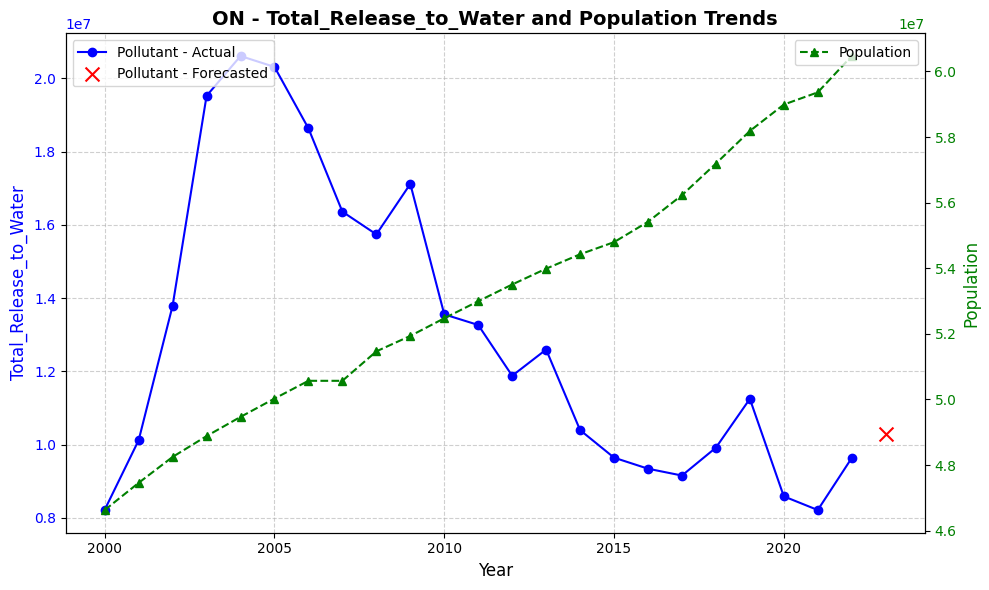

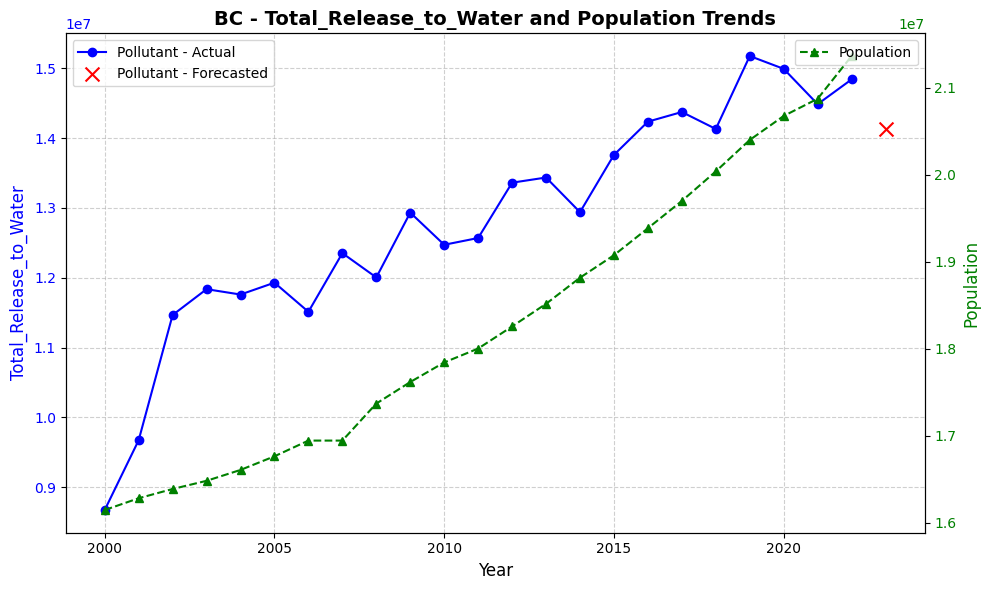

...

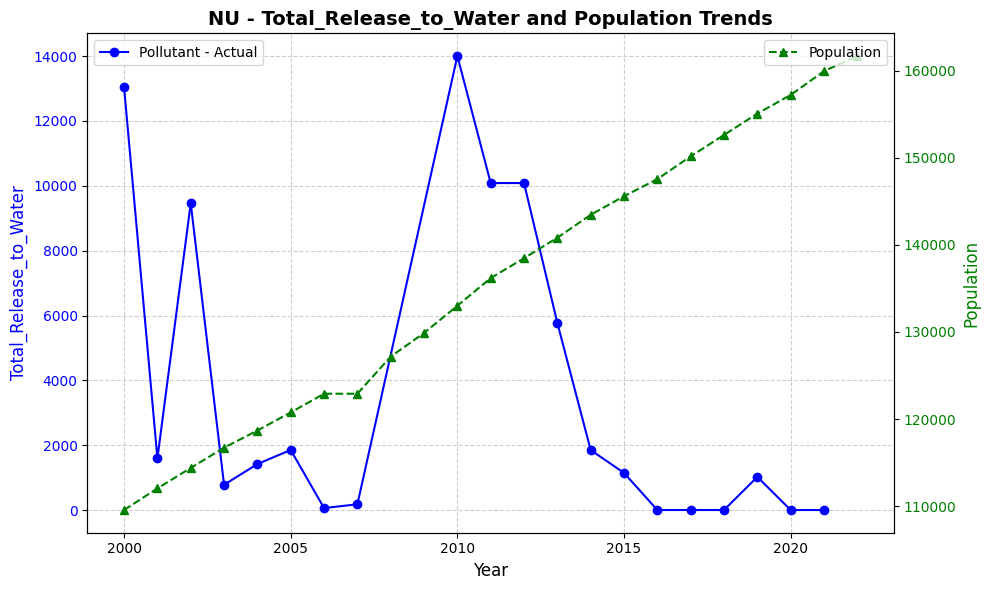

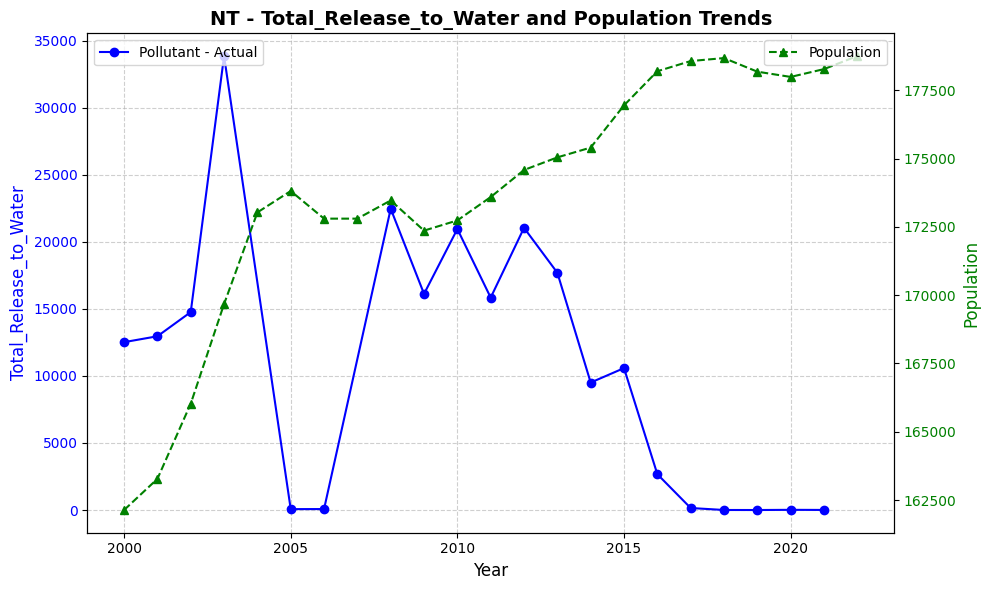

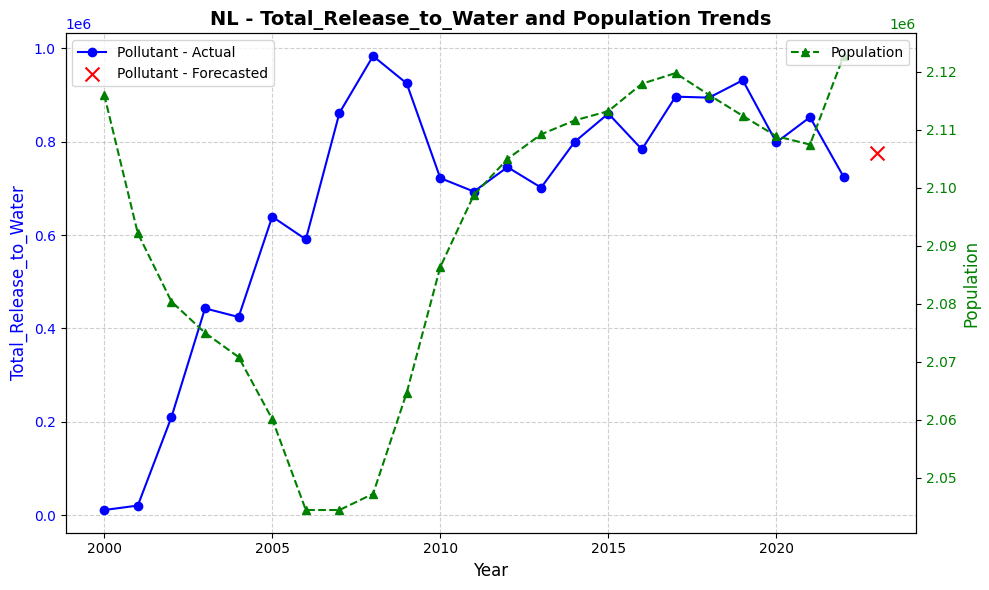

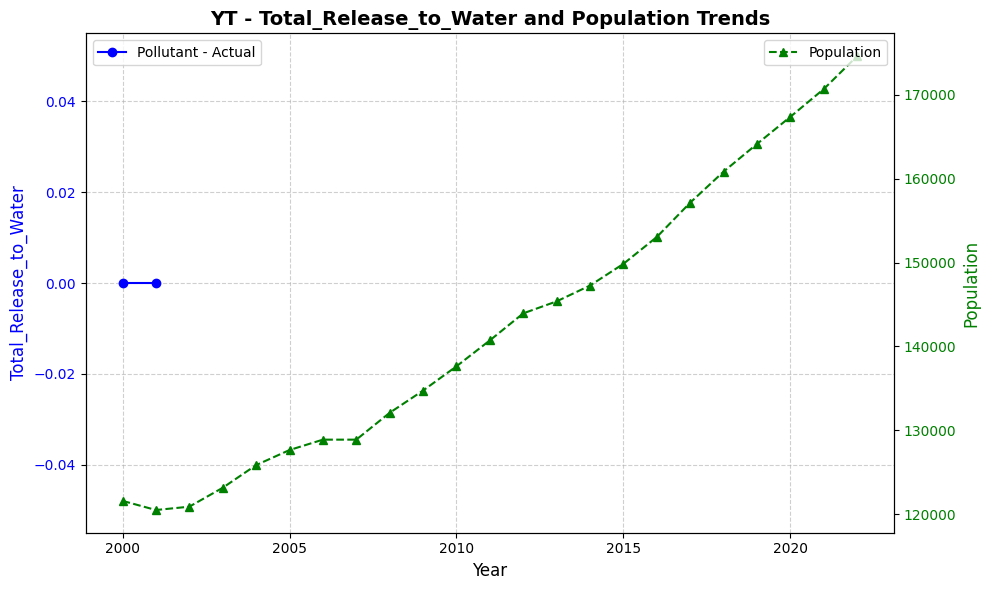

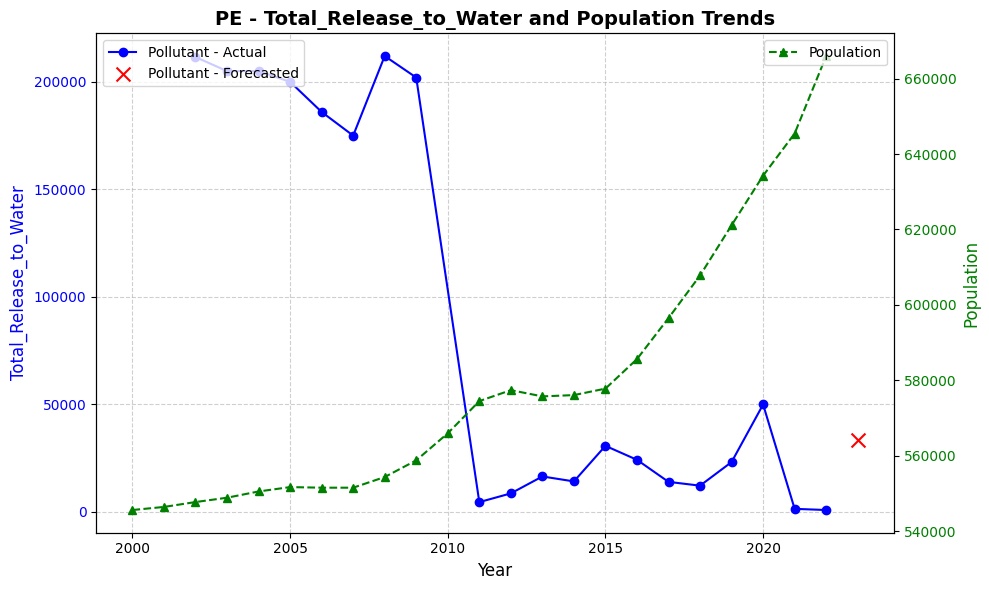

In [ ]:
# Assuming you have a DataFrame named 'df_population' with population data
plot_actual_vs_forecasted_with_population(data_NPRI_ammonia_2, future_forecasts_ammonia, 'Total_Release_to_Water', df_population)

## Population and Phosphorus Trends

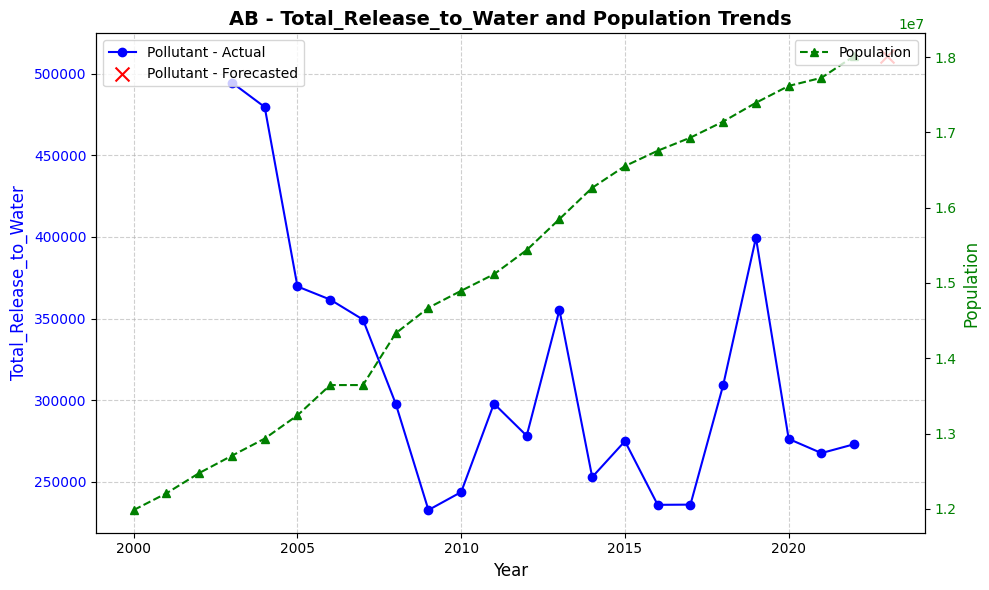

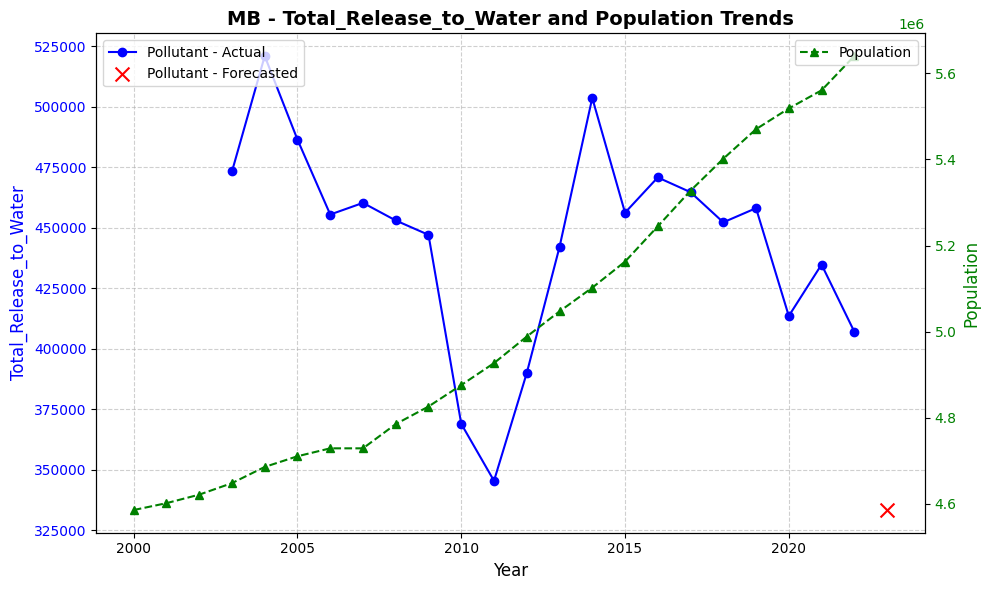

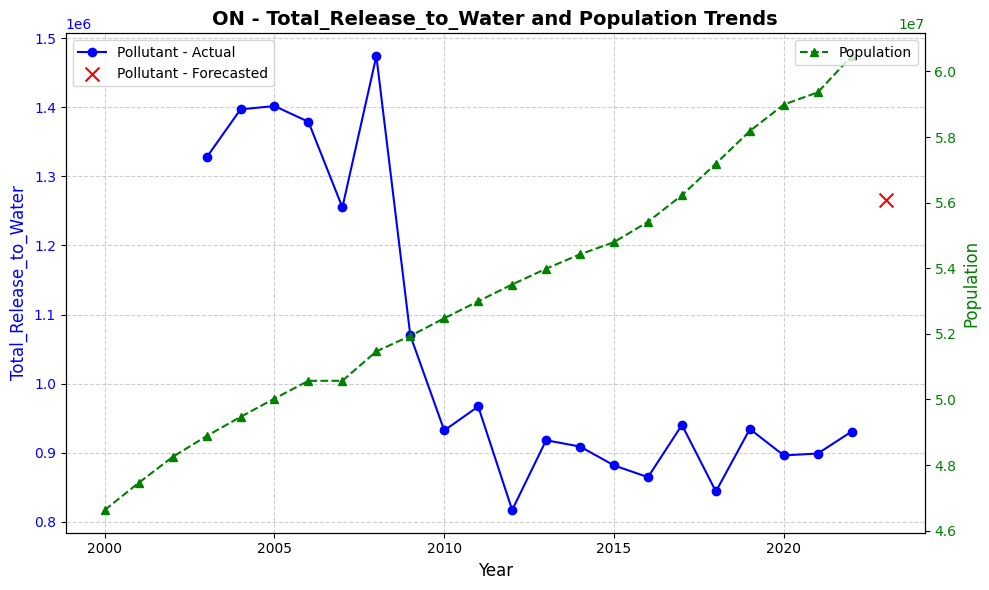

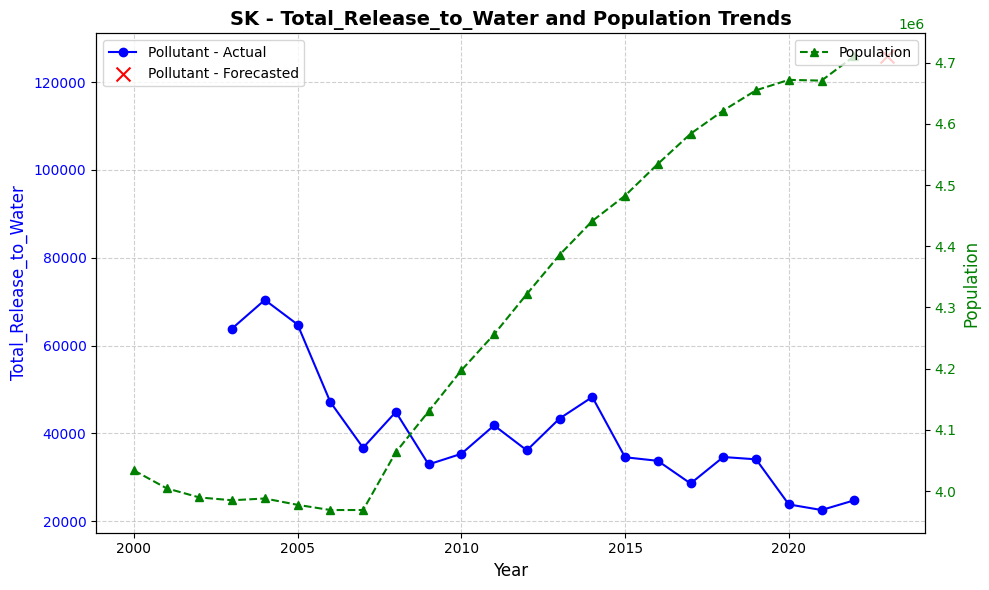

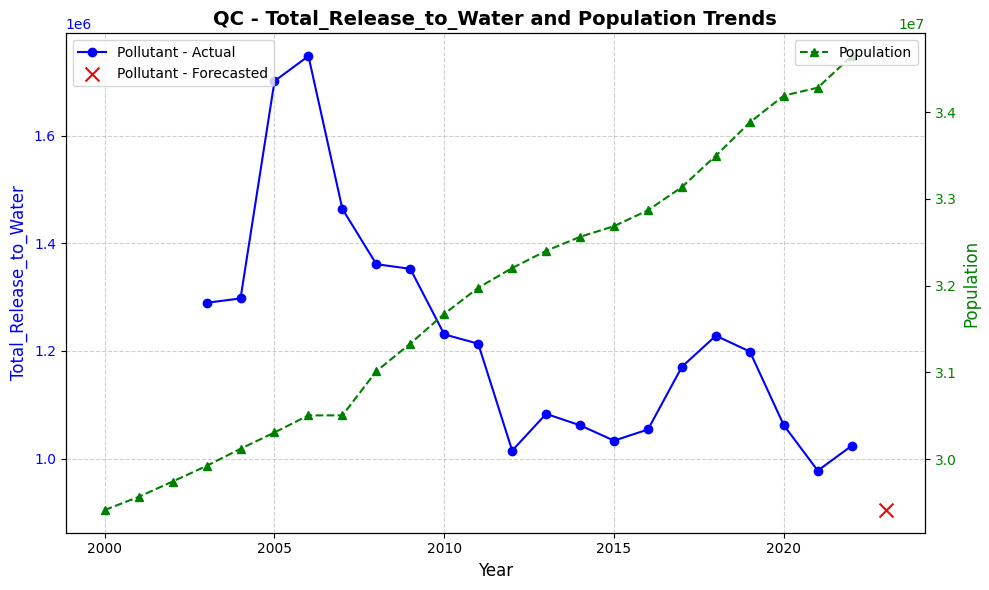

...

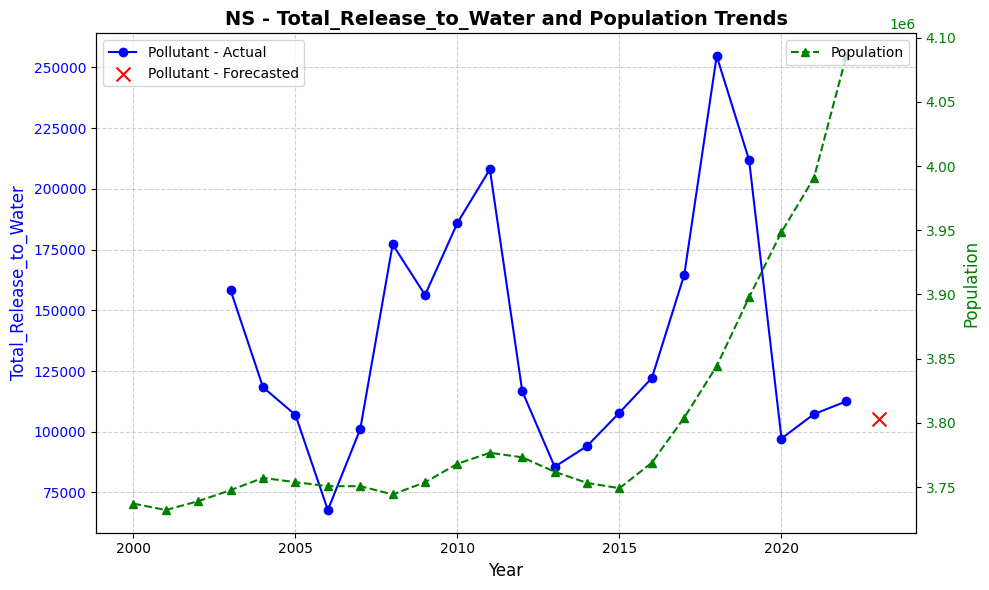

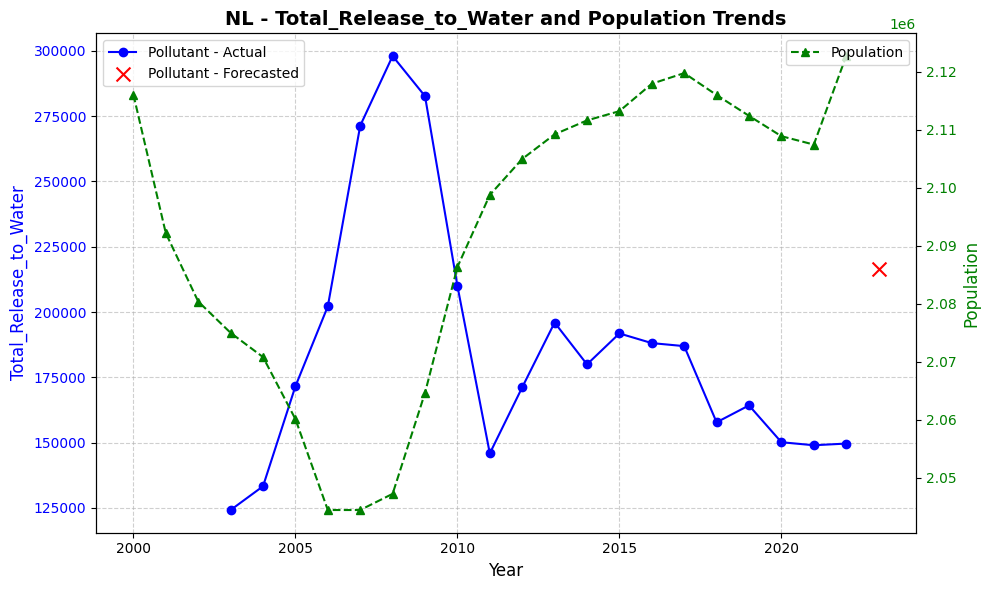

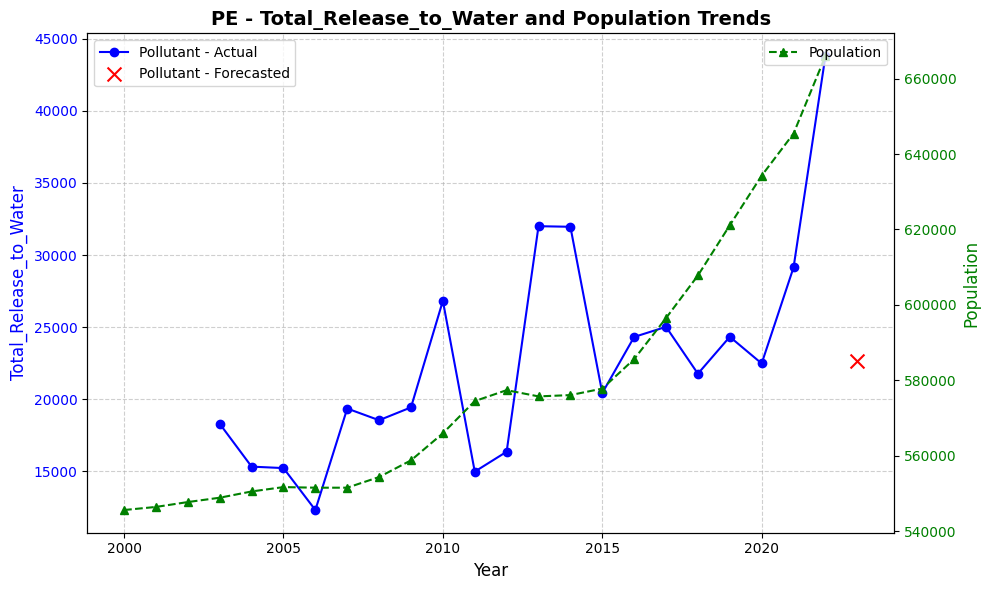

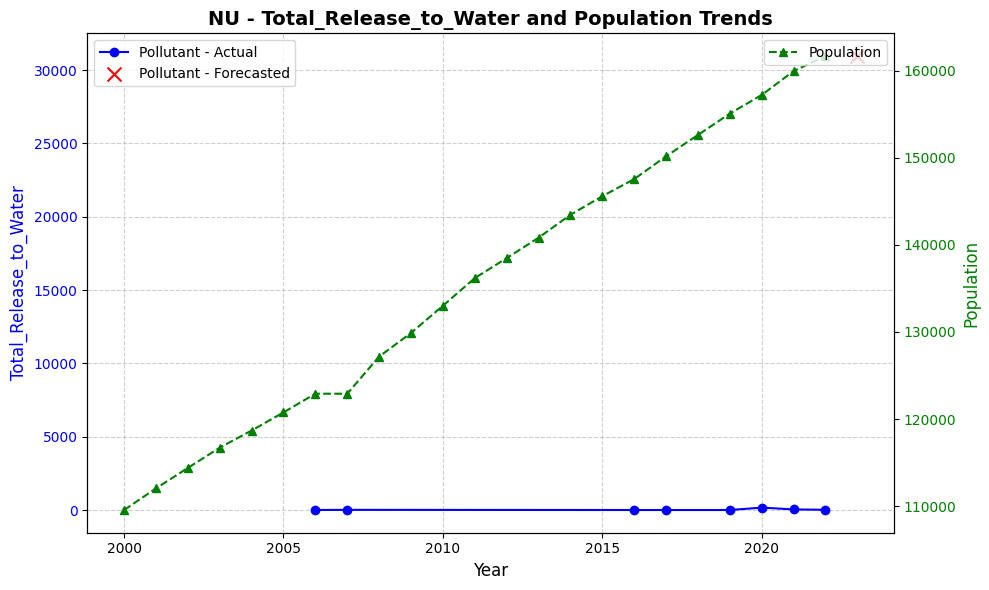

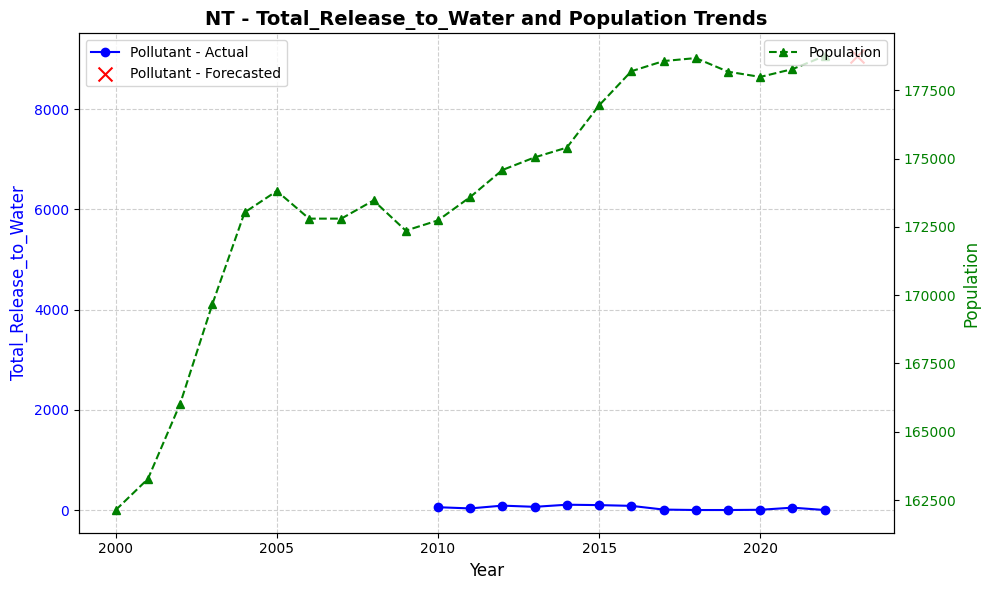

In [ ]:
# Assuming you have a DataFrame named 'df_population' with population data
plot_actual_vs_forecasted_with_population(data_NPRI_phosphorus_2, future_forecasts_phosphorus, 'Total_Release_to_Water', df_population)

## Population and Nitrate Trends

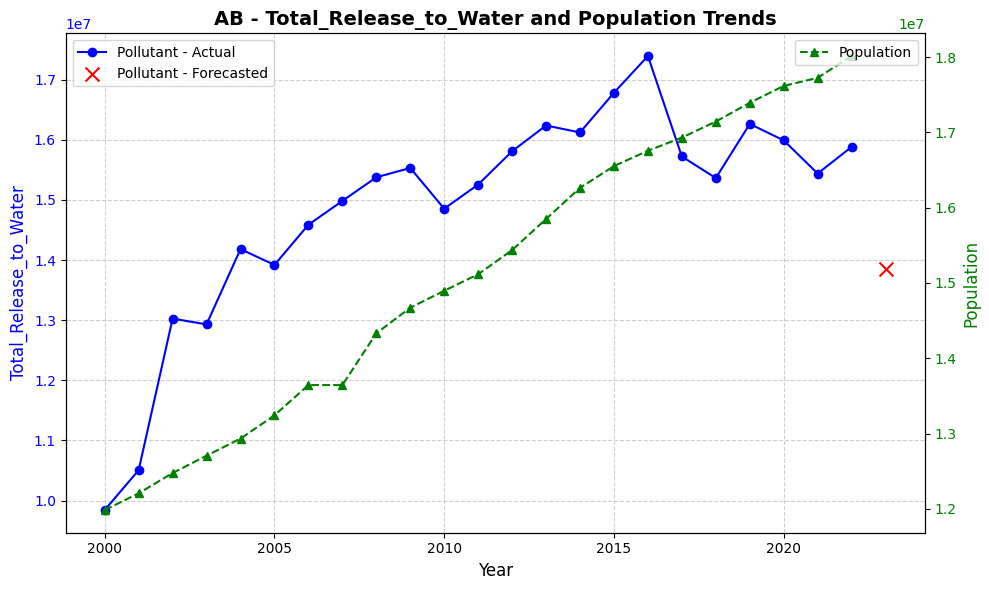

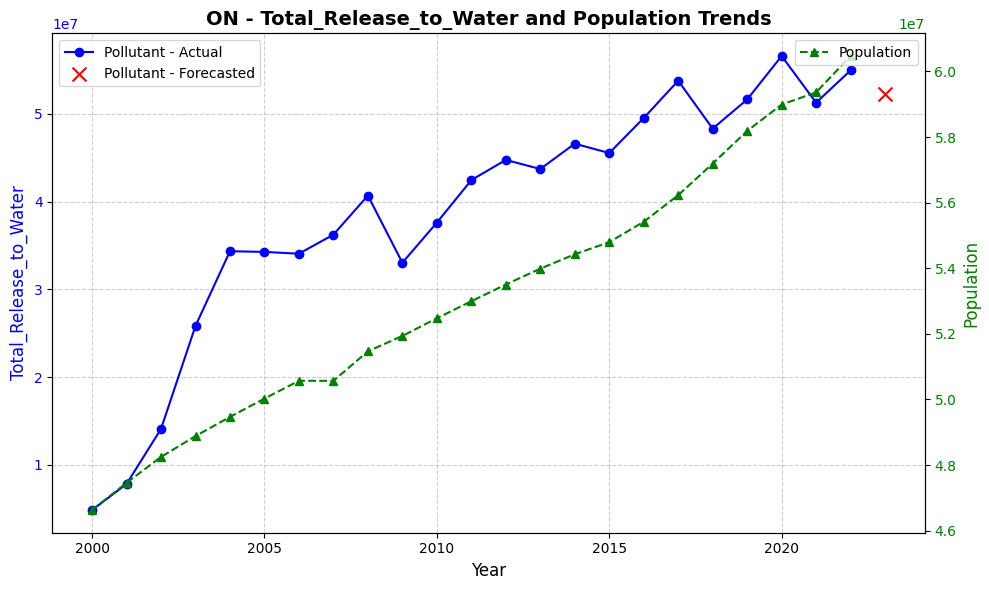

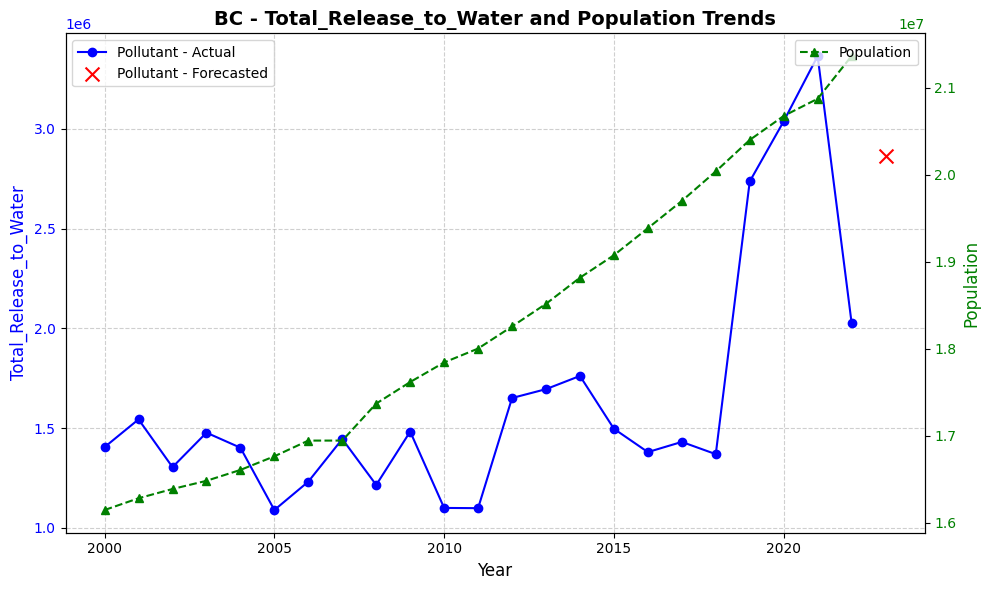

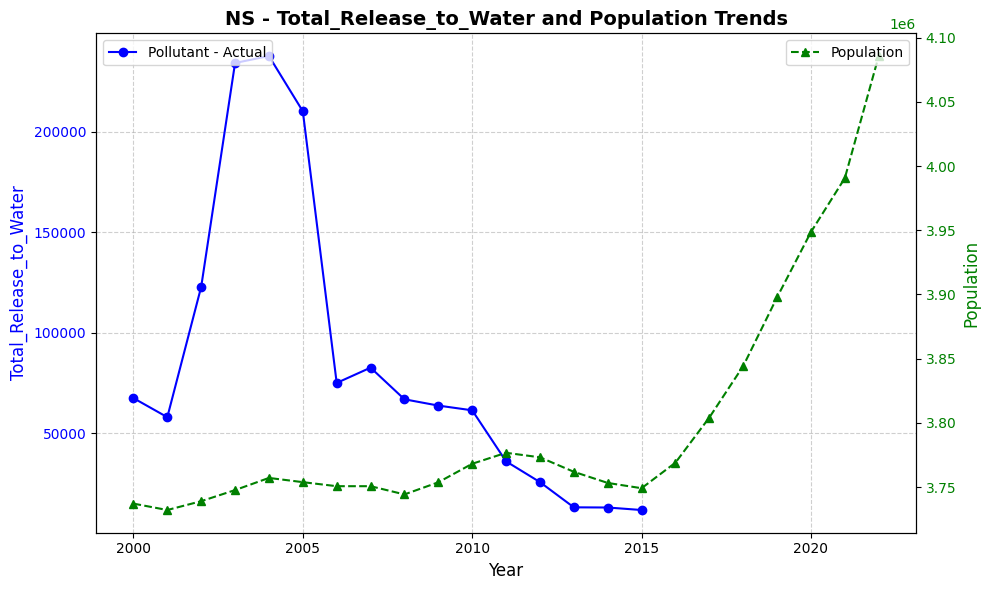

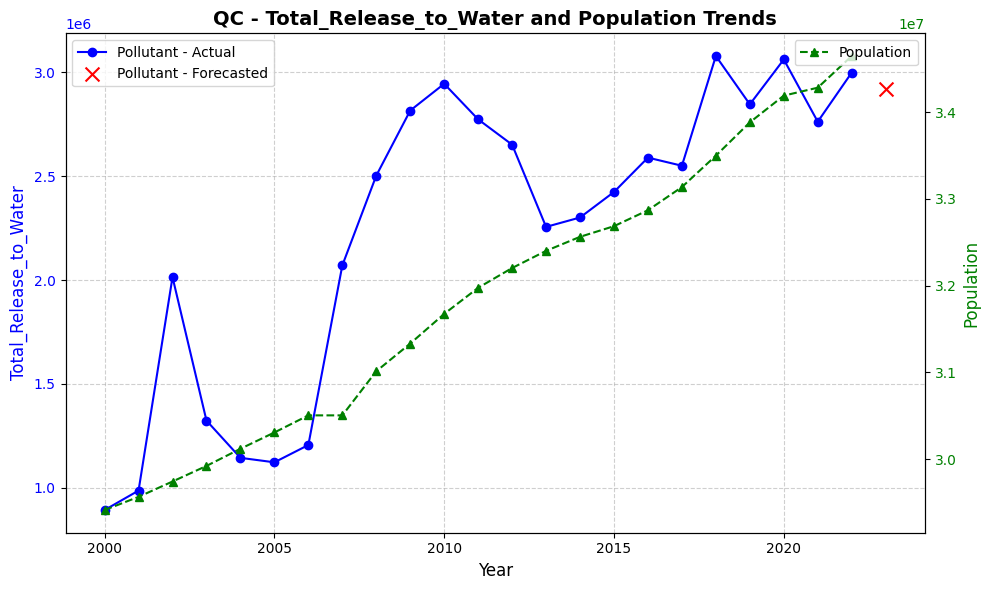

...

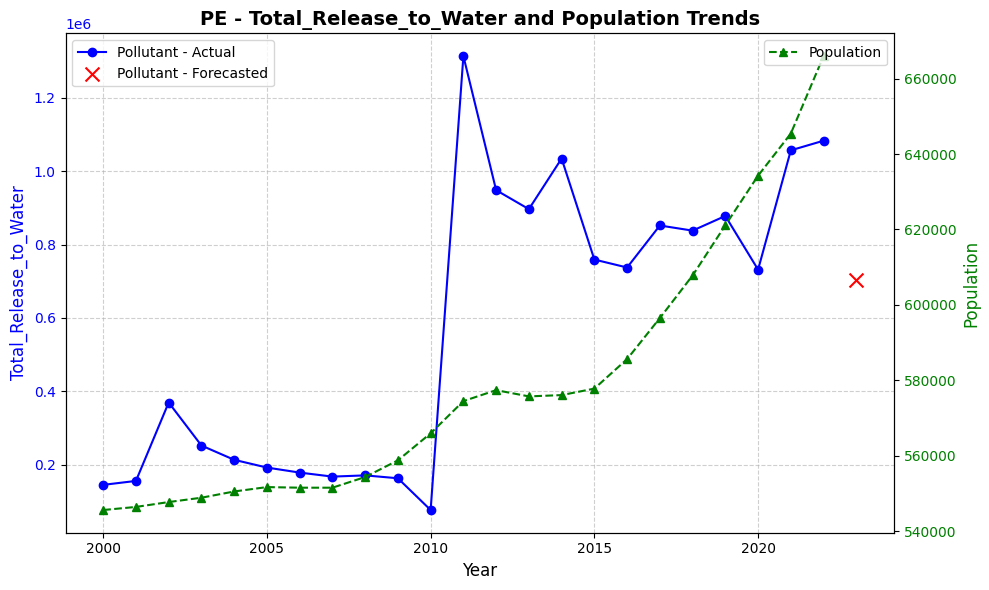

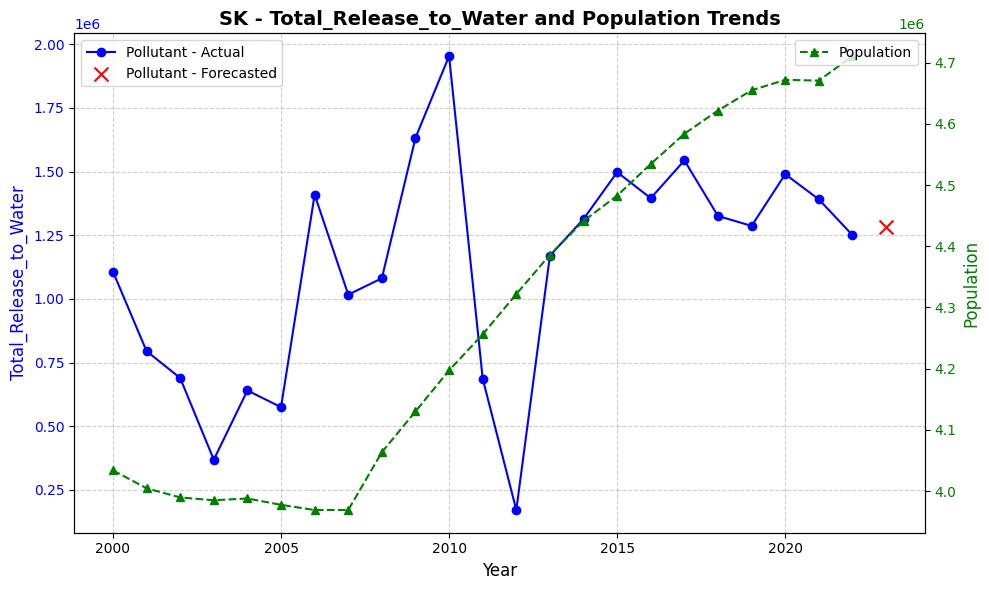

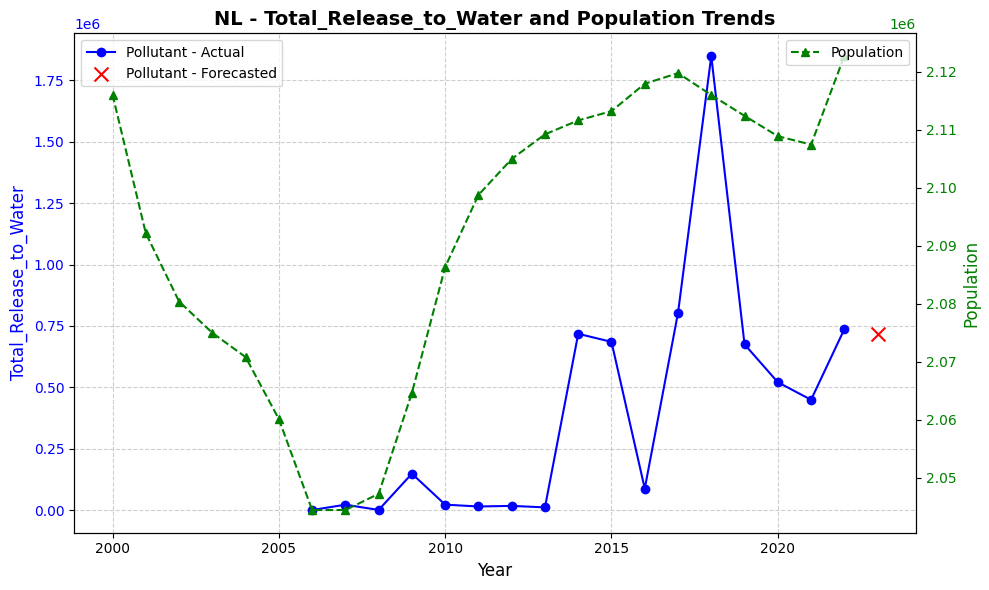

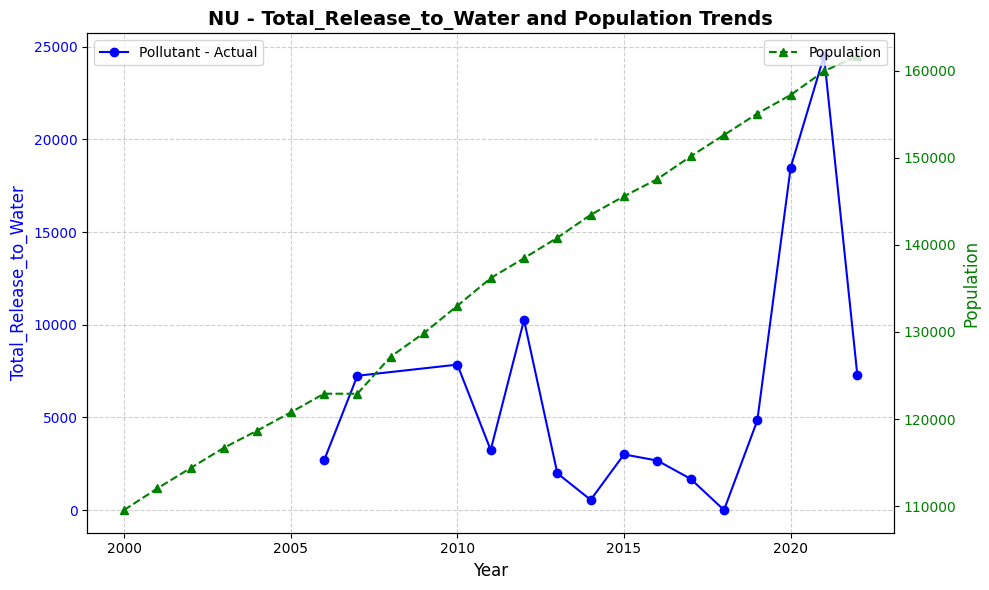

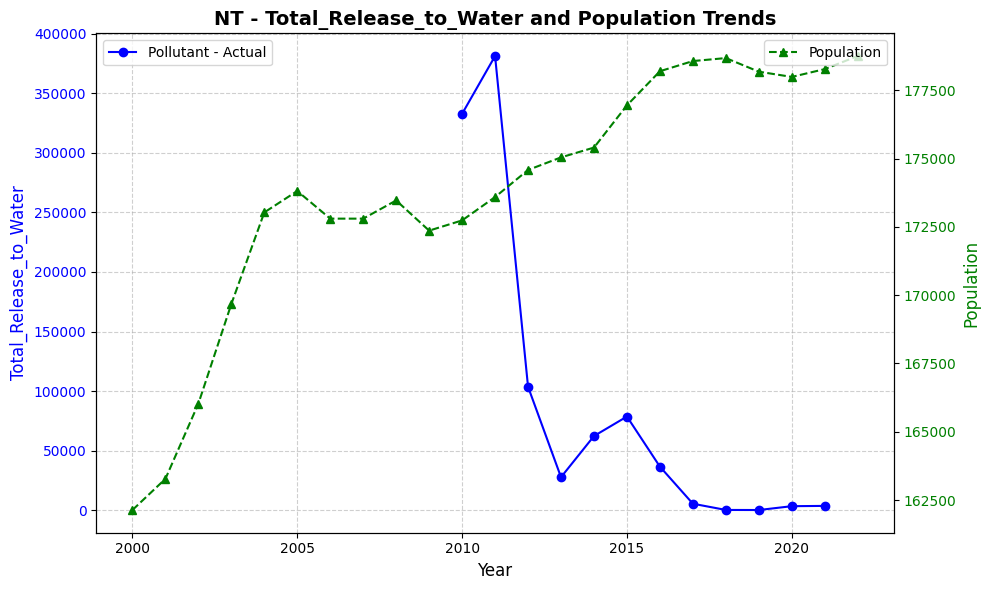

In [ ]:
# Assuming you have a DataFrame named 'df_population' with population data
plot_actual_vs_forecasted_with_population(data_NPRI_nitrate_2, future_forecasts_nitrate, 'Total_Release_to_Water', df_population)